Starting image enhancement processing for all 10 images...

Processing: Atelectasis.png


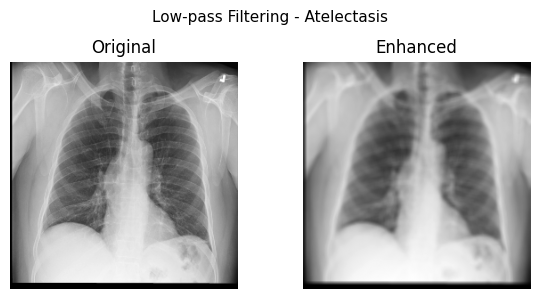

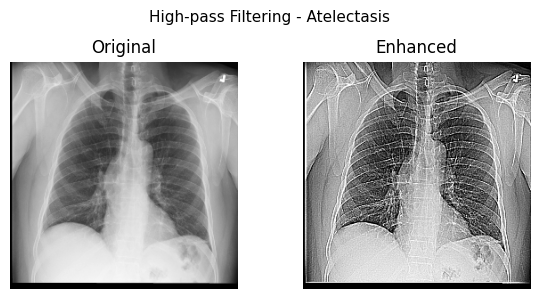

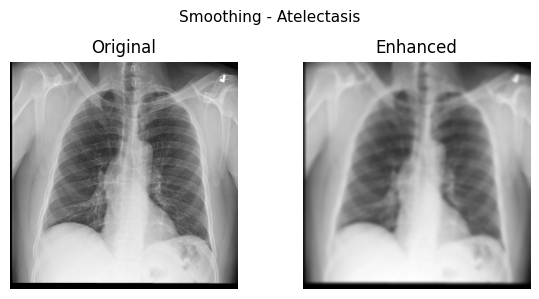

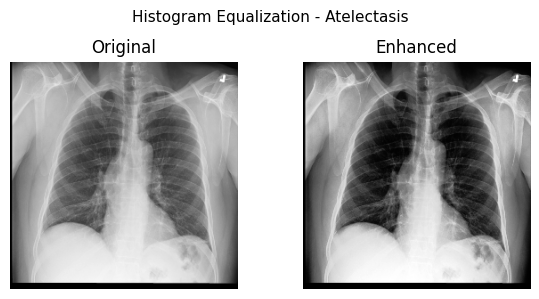

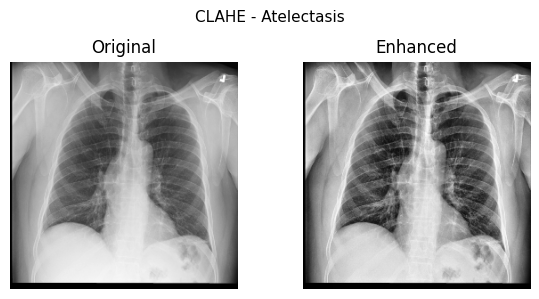

...

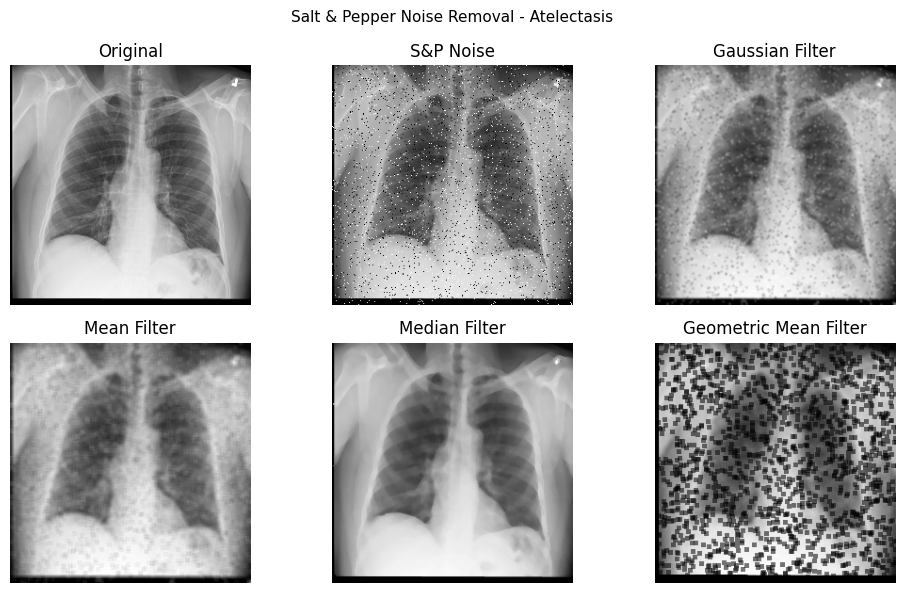

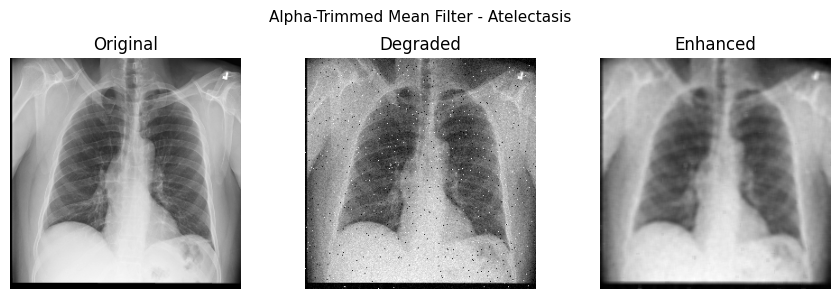

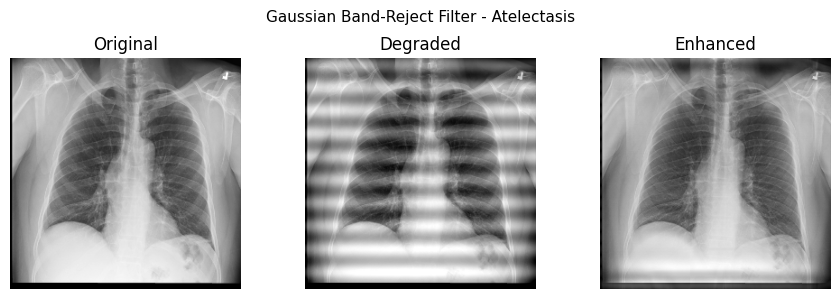

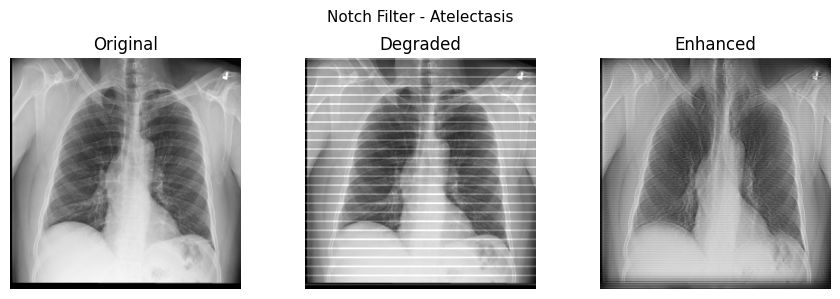

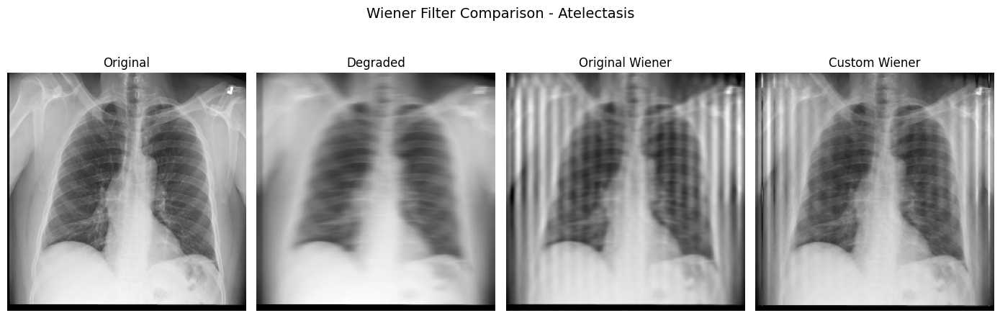

✅ Completed: Atelectasis.png

Processing: Cardiomegaly.png


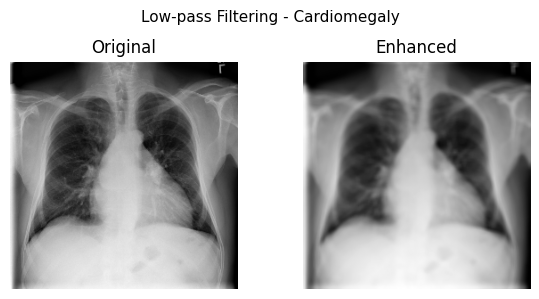

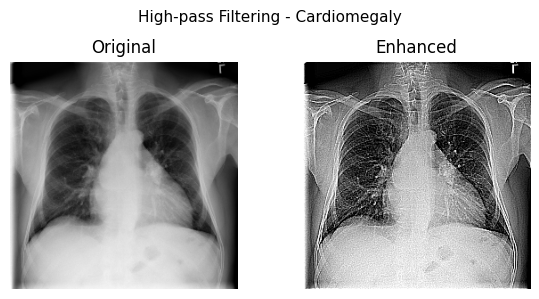

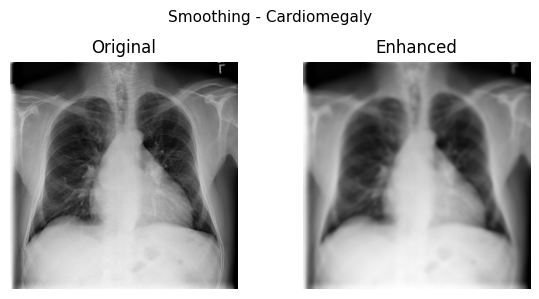

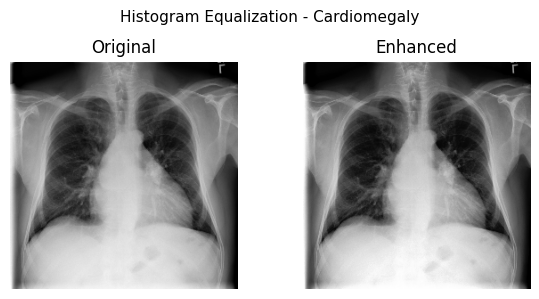

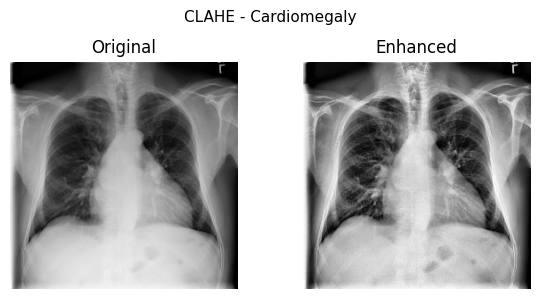

...

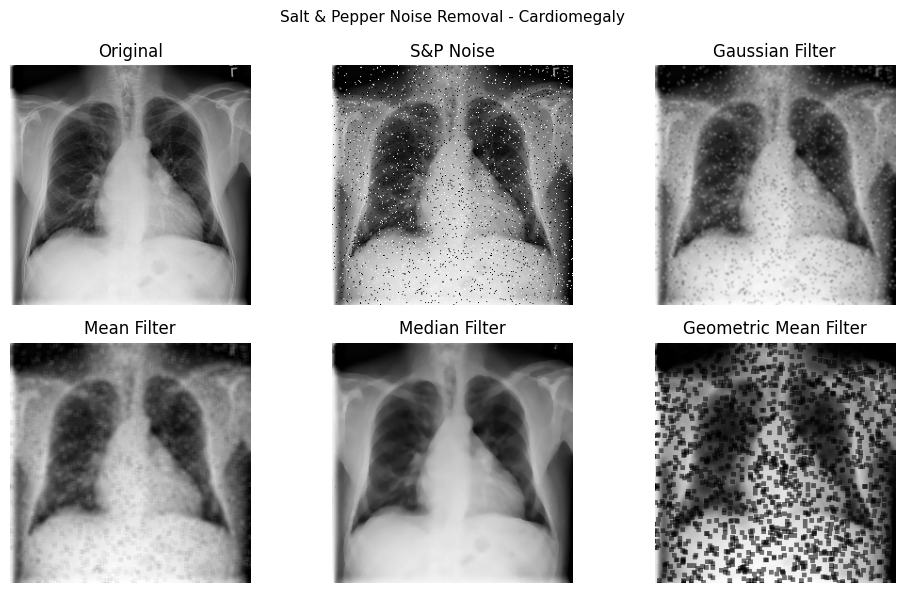

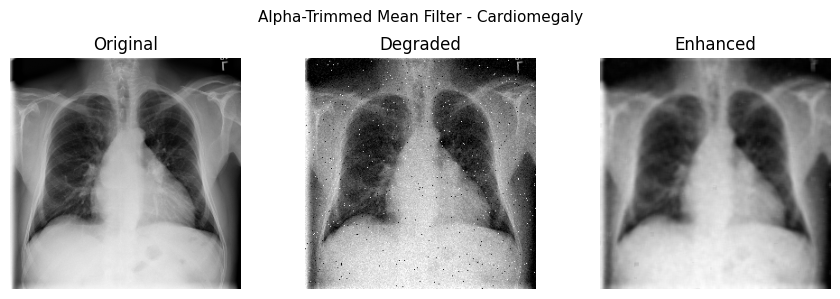

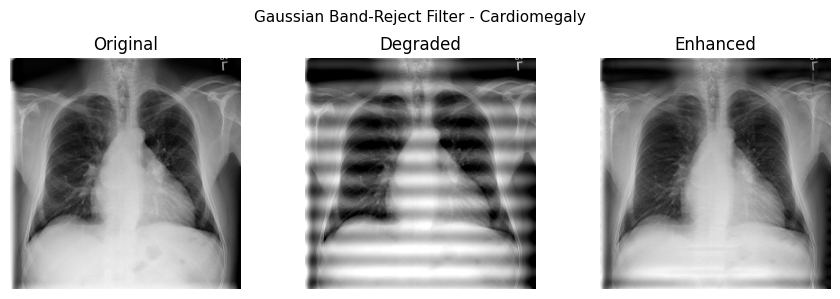

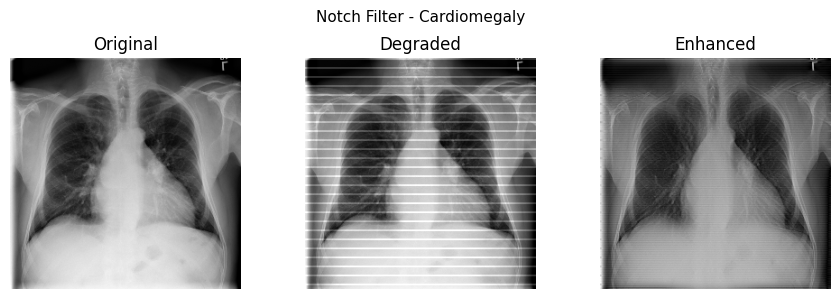

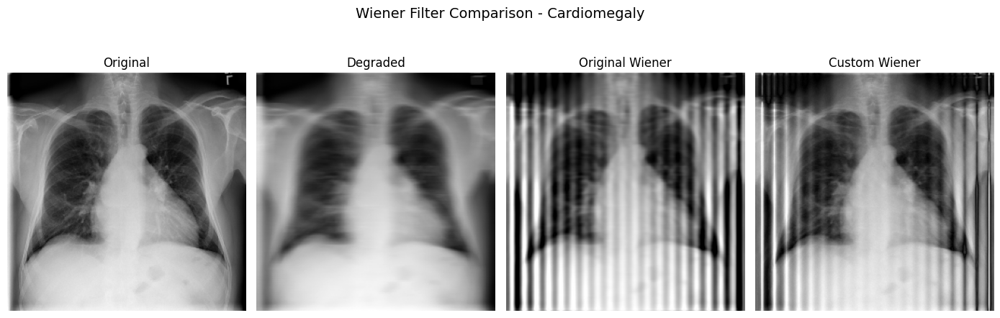

✅ Completed: Cardiomegaly.png

Processing: Consolidation.png


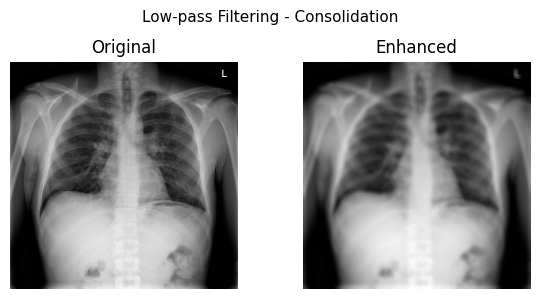

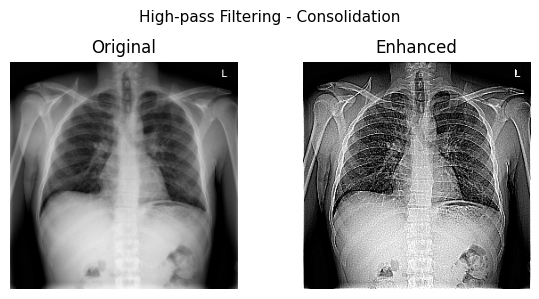

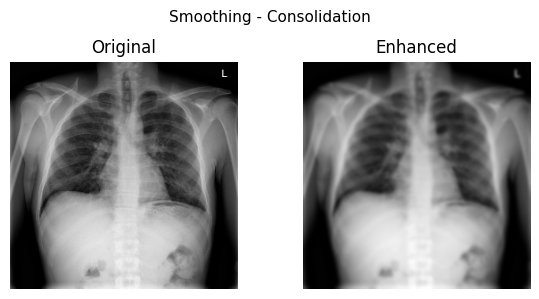

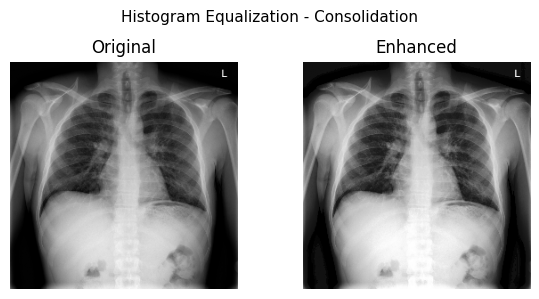

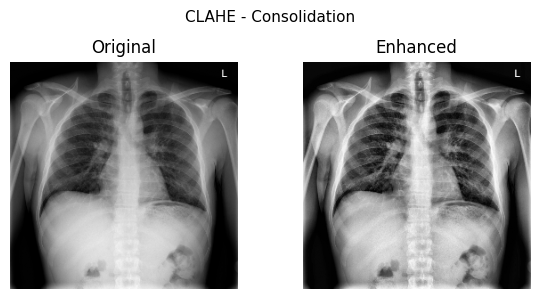

...

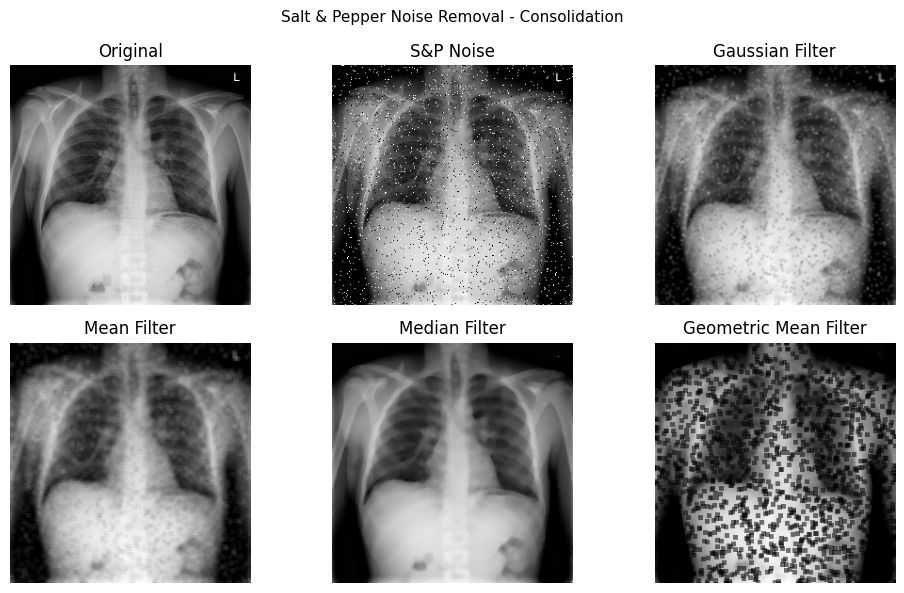

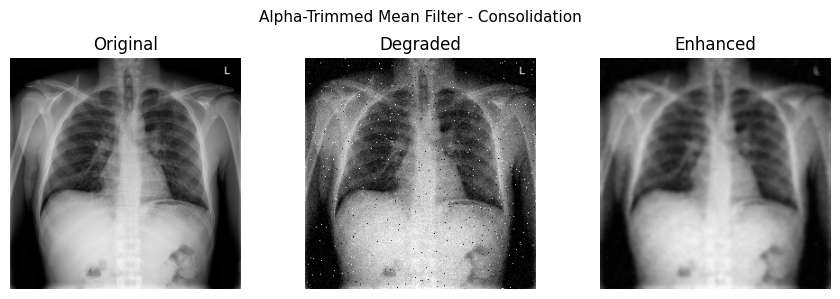

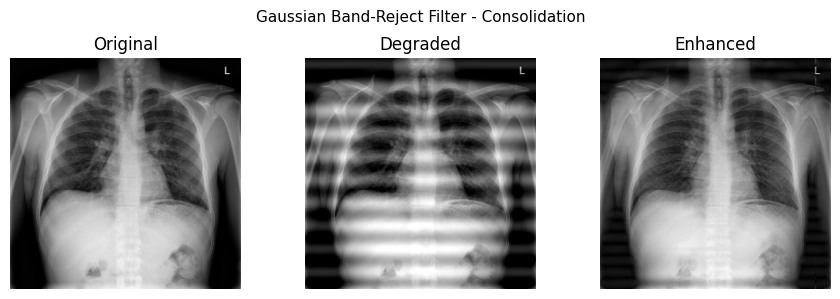

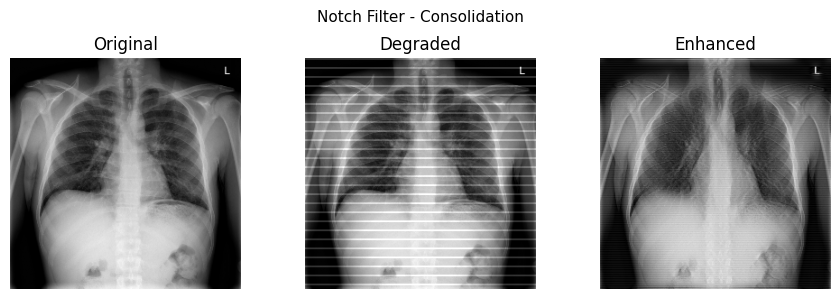

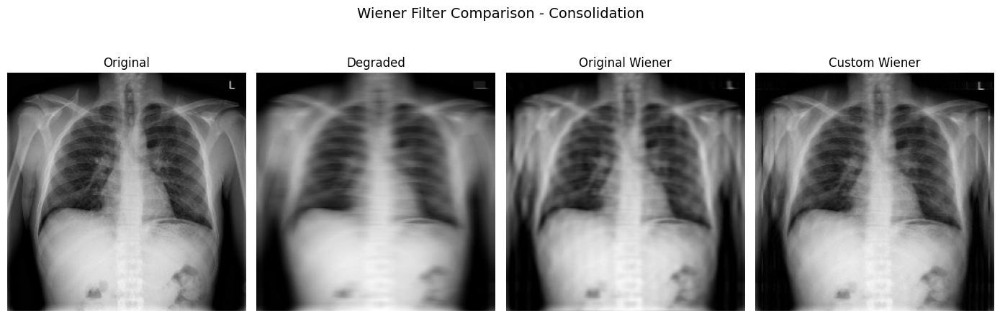

✅ Completed: Consolidation.png

Processing: Edema.png


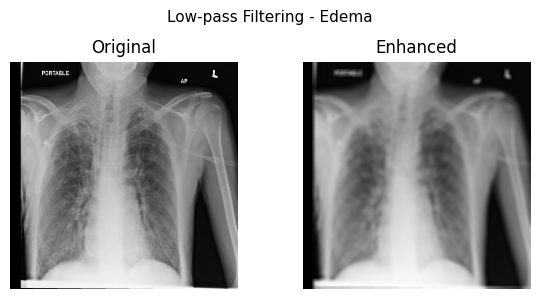

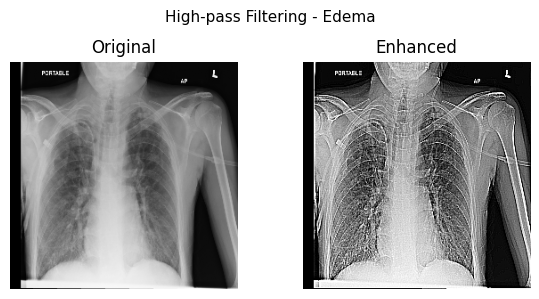

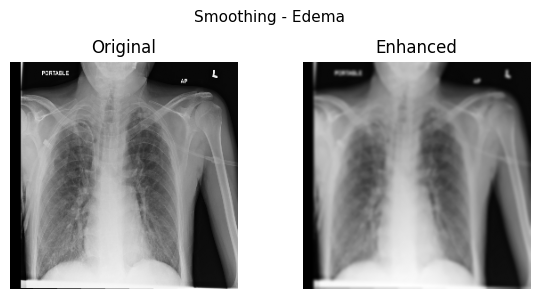

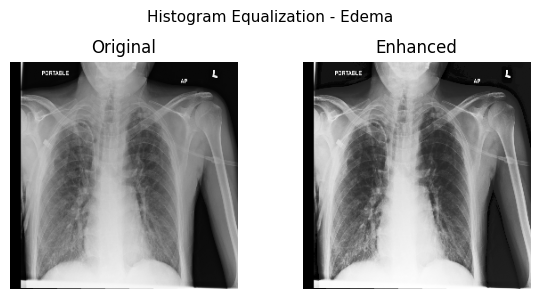

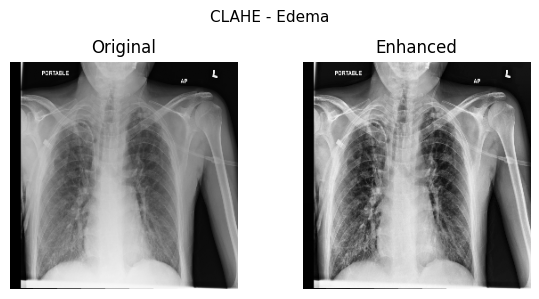

...

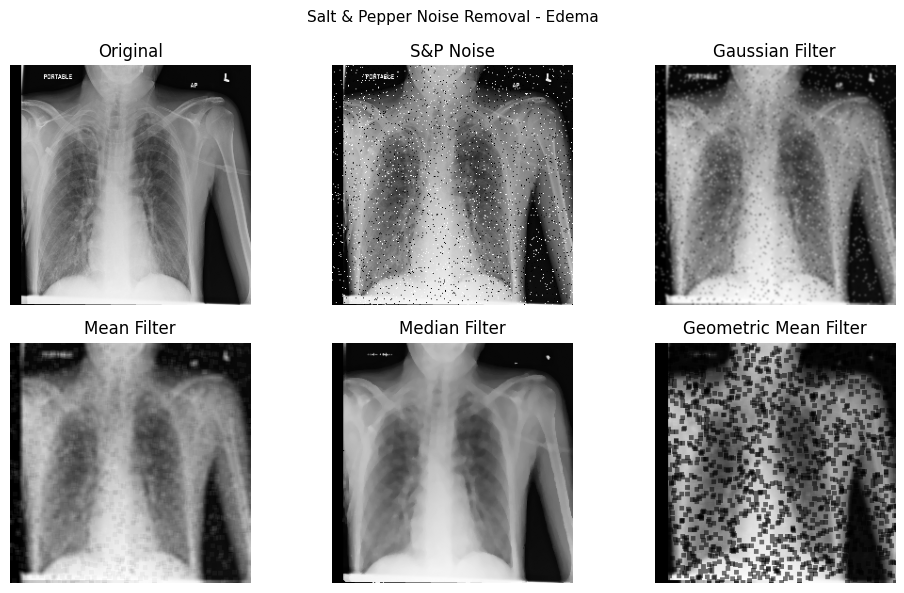

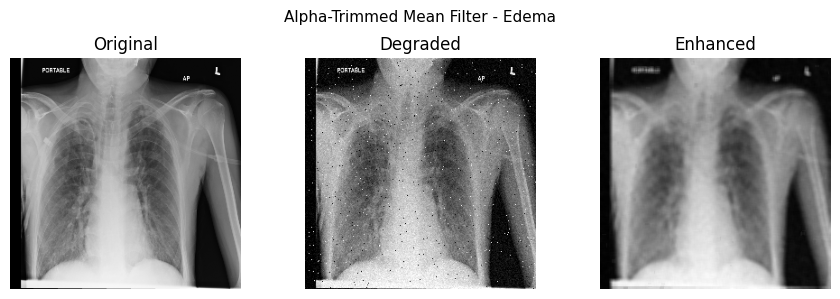

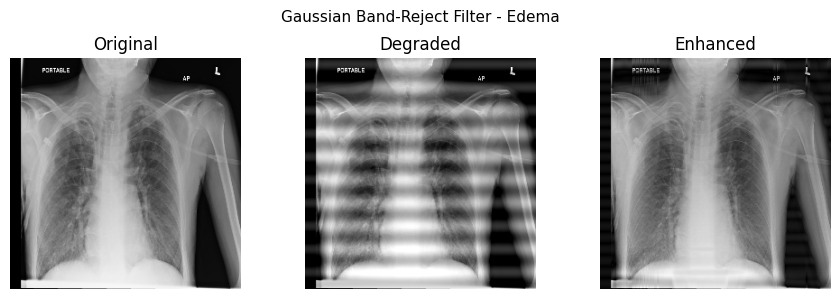

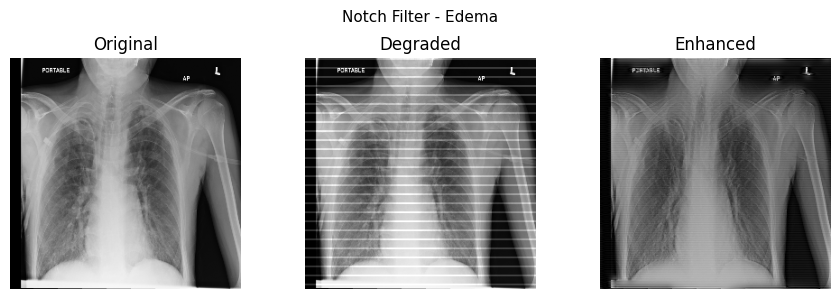

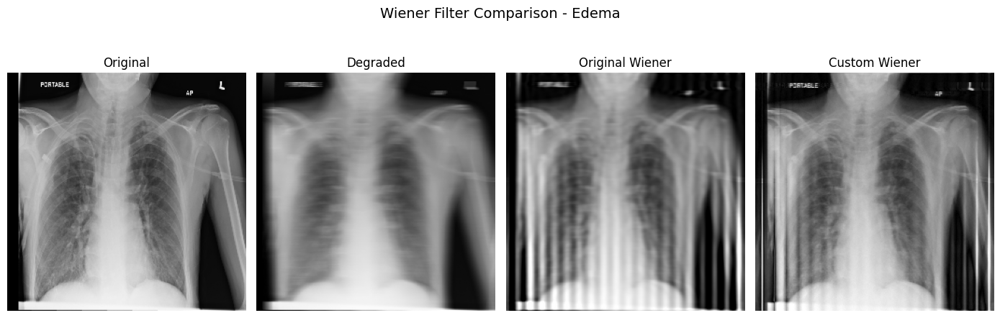

✅ Completed: Edema.png

Processing: Effusion.png


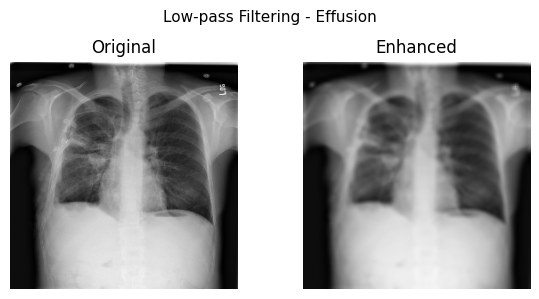

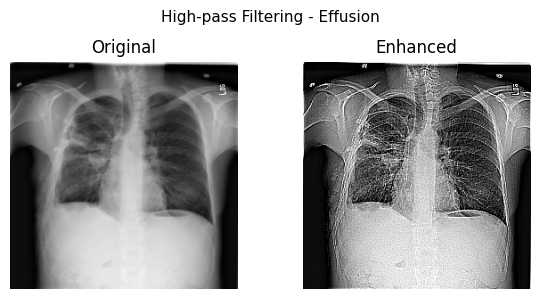

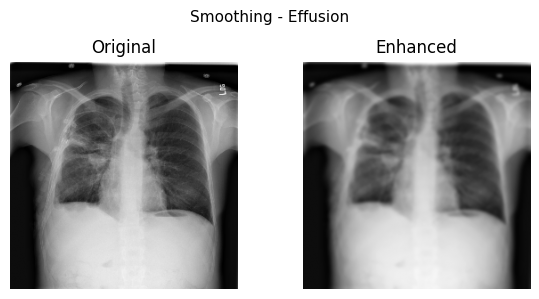

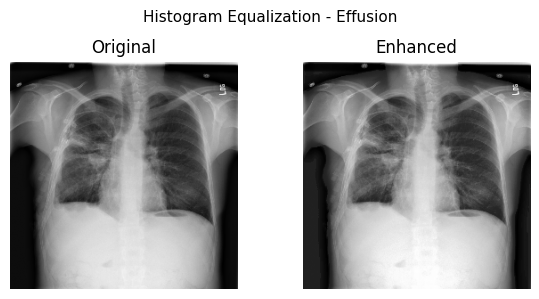

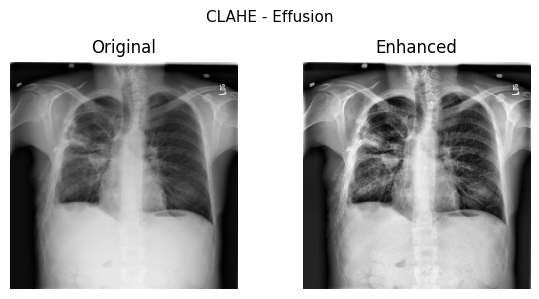

...

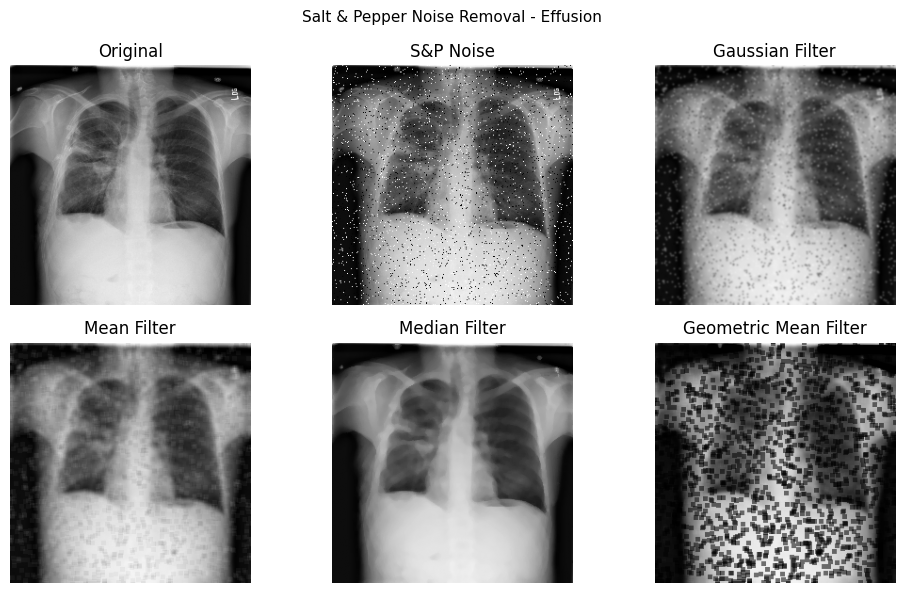

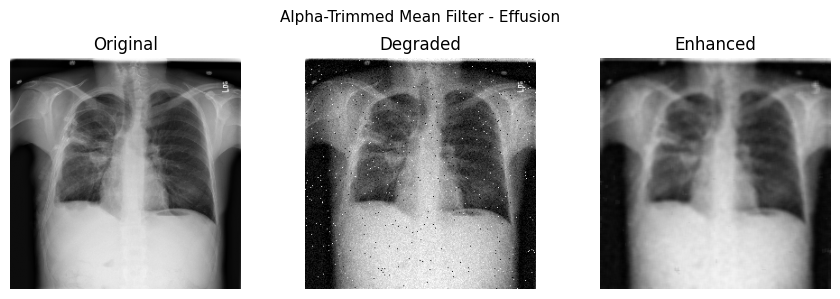

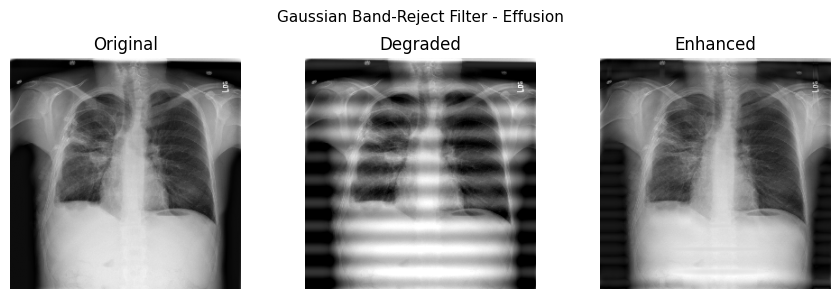

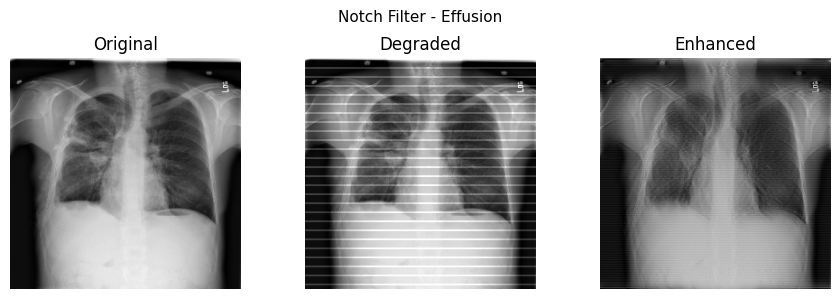

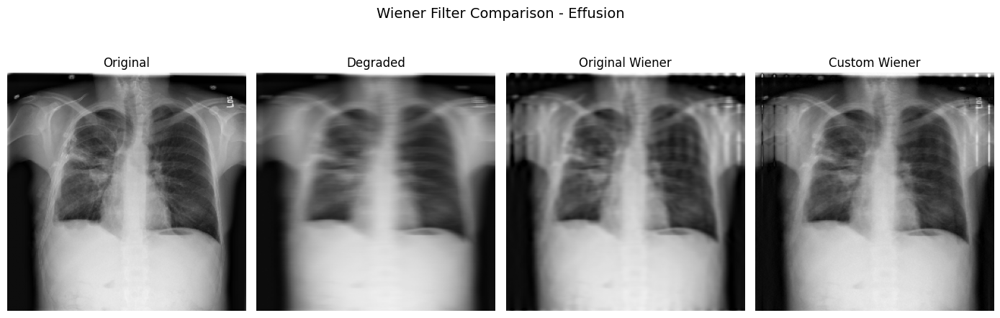

✅ Completed: Effusion.png

Processing: Emphysema.png


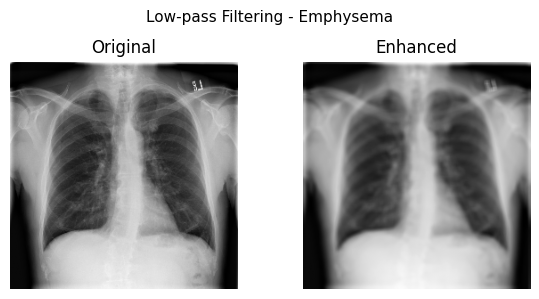

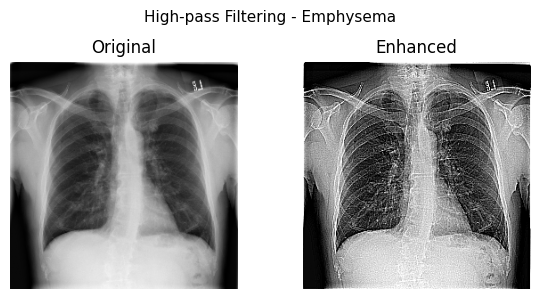

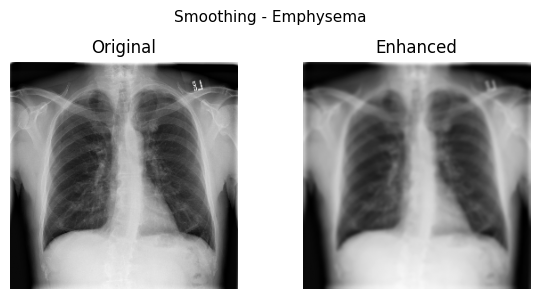

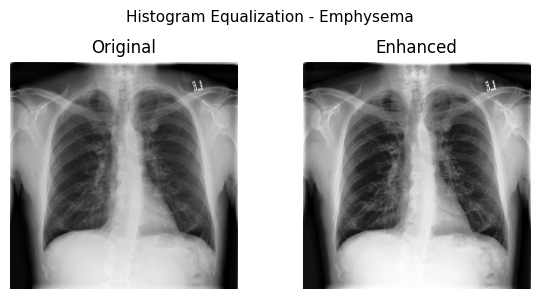

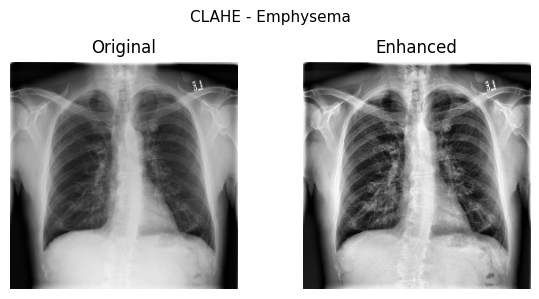

...

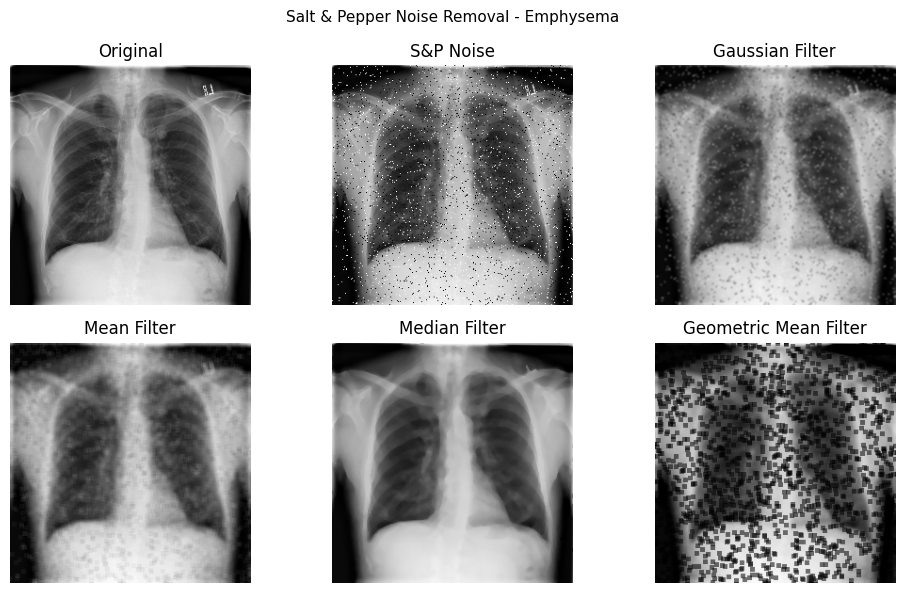

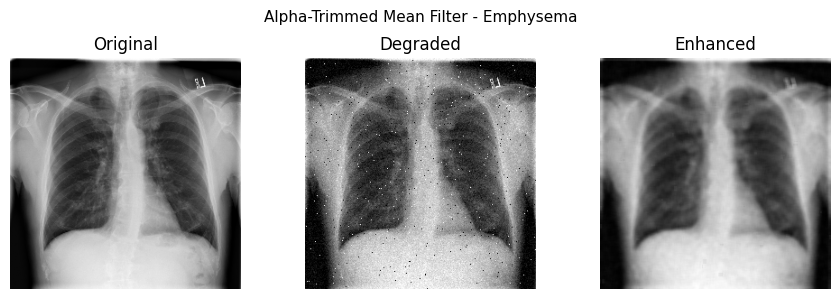

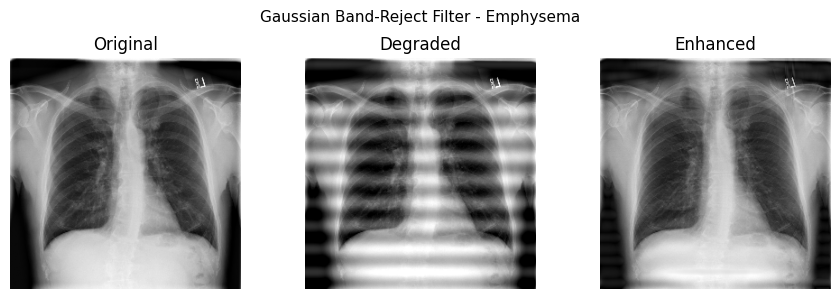

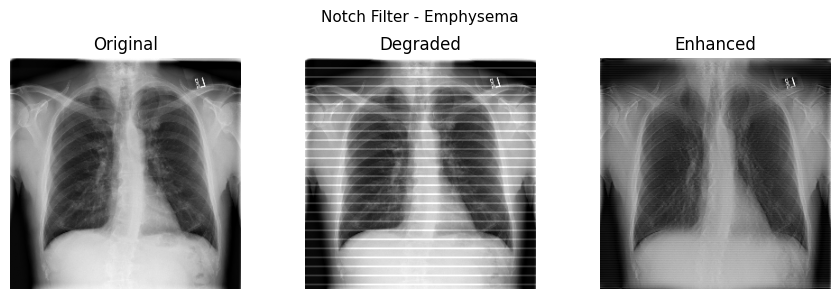

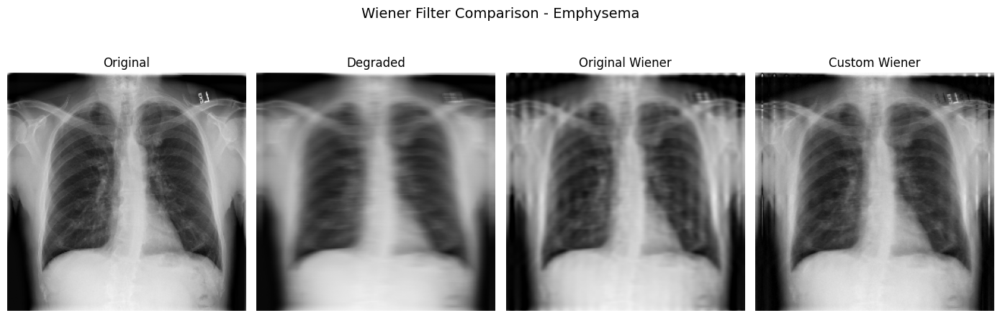

✅ Completed: Emphysema.png

Processing: Fibrosis.png


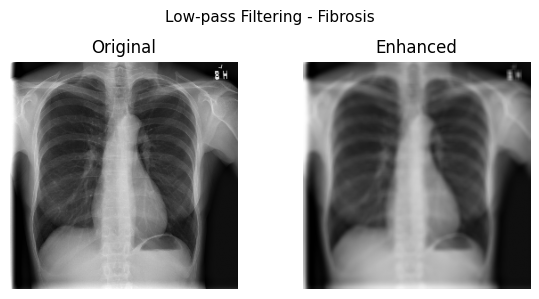

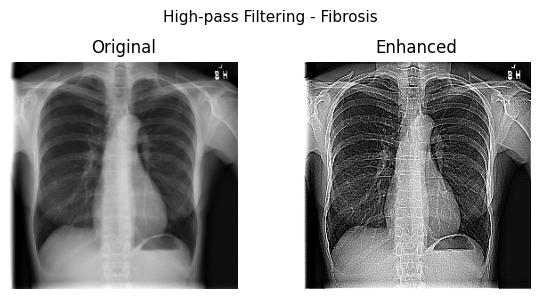

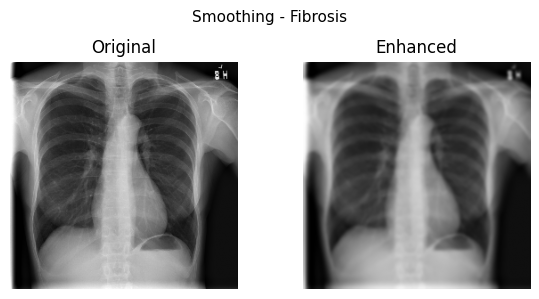

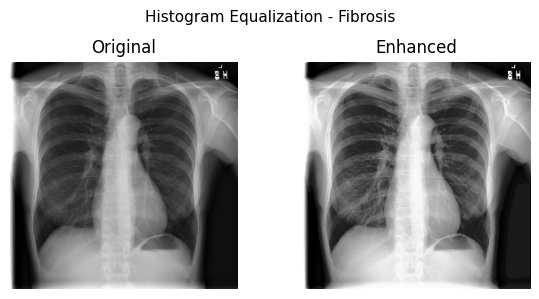

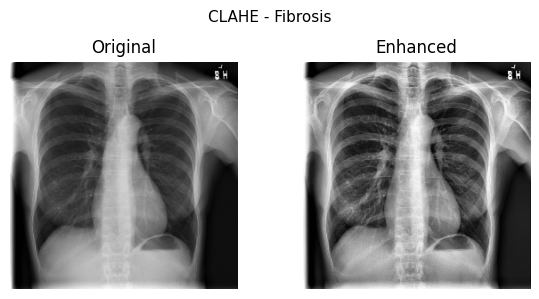

...

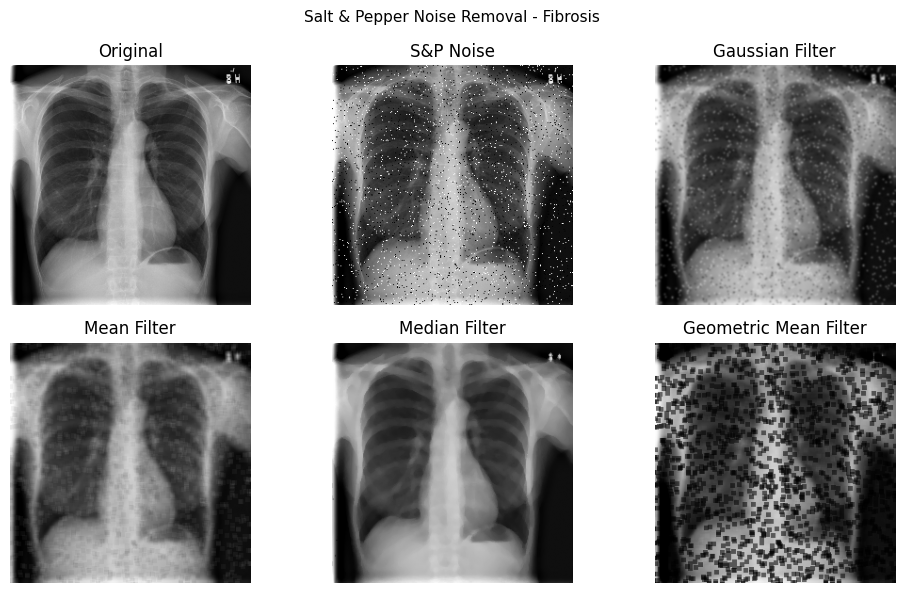

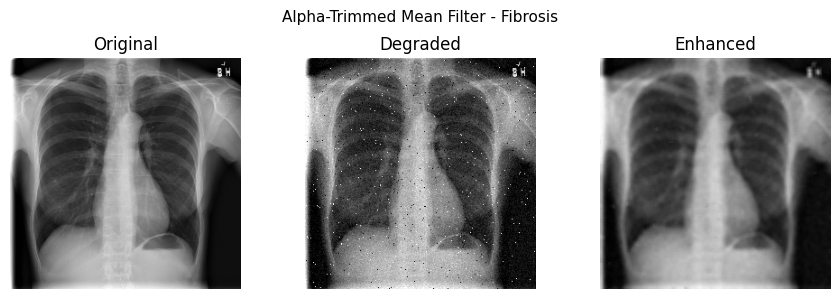

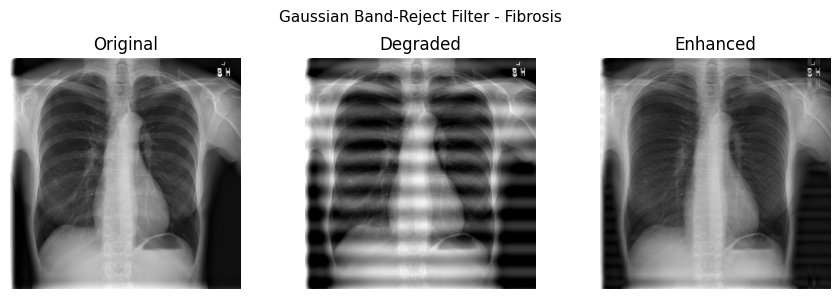

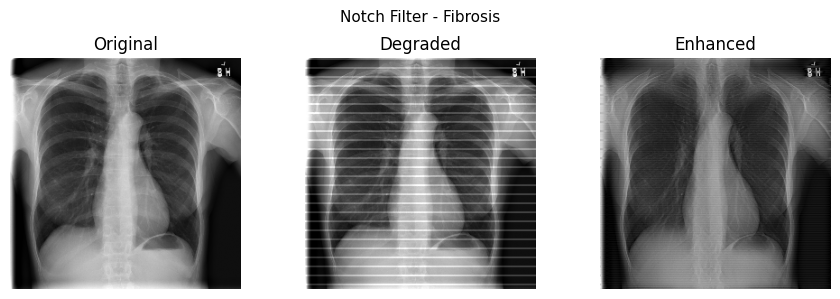

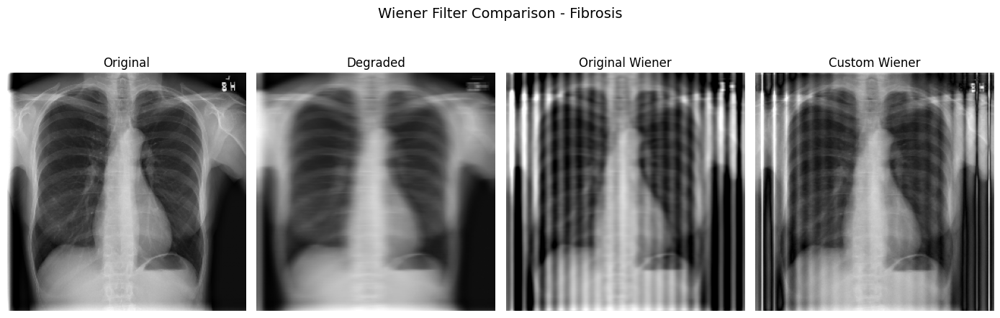

✅ Completed: Fibrosis.png

Processing: No Finding.png


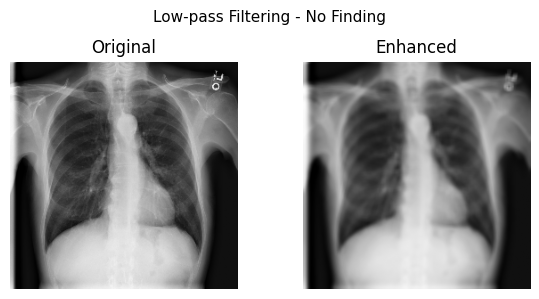

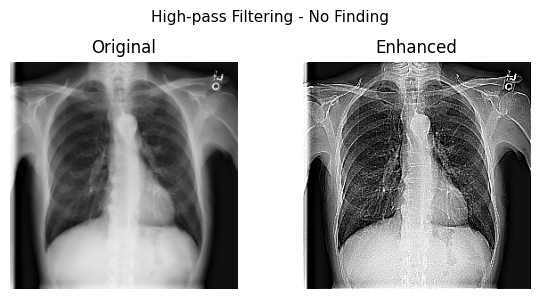

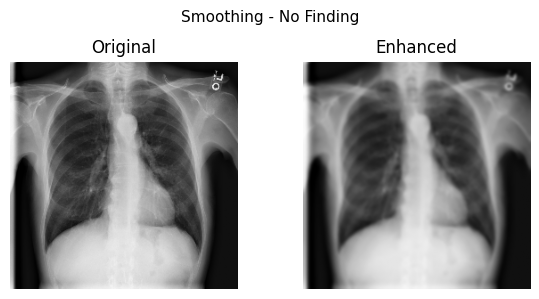

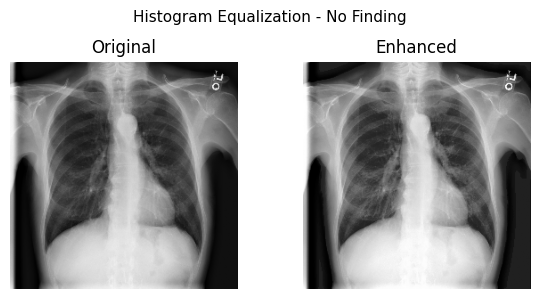

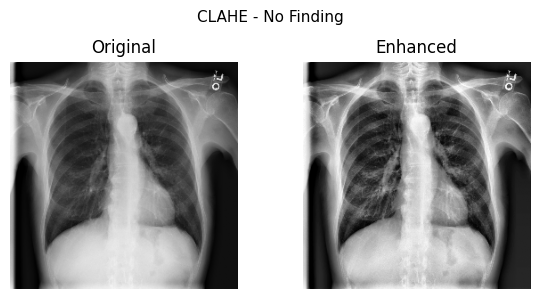

...

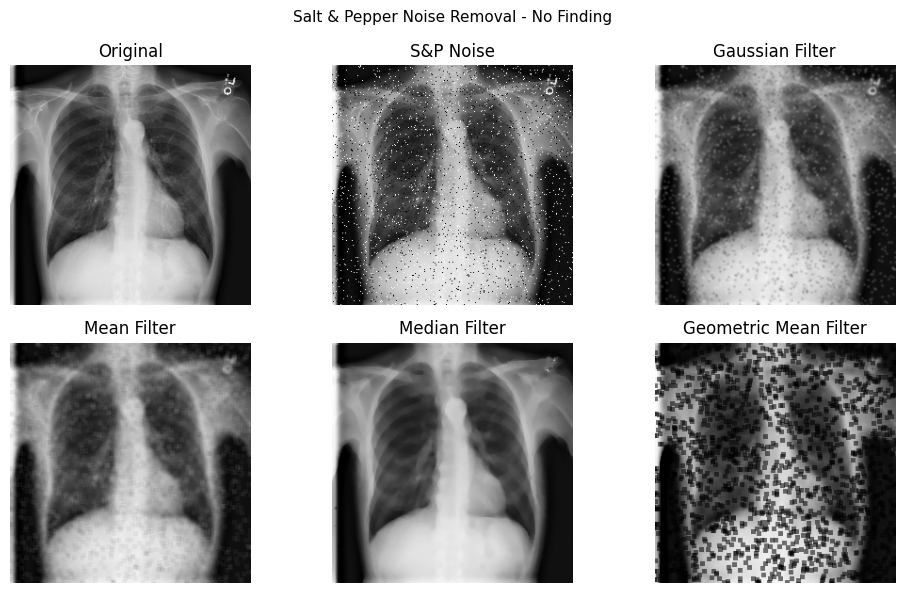

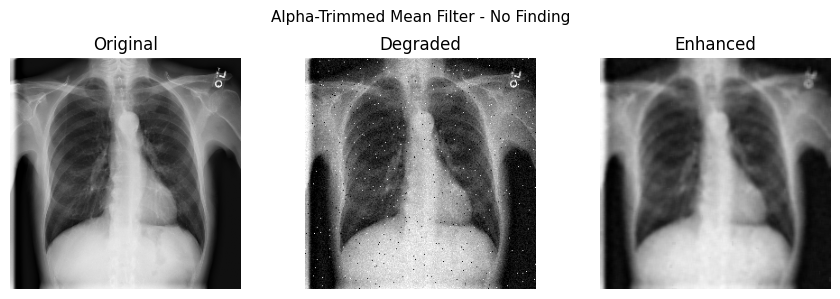

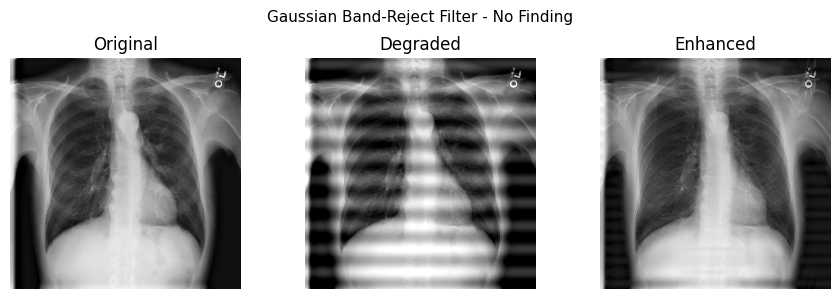

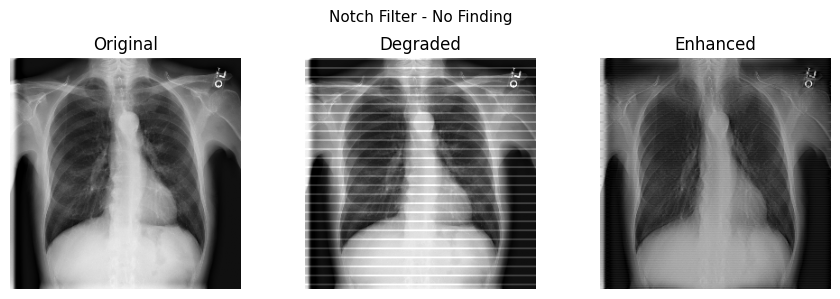

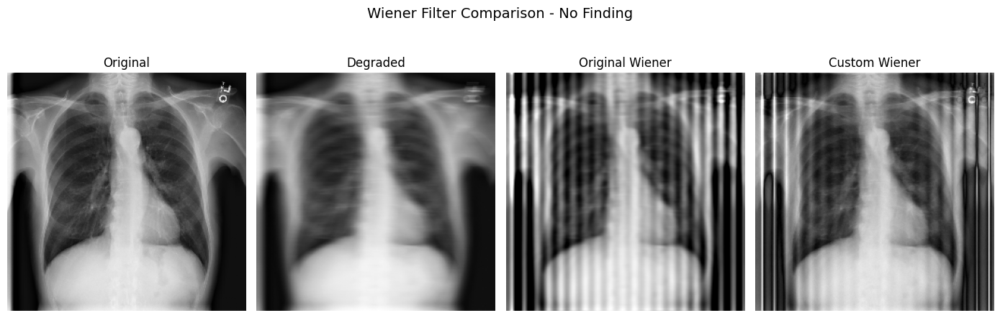

✅ Completed: No Finding.png

Processing: Pneumonia.png


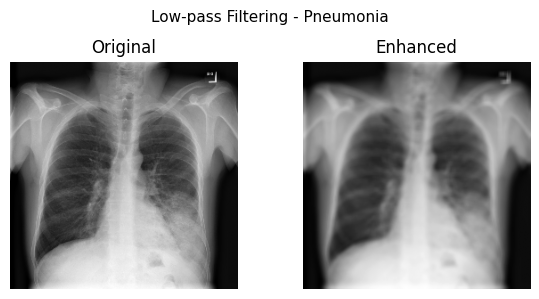

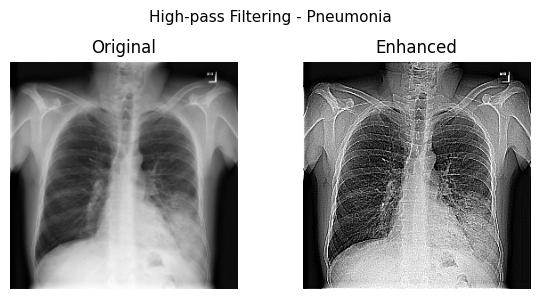

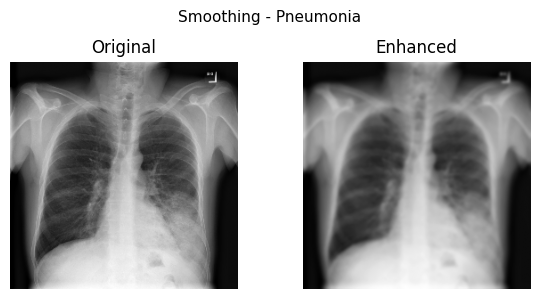

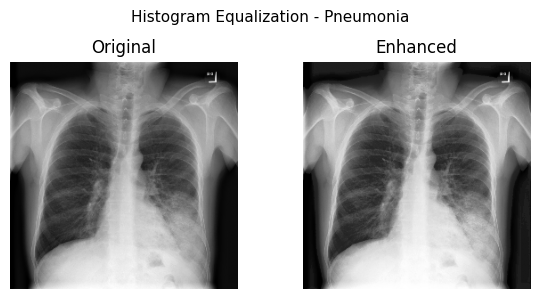

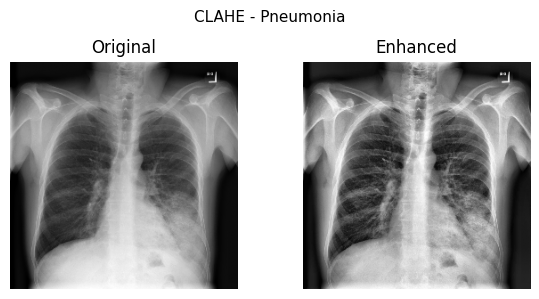

...

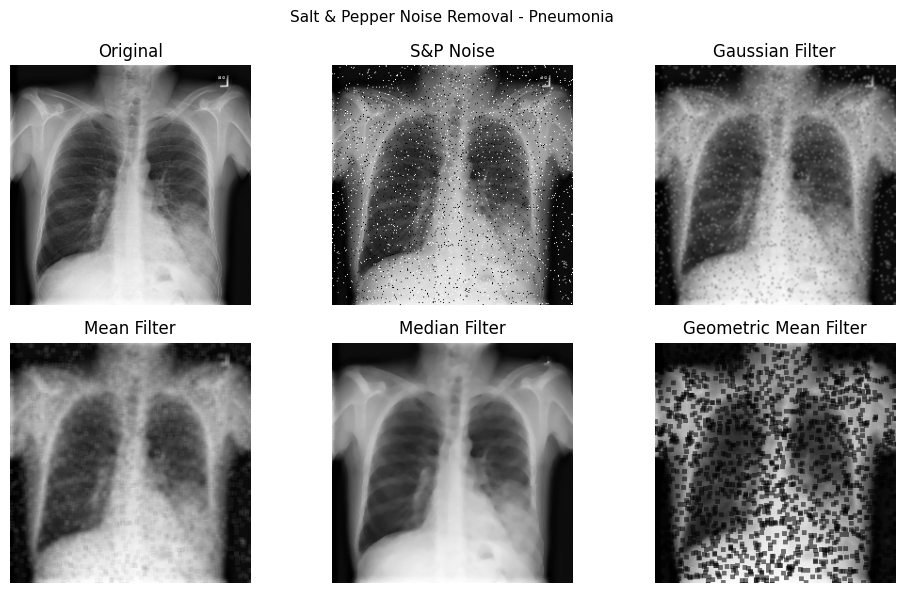

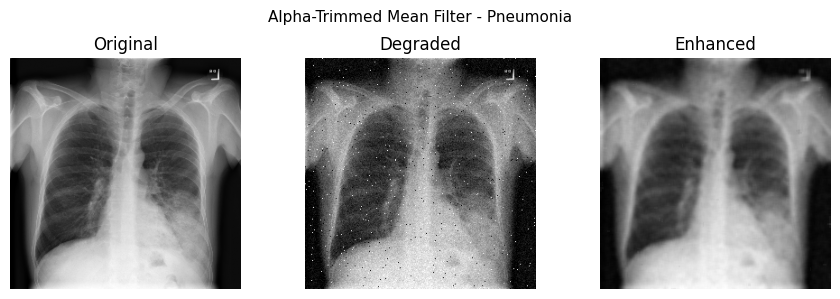

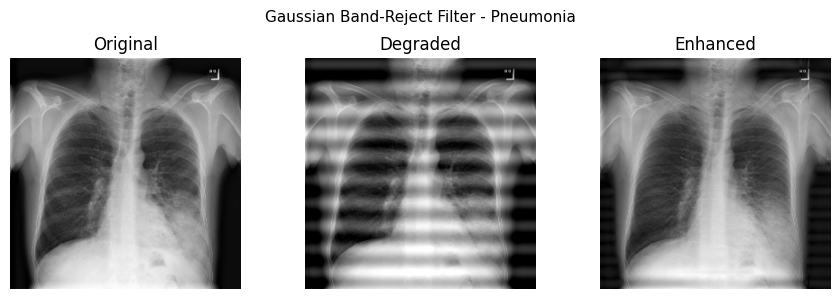

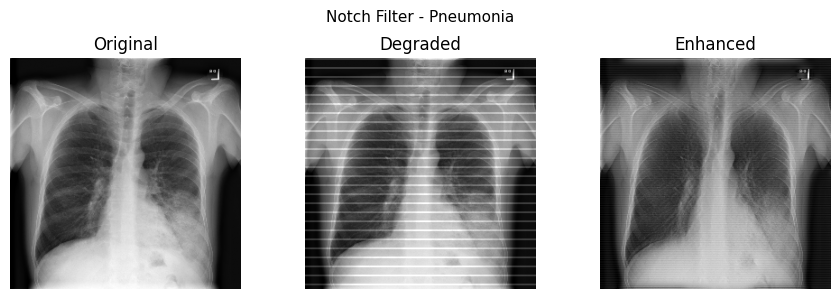

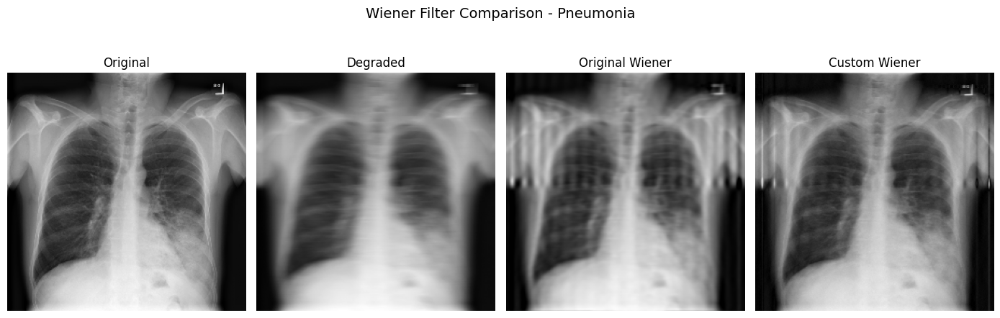

✅ Completed: Pneumonia.png

Processing: Pneumothorax.png


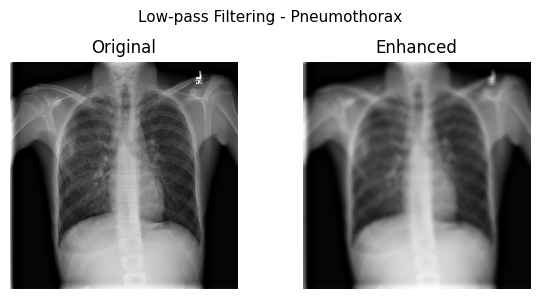

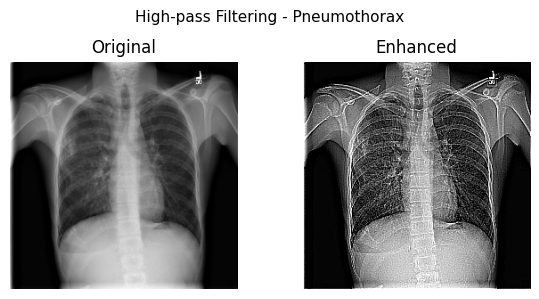

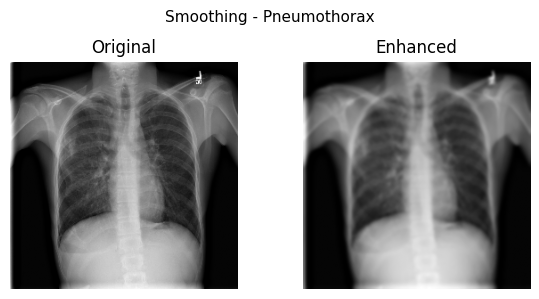

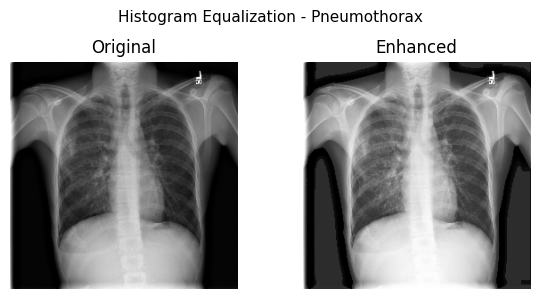

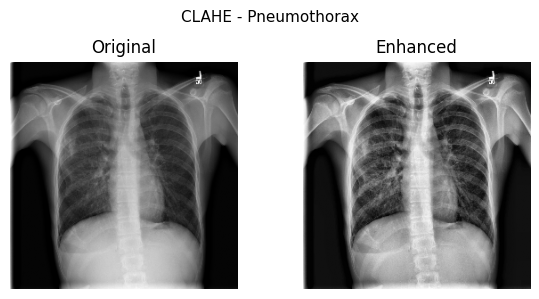

...

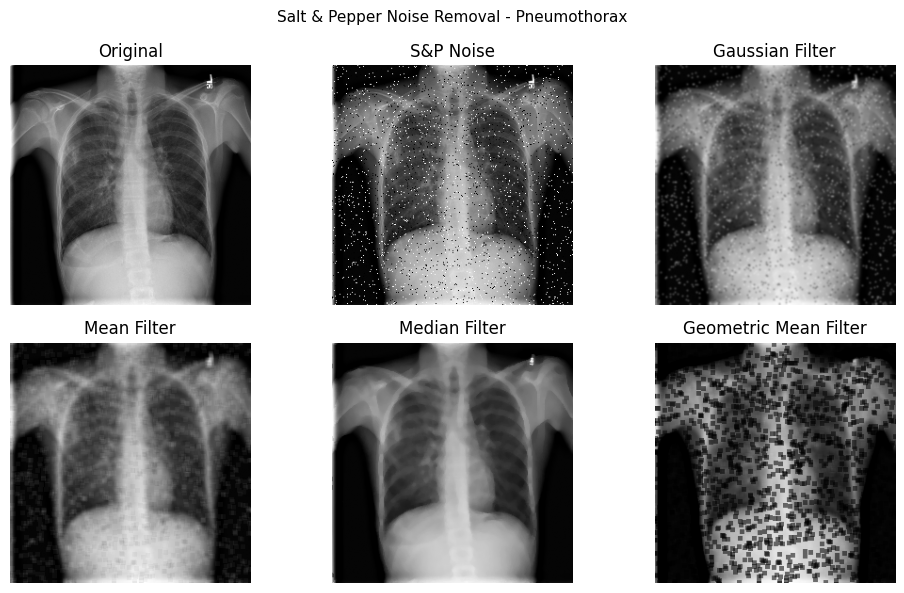

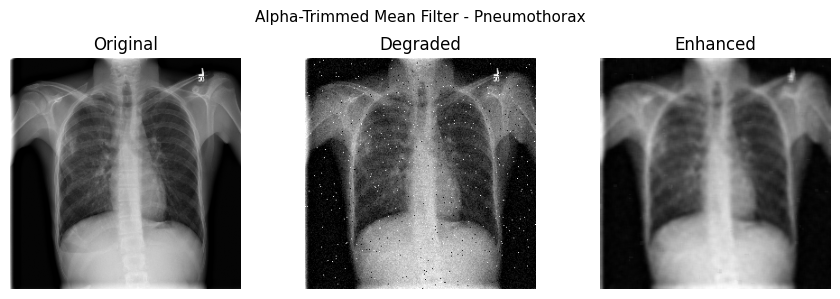

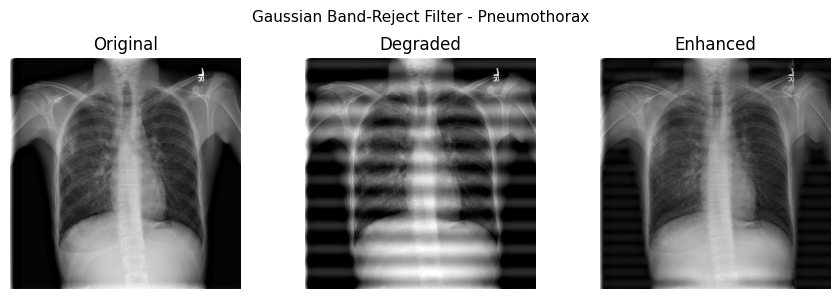

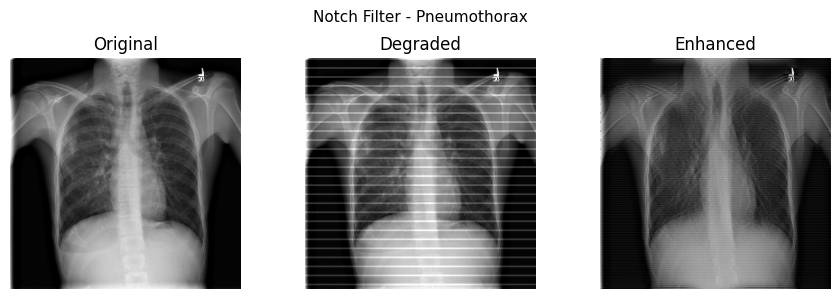

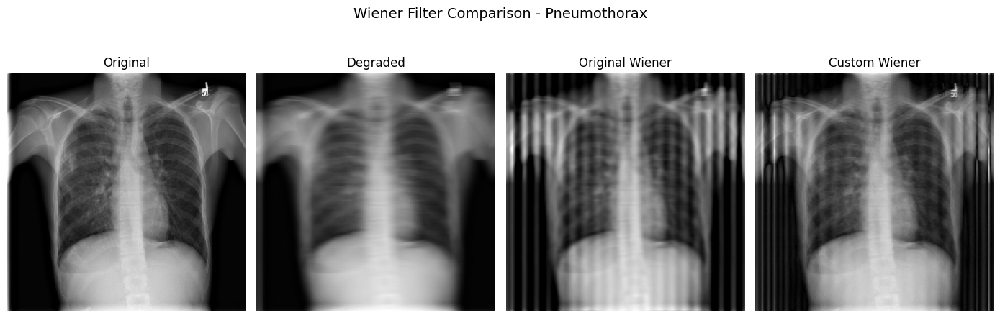

✅ Completed: Pneumothorax.png

🎉 All processing completed! Results saved in 'enhancement_results' directory

📁 Output structure:
📁 enhancement_results/
  📁 notch_filter/
    📄 Consolidation_notch.png
    📄 Fibrosis_notch.png
    📄 Edema_notch.png
    📄 Pneumonia_notch.png
    📄 Atelectasis_notch.png
    ... and 5 more files
  📁 gaussian_noise_removal/
    📄 Emphysema_gaussian_noise.png
    📄 Consolidation_gaussian_noise.png
    📄 Effusion_gaussian_noise.png
    📄 Atelectasis_gaussian_noise.png
    📄 Pneumonia_gaussian_noise.png
    ... and 5 more files
  📁 prewitt_edge/
    📄 Pneumonia_prewitt.png
    📄 Consolidation_prewitt.png
    📄 Effusion_prewitt.png
    📄 Emphysema_prewitt.png
    📄 Pneumothorax_prewitt.png
    ... and 5 more files
  📁 clahe/
    📄 Consolidation_clahe.png
    📄 No Finding_clahe.png
    📄 Atelectasis_clahe.png
    📄 Effusion_clahe.png
    📄 Pneumonia_clahe.png
    ... and 5 more files
  📁 highpass_filtering/
    📄 Fibrosis_highpass.png
    📄 Emphysema_highpass.png

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.util import random_noise
from skimage import restoration
import os

# ================= Configuration =================
INPUT_DIR = "sample_images"
OUTPUT_DIR = "enhancement_results"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# List of all sample images
image_files = [
    "Atelectasis.png", "Cardiomegaly.png", "Consolidation.png", "Edema.png",
    "Effusion.png", "Emphysema.png", "Fibrosis.png", "No Finding.png",
    "Pneumonia.png", "Pneumothorax.png"
]

# ================= Utility Functions =================
def load_and_prepare_image(filepath):
    """Load and preprocess a single image"""
    img = cv2.imread(filepath, cv2.IMREAD_UNCHANGED)
    if img is None:
        raise FileNotFoundError(f"Image not found: {filepath}")

    if len(img.shape) == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    img = cv2.resize(img, (256, 256))
    return img

def show2(original, enhanced, title, filename):
    """Display two images side by side"""
    plt.figure(figsize=(6, 3))
    plt.subplot(1, 2, 1)
    plt.imshow(original, cmap='gray')
    plt.title('Original')
    plt.axis('off')
    plt.subplot(1, 2, 2)
    plt.imshow(enhanced, cmap='gray')
    plt.title('Enhanced')
    plt.axis('off')
    plt.suptitle(f"{title} - {filename}", fontsize=11)
    plt.tight_layout()
    plt.show()

def show3(original, degraded, enhanced, title, filename):
    """Display three images side by side"""
    plt.figure(figsize=(9, 3))
    plt.subplot(1, 3, 1)
    plt.imshow(original, cmap='gray')
    plt.title('Original')
    plt.axis('off')
    plt.subplot(1, 3, 2)
    plt.imshow(degraded, cmap='gray')
    plt.title('Degraded')
    plt.axis('off')
    plt.subplot(1, 3, 3)
    plt.imshow(enhanced, cmap='gray')
    plt.title('Enhanced')
    plt.axis('off')
    plt.suptitle(f"{title} - {filename}", fontsize=11)
    plt.tight_layout()
    plt.show()

def geometric_mean_filter(image, ksize=5):
    """Geometric mean filter implementation"""
    padded = np.pad(image, ksize // 2, mode='reflect')
    result = np.zeros_like(image, dtype=np.float32)
    eps = 1e-6
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            region = padded[i:i+ksize, j:j+ksize].astype(np.float32)
            region = np.maximum(region, eps)
            result[i, j] = np.exp(np.mean(np.log(region)))
    return np.clip(result, 0, 255).astype(np.uint8)

def alpha_trimmed_mean_filter(image, ksize=5, alpha=2):
    """Alpha-trimmed mean filter implementation"""
    pad = ksize // 2
    padded = np.pad(image, pad, mode='reflect')
    filtered = np.zeros_like(image, dtype=np.float32)
    total = ksize * ksize
    trim = min(alpha, total - 1)
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            window = padded[i:i + ksize, j:j + ksize].flatten()
            window.sort()
            trimmed = window[trim // 2: total - trim // 2]
            filtered[i, j] = np.mean(trimmed)
    filtered = np.clip(filtered, 0, 255)
    return filtered.astype(np.uint8)

def notch_filter_remove_periodic(image, num_peaks=8, sigma=10):
    """Notch filter for periodic noise removal"""
    rows, cols = image.shape
    dft = np.fft.fft2(image.astype(np.float32))
    dft_shift = np.fft.fftshift(dft)
    mag = np.log(np.abs(dft_shift) + 1.0)
    crow, ccol = rows // 2, cols // 2
    mag_masked = mag.copy()
    Y, X = np.ogrid[:rows, :cols]
    dist_center = np.sqrt((X - ccol) ** 2 + (Y - crow) ** 2)
    mag_masked[dist_center <= 10] = 0
    flat = mag_masked.ravel()
    num_peaks = min(num_peaks, flat.size)
    idx = np.argpartition(-flat, num_peaks)[:num_peaks]
    coords = np.vstack(np.unravel_index(idx, mag_masked.shape)).T
    H = np.ones((rows, cols), dtype=np.float32)
    for (r, c) in coords:
        u, v = c - ccol, r - crow
        pos = (int(crow + v), int(ccol + u))
        neg = (int(crow - v), int(ccol - u))
        for (py, px) in [pos, neg]:
            if 0 <= py < rows and 0 <= px < cols:
                dist = np.sqrt((X - px) ** 2 + (Y - py) ** 2)
                H *= (1.0 - np.exp(-(dist ** 2) / (2 * (sigma ** 2))))
    H = cv2.GaussianBlur(H, (9, 9), 3)
    dft_shift_filtered = dft_shift * H
    f_ishift = np.fft.ifftshift(dft_shift_filtered)
    img_back = np.fft.ifft2(f_ishift)
    img_back = np.abs(img_back)
    img_back = (img_back - img_back.min()) / (img_back.max() - img_back.min() + 1e-8)
    img_back = (img_back * 255).astype(np.uint8)
    return img_back

def custom_wiener(img, psf, K=0.006):
    """Custom Wiener filter implementation"""
    rows, cols = img.shape
    psf_padded = np.zeros_like(img)
    kh, kw = psf.shape
    psf_padded[:kh, :kw] = psf
    psf_padded = np.roll(psf_padded, -kh//2, axis=0)
    psf_padded = np.roll(psf_padded, -kw//2, axis=1)

    G = np.fft.fft2(img)
    H = np.fft.fft2(psf_padded)
    H_conj = np.conj(H)
    denom = (np.abs(H) ** 2) + K
    F_hat = (H_conj / denom) * G
    f_hat = np.abs(np.fft.ifft2(F_hat))
    return np.clip(f_hat, 0, 1)

# ================= Main Processing Function =================
def process_single_image(img, filename):
    """Process a single image through all enhancement techniques"""
    rows, cols = img.shape
    crow, ccol = rows // 2, cols // 2

    # Create individual directories for each technique
    technique_dirs = {
        'original': 'original',
        'lowpass': 'lowpass_filtering',
        'highpass': 'highpass_filtering',
        'gaussian_smooth': 'gaussian_smoothing',
        'hist_eq': 'histogram_equalization',
        'clahe': 'clahe',
        'sobel': 'sobel_edge',
        'prewitt': 'prewitt_edge',
        'freq_sharpen': 'frequency_sharpening',
        'laplacian': 'laplacian',
        'gaussian_noise_removal': 'gaussian_noise_removal',
        'salt_pepper_removal': 'salt_pepper_removal',
        'alpha_trimmed': 'alpha_trimmed_mean',
        'bandreject': 'bandreject_filter',
        'notch': 'notch_filter',
        'wiener': 'wiener_filter'
    }

    # Create all directories
    for dir_name in technique_dirs.values():
        os.makedirs(os.path.join(OUTPUT_DIR, dir_name), exist_ok=True)

    # Save original
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['original'], f"{filename}_original.png"), img)

    # ================= Basic Enhancement Techniques =================

    # 1. Low-pass Filtering
    enhanced = cv2.blur(img, (5, 5))
    show2(img, enhanced, "Low-pass Filtering", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['lowpass'], f"{filename}_lowpass.png"), enhanced)

    # 2. High-pass Filtering
    kernel_hp = np.array([[-1, -1, -1],
                          [-1,  9, -1],
                          [-1, -1, -1]])
    enhanced = cv2.filter2D(img, -1, kernel_hp)
    show2(img, enhanced, "High-pass Filtering", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['highpass'], f"{filename}_highpass.png"), enhanced)

    # 3. Gaussian Smoothing
    enhanced = cv2.GaussianBlur(img, (7, 7), 0)
    show2(img, enhanced, "Smoothing", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['gaussian_smooth'], f"{filename}_gaussian_smooth.png"), enhanced)

    # 4. Histogram Equalization
    enhanced = cv2.equalizeHist(img)
    show2(img, enhanced, "Histogram Equalization", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['hist_eq'], f"{filename}_hist_eq.png"), enhanced)

    # 5. CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(img)
    show2(img, enhanced, "CLAHE", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['clahe'], f"{filename}_clahe.png"), enhanced)

    # 6. Sobel Edge Enhancement
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
    sobel_mag = cv2.magnitude(sobelx, sobely)
    sobel_mag = cv2.normalize(sobel_mag, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    enhanced = cv2.addWeighted(img, 0.7, sobel_mag, 0.7, 0)
    show2(img, enhanced, "Sobel Edge Enhancement", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['sobel'], f"{filename}_sobel.png"), enhanced)

    # 7. Prewitt Edge Enhancement
    kernelx = np.array([[1, 0, -1],
                        [1, 0, -1],
                        [1, 0, -1]])
    kernely = np.array([[1, 1, 1],
                        [0, 0, 0],
                        [-1, -1, -1]])
    gx = cv2.filter2D(img.astype(np.float32), cv2.CV_32F, kernelx)
    gy = cv2.filter2D(img.astype(np.float32), cv2.CV_32F, kernely)
    prewitt_mag = cv2.magnitude(gx, gy)
    prewitt_mag = cv2.normalize(prewitt_mag, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    enhanced = cv2.addWeighted(img, 0.7, prewitt_mag, 0.7, 0)
    show2(img, enhanced, "Prewitt Edge Enhancement", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['prewitt'], f"{filename}_prewitt.png"), enhanced)

    # 8. Frequency Domain Sharpening
    dft = cv2.dft(np.float32(img), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)
    mask = np.ones_like(dft_shift)
    mask[rows // 2 - 20:rows // 2 + 20, cols // 2 - 20:cols // 2 + 20] = 0
    fshift = dft_shift * mask
    f_ishift = np.fft.ifftshift(fshift)
    img_back = cv2.idft(f_ishift)
    magnitude = cv2.magnitude(img_back[:, :, 0], img_back[:, :, 1])
    sharpened = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    enhanced = cv2.addWeighted(img, 0.6, sharpened, 0.6, 0)
    show2(img, enhanced, "Frequency Domain Sharpening", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['freq_sharpen'], f"{filename}_freq_sharpen.png"), enhanced)

    # 9. Spatial Filtering (Laplacian)
    lap = cv2.Laplacian(img, cv2.CV_64F)
    enhanced = cv2.convertScaleAbs(img - 0.7 * lap)
    show2(img, enhanced, "Spatial Filtering (Laplacian)", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['laplacian'], f"{filename}_laplacian.png"), enhanced)

    # ================= Noise Removal Techniques =================

    # 10. Gaussian Noise Removal
    degraded = random_noise(img, mode='gaussian', var=0.002)
    degraded = (255 * degraded).astype(np.uint8)
    gauss_filtered = cv2.GaussianBlur(degraded, (5, 5), 1.2)
    mean_filtered = cv2.blur(degraded, (7, 7))
    median_filtered = cv2.medianBlur(degraded, 5)
    geo_filtered = geometric_mean_filter(degraded, 5)

    plt.figure(figsize=(10, 6))
    titles = ["Original", "Gaussian Noise", "Gaussian Filter", "Mean Filter", "Median Filter", "Geometric Mean Filter"]
    images = [img, degraded, gauss_filtered, mean_filtered, median_filtered, geo_filtered]
    for i in range(6):
        plt.subplot(2, 3, i + 1)
        plt.imshow(images[i], cmap='gray')
        plt.title(titles[i])
        plt.axis('off')
    plt.suptitle(f"Gaussian Noise Removal - {filename}", fontsize=11)
    plt.tight_layout()
    plt.show()

    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['gaussian_noise_removal'], f"{filename}_gaussian_noise.png"), median_filtered)

    # 11. Salt & Pepper Noise Removal
    degraded = random_noise(img, mode='s&p', amount=0.05)
    degraded = (255 * degraded).astype(np.uint8)
    gauss_filtered = cv2.GaussianBlur(degraded, (5, 5), 1.0)
    mean_filtered = cv2.blur(degraded, (5, 5))
    median_filtered = cv2.medianBlur(degraded, 5)
    geo_filtered = geometric_mean_filter(degraded, 5)

    plt.figure(figsize=(10, 6))
    titles = ["Original", "S&P Noise", "Gaussian Filter", "Mean Filter", "Median Filter", "Geometric Mean Filter"]
    images = [img, degraded, gauss_filtered, mean_filtered, median_filtered, geo_filtered]
    for i in range(6):
        plt.subplot(2, 3, i + 1)
        plt.imshow(images[i], cmap='gray')
        plt.title(titles[i])
        plt.axis('off')
    plt.suptitle(f"Salt & Pepper Noise Removal - {filename}", fontsize=11)
    plt.tight_layout()
    plt.show()

    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['salt_pepper_removal'], f"{filename}_salt_pepper.png"), median_filtered)

    # 12. Alpha-Trimmed Mean Filter (Mixed Noise)
    sp_noisy = random_noise(img, mode='s&p', amount=0.01)
    mix_noisy = (255 * sp_noisy).astype(np.uint8)
    mix_noisy = random_noise(mix_noisy, mode='gaussian', var=0.002)
    mix_noisy = (255 * mix_noisy).astype(np.uint8)

    enhanced = alpha_trimmed_mean_filter(mix_noisy, ksize=5, alpha=2)
    show3(img, mix_noisy, enhanced, "Alpha-Trimmed Mean Filter", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['alpha_trimmed'], f"{filename}_alpha_trimmed.png"), enhanced)

    # 13. Gaussian Band-Reject Filter
    freq = 10
    Y, X = np.mgrid[0:rows, 0:cols]
    periodic = 40 * np.sin(2 * np.pi * freq * Y / rows)
    degraded = img + periodic
    degraded = np.clip(degraded, 0, 255).astype(np.uint8)
    f = np.fft.fft2(degraded)
    fshift = np.fft.fftshift(f)
    mask = np.ones((rows, cols), np.float32)
    D0 = 10
    W = 8
    for u in range(rows):
        D = abs(u - crow)
        mask[u, :] = 1 - np.exp(-((D ** 2 - D0 ** 2) / (D * W + 1e-5)) ** 2)
    fshift_filtered = fshift * mask
    f_ishift = np.fft.ifftshift(fshift_filtered)
    restored = np.abs(np.fft.ifft2(f_ishift))
    enhanced = cv2.normalize(restored, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)
    show3(img, degraded, enhanced, "Gaussian Band-Reject Filter", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['bandreject'], f"{filename}_bandreject.png"), enhanced)

    # 14. Notch Filter
    degraded = img.astype(np.float32)
    for i in range(0, rows, 10):
        degraded[i:i + 2, :] += 50
    degraded = np.clip(degraded, 0, 255).astype(np.uint8)
    enhanced = notch_filter_remove_periodic(degraded, num_peaks=8, sigma=10)
    show3(img, degraded, enhanced, "Notch Filter", filename)
    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['notch'], f"{filename}_notch.png"), enhanced)

    # 15. Wiener Filter
    psf = np.zeros((13, 13))
    cv2.line(psf, (0, 6), (12, 6), 1, thickness=1)
    psf /= psf.sum()

    degraded = cv2.filter2D(img.astype(np.float32) / 255.0, -1, psf)
    degraded += 0.001 * np.random.normal(size=img.shape)
    degraded = np.clip(degraded, 0, 1)

    custom_restored = custom_wiener(degraded, psf, K=0.006)
    custom_restored = cv2.GaussianBlur(custom_restored, (3, 3), 0.25)

    original_restored = restoration.wiener(degraded, psf, balance=0.05, clip=False)
    original_restored = np.clip(original_restored, 0, 1)
    original_restored = cv2.GaussianBlur(original_restored, (3, 3), 0.25)

    degraded_show = (degraded * 255).astype(np.uint8)
    custom_show = (custom_restored * 255).astype(np.uint8)
    original_show = (original_restored * 255).astype(np.uint8)

    plt.figure(figsize=(14, 5))
    titles = ["Original", "Degraded", "Original Wiener", "Custom Wiener"]
    images = [img, degraded_show, original_show, custom_show]

    for i, (im, t) in enumerate(zip(images, titles)):
        plt.subplot(1, 4, i + 1)
        plt.imshow(im, cmap='gray')
        plt.title(t)
        plt.axis('off')

    plt.suptitle(f"Wiener Filter Comparison - {filename}", fontsize=14)
    plt.tight_layout()
    plt.show()

    cv2.imwrite(os.path.join(OUTPUT_DIR, technique_dirs['wiener'], f"{filename}_wiener.png"), custom_show)

# ================= Main Execution =================
def main():
    print("Starting image enhancement processing for all 10 images...")

    for image_file in image_files:
        try:
            filepath = os.path.join(INPUT_DIR, image_file)
            print(f"\nProcessing: {image_file}")

            # Load and prepare image
            img = load_and_prepare_image(filepath)

            # Get filename without extension for saving
            filename_base = os.path.splitext(image_file)[0]

            # Process the image through all techniques
            process_single_image(img, filename_base)

            print(f" Completed: {image_file}")

        except Exception as e:
            print(f" Error processing {image_file}: {str(e)}")
            continue

    print(f"\n All processing completed! Results saved in '{OUTPUT_DIR}' directory")
    print(f"\n Output structure:")
    for root, dirs, files in os.walk(OUTPUT_DIR):
        level = root.replace(OUTPUT_DIR, '').count(os.sep)
        indent = ' ' * 2 * level
        print(f"{indent} {os.path.basename(root)}/")
        sub_indent = ' ' * 2 * (level + 1)
        for file in files[:5]:  # Show first 5 files per directory
            print(f"{sub_indent}📄 {file}")
        if len(files) > 5:
            print(f"{sub_indent}... and {len(files) - 5} more files")

if __name__ == "__main__":
    main()

In [2]:
import os
import cv2
import numpy as np
import pandas as pd
from scipy.stats import skew, kurtosis
from skimage.feature import graycomatrix, graycoprops, local_binary_pattern
from skimage.measure import shannon_entropy

# ===== Configuration =====
BASE_DIR = "enhancement_results"
OUTPUT_CSV = "handcrafted_features_10_images.csv"

# List of all original image names
ORIGINAL_IMAGES = [
    "Atelectasis", "Cardiomegaly", "Consolidation", "Edema", "Effusion",
    "Emphysema", "Fibrosis", "No Finding", "Pneumonia", "Pneumothorax"
]

# Enhancement techniques directories
TECHNIQUE_DIRS = {
    'original': 'original',
    'lowpass': 'lowpass_filtering',
    'highpass': 'highpass_filtering',
    'gaussian_smooth': 'gaussian_smoothing',
    'hist_eq': 'histogram_equalization',
    'clahe': 'clahe',
    'sobel': 'sobel_edge',
    'prewitt': 'prewitt_edge',
    'freq_sharpen': 'frequency_sharpening',
    'laplacian': 'laplacian',
    'gaussian_noise_removal': 'gaussian_noise_removal',
    'salt_pepper_removal': 'salt_pepper_removal',
    'alpha_trimmed': 'alpha_trimmed_mean',
    'bandreject': 'bandreject_filter',
    'notch': 'notch_filter',
    'wiener': 'wiener_filter'
}

# ===== Handcrafted Feature Extraction =====
def extract_features(image_path):
    """Extract handcrafted features from an image"""
    img_gray = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img_gray is None:
        print(f" Could not read {image_path}")
        return None

    img_gray = cv2.resize(img_gray, (256, 256))

    # ---- Basic Statistics ----
    mean = float(np.mean(img_gray))
    std = float(np.std(img_gray))
    var = float(np.var(img_gray))
    skw = float(skew(img_gray.flatten()))
    kur = float(kurtosis(img_gray.flatten()))
    ent = float(shannon_entropy(img_gray))

    # ---- GLCM Features ----
    glcm = graycomatrix(img_gray, distances=[1], angles=[0], symmetric=True, normed=True)
    contrast = float(graycoprops(glcm, 'contrast')[0, 0])
    dissimilarity = float(graycoprops(glcm, 'dissimilarity')[0, 0])
    homogeneity = float(graycoprops(glcm, 'homogeneity')[0, 0])
    energy = float(graycoprops(glcm, 'energy')[0, 0])
    correlation = float(graycoprops(glcm, 'correlation')[0, 0])

    # ---- LBP Features ----
    lbp = local_binary_pattern(img_gray, P=8, R=1, method="uniform")
    lbp_hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, 10), range=(0, 9))
    lbp_hist = lbp_hist.astype("float")
    lbp_hist /= (lbp_hist.sum() + 1e-7)

    # ---- Hu Moments ----
    moments = cv2.moments(img_gray)
    hu_moments = cv2.HuMoments(moments).flatten()

    # Combine all features
    features = [
        mean, std, var, skw, kur, ent,
        contrast, dissimilarity, homogeneity, energy, correlation
    ]
    features.extend(lbp_hist.tolist())
    features.extend(hu_moments.tolist())

    return features

# ===== Collect Features for All Images =====
def collect_all_features():
    """Collect features for all original images and their enhanced versions"""
    features_list = []

    print("Starting feature extraction for all images...")

    for original_name in ORIGINAL_IMAGES:
        print(f"\n Processing: {original_name}")

        for technique_key, technique_dir in TECHNIQUE_DIRS.items():
            # Construct filename based on technique
            if technique_key == 'original':
                filename = f"{original_name}_original.png"
            else:
                filename = f"{original_name}_{technique_key}.png"

            image_path = os.path.join(BASE_DIR, technique_dir, filename)

            # Check if file exists
            if not os.path.exists(image_path):
                print(f"    File not found: {filename}")
                continue

            # Extract features
            print(f"   Extracting features from: {filename}")
            feature_vector = extract_features(image_path)

            if feature_vector is not None:
                # Create row data
                row_data = [original_name, technique_key, filename] + feature_vector
                features_list.append(row_data)
                print(f"   Success: {filename}")
            else:
                print(f"   Failed to extract features: {filename}")

    return features_list

# ===== Create Feature DataFrame =====
def create_feature_dataframe(features_list):
    """Create pandas DataFrame from extracted features"""

    # Define column names
    feature_columns = [
        "Mean", "Std", "Variance", "Skewness", "Kurtosis", "Entropy",
        "Contrast", "Dissimilarity", "Homogeneity", "Energy", "Correlation"
    ]
    lbp_columns = [f"LBP_{i}" for i in range(9)]
    hu_columns = [f"HuMoment_{i+1}" for i in range(7)]

    all_columns = ["Original_Image", "Technique", "Filename"] + feature_columns + lbp_columns + hu_columns

    # Create DataFrame
    df = pd.DataFrame(features_list, columns=all_columns)
    return df

# ===== Main Execution =====
def main():
    print(" Starting handcrafted feature extraction for 10 images...")
    print(f" Base directory: {BASE_DIR}")
    print(f" Output CSV: {OUTPUT_CSV}")

    # Check if base directory exists
    if not os.path.exists(BASE_DIR):
        print(f" Error: Directory '{BASE_DIR}' not found!")
        print("Please run the image enhancement code first to generate the results.")
        return

    # Collect all features
    features_data = collect_all_features()

    if not features_data:
        print(" No features were extracted. Please check your file paths.")
        return

    # Create and save DataFrame
    df = create_feature_dataframe(features_data)

    # Save to CSV
    df.to_csv(OUTPUT_CSV, index=False)

    # Print summary
    print(f"\n Feature extraction completed!")
    print(f" Total samples: {len(df)}")
    print(f" Saved to: {OUTPUT_CSV}")

    # Print detailed summary
    print(f"\n Summary by technique:")
    technique_counts = df['Technique'].value_counts()
    for technique, count in technique_counts.items():
        print(f"   {technique}: {count} images")

    print(f"\n Summary by original image:")
    image_counts = df['Original_Image'].value_counts()
    for image, count in image_counts.items():
        print(f"   {image}: {count} enhanced versions")

    # Display first few rows
    print(f"\n First 5 rows of the dataset:")
    print(df.head())

    # Display dataset info
    print(f"\n Dataset shape: {df.shape}")
    print(f" Total features: {len(df.columns) - 3}")  # Subtract 3 for metadata columns

    return df

# ===== Run the script =====
if __name__ == "__main__":
    df = main()

 Starting handcrafted feature extraction for 10 images...
 Base directory: enhancement_results
 Output CSV: handcrafted_features_10_images.csv
Starting feature extraction for all images...

 Processing: Atelectasis
   Extracting features from: Atelectasis_original.png
   Success: Atelectasis_original.png
   Extracting features from: Atelectasis_lowpass.png
   Success: Atelectasis_lowpass.png
   Extracting features from: Atelectasis_highpass.png
   Success: Atelectasis_highpass.png
   Extracting features from: Atelectasis_gaussian_smooth.png
   Success: Atelectasis_gaussian_smooth.png
   Extracting features from: Atelectasis_hist_eq.png
   Success: Atelectasis_hist_eq.png
   Extracting features from: Atelectasis_clahe.png
   Success: Atelectasis_clahe.png
   Extracting features from: Atelectasis_sobel.png
   Success: Atelectasis_sobel.png
   Extracting features from: Atelectasis_prewitt.png
   Success: Atelectasis_prewitt.png
   Extracting features from: Atelectasis_freq_sharpen.png
   

<Figure size 1800x1000 with 0 Axes>

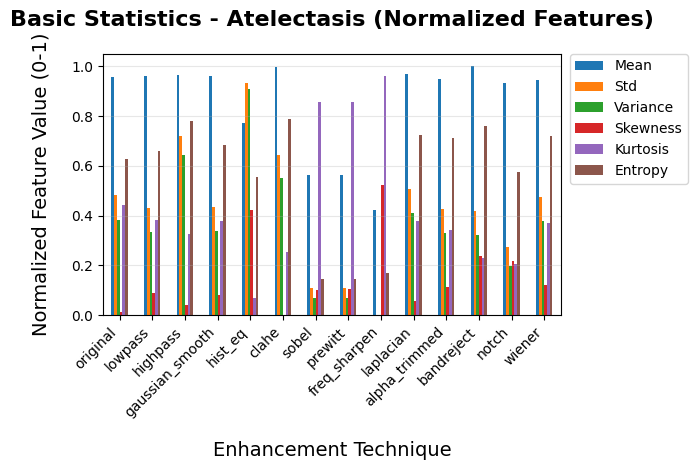

<Figure size 1800x1000 with 0 Axes>

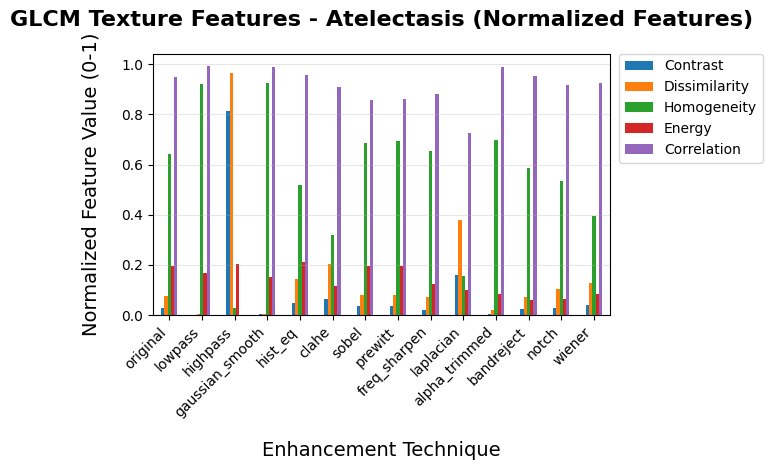

<Figure size 1800x1000 with 0 Axes>

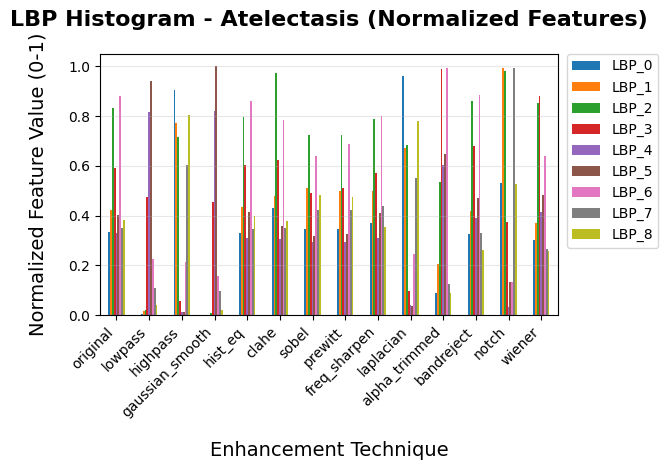

<Figure size 1800x1000 with 0 Axes>

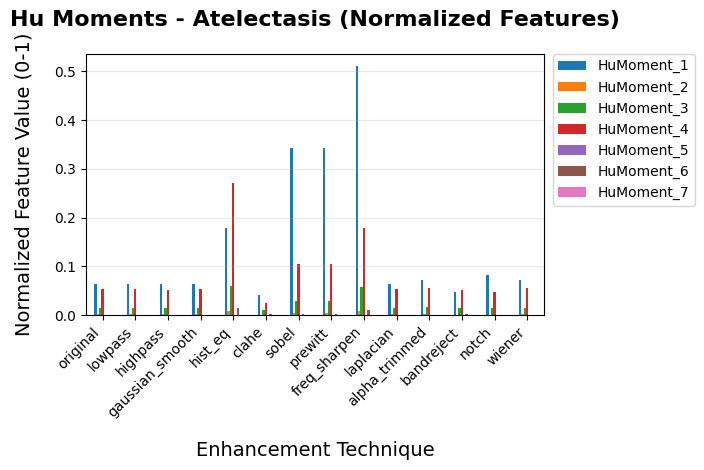

<Figure size 1800x1000 with 0 Axes>

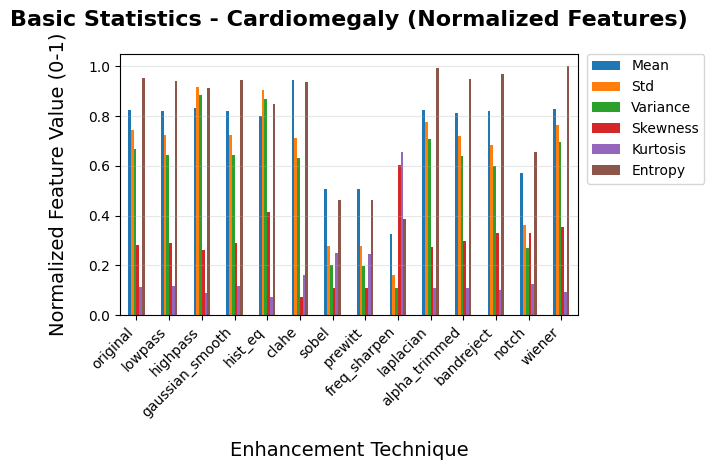

<Figure size 1800x1000 with 0 Axes>

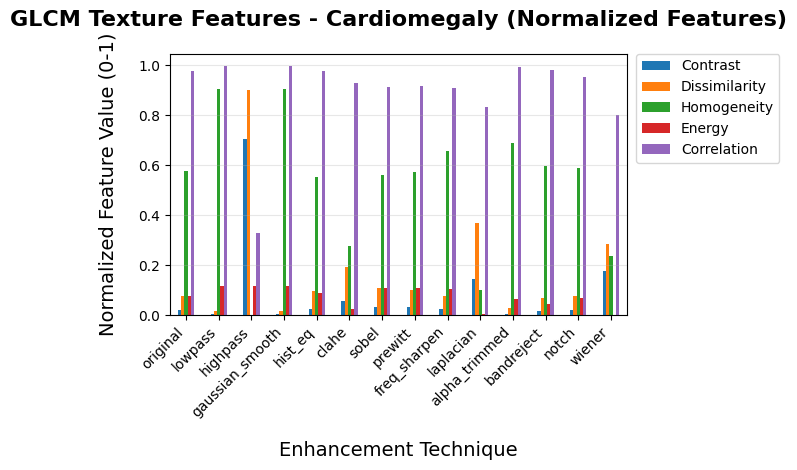

<Figure size 1800x1000 with 0 Axes>

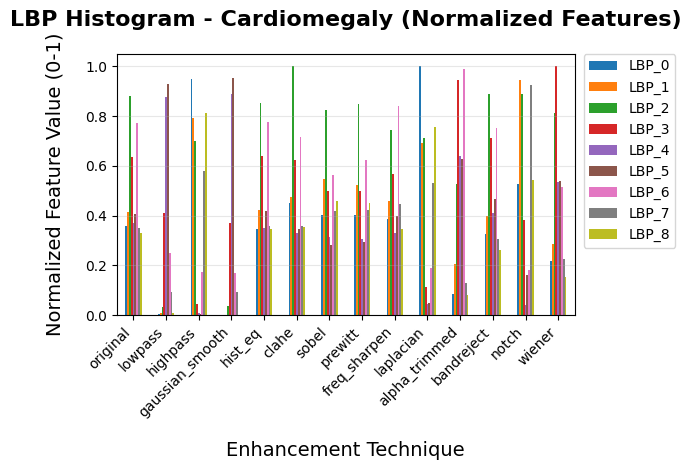

<Figure size 1800x1000 with 0 Axes>

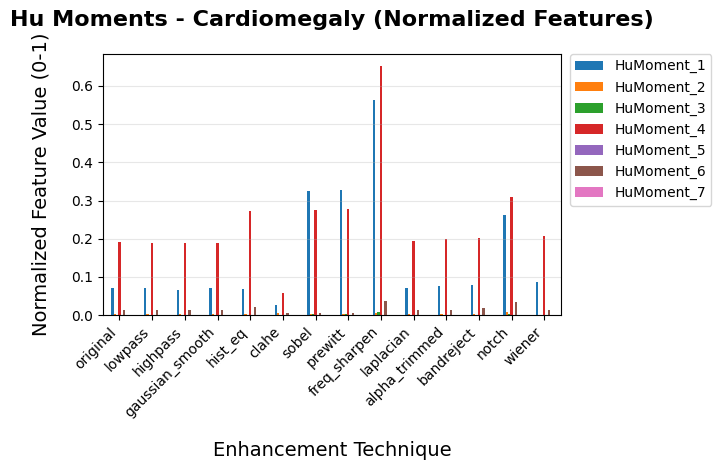

<Figure size 1800x1000 with 0 Axes>

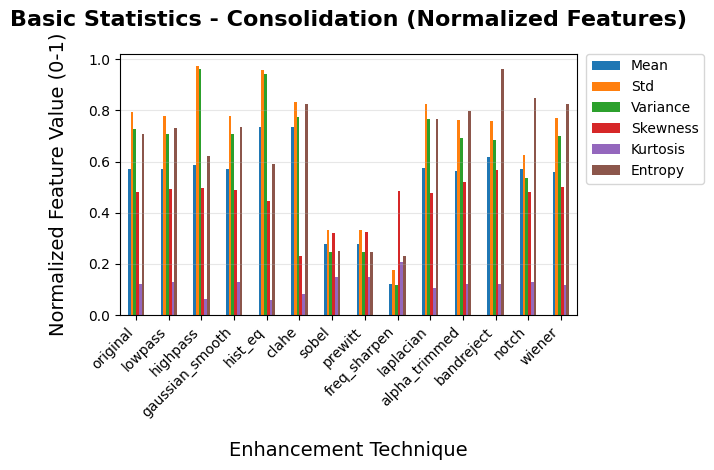

<Figure size 1800x1000 with 0 Axes>

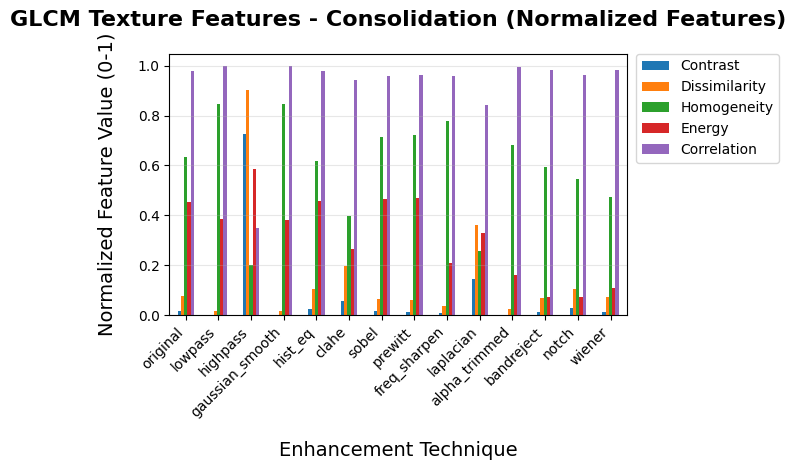

<Figure size 1800x1000 with 0 Axes>

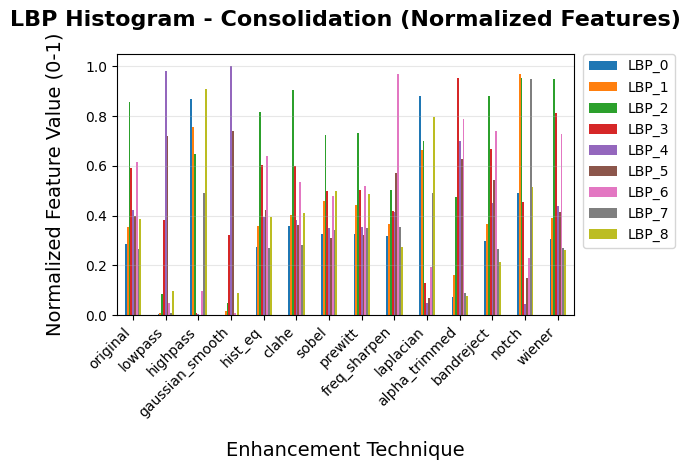

<Figure size 1800x1000 with 0 Axes>

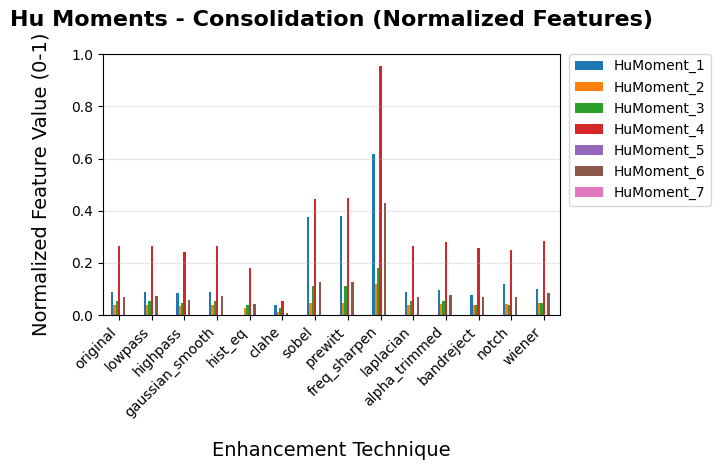

<Figure size 1800x1000 with 0 Axes>

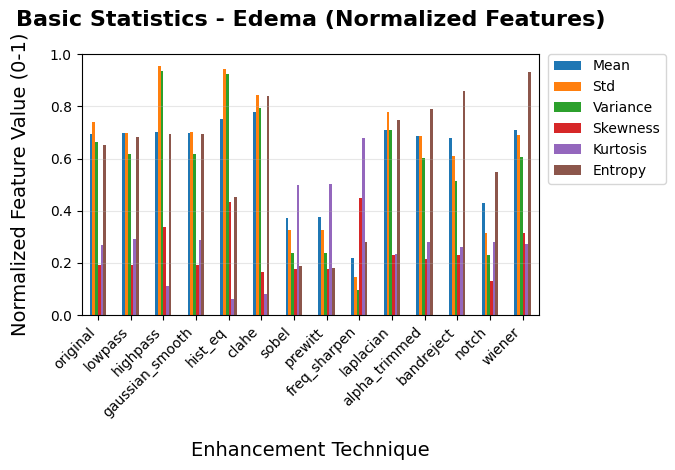

<Figure size 1800x1000 with 0 Axes>

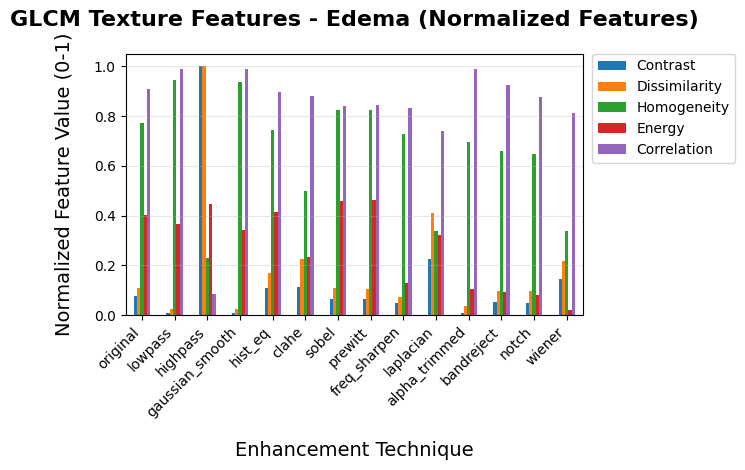

<Figure size 1800x1000 with 0 Axes>

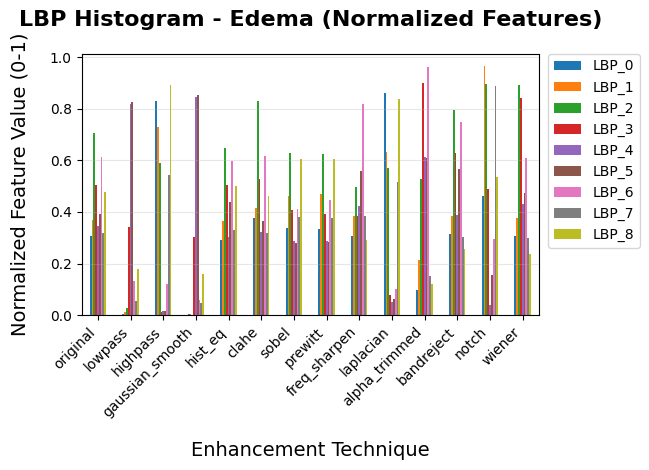

<Figure size 1800x1000 with 0 Axes>

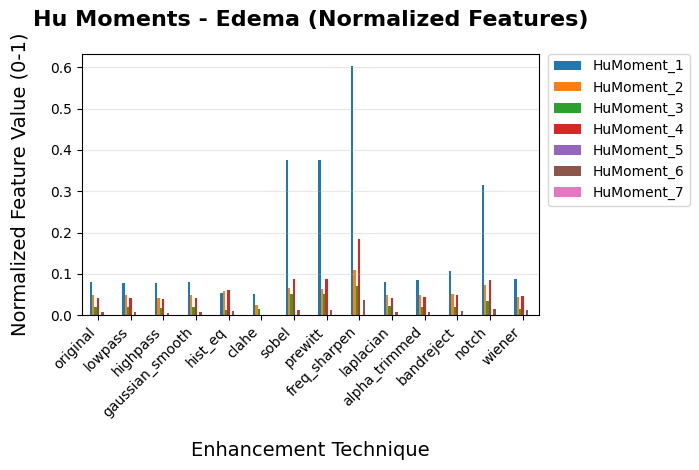

<Figure size 1800x1000 with 0 Axes>

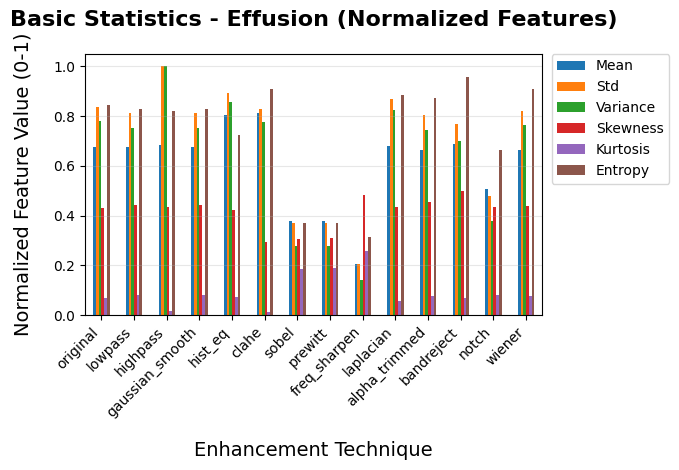

<Figure size 1800x1000 with 0 Axes>

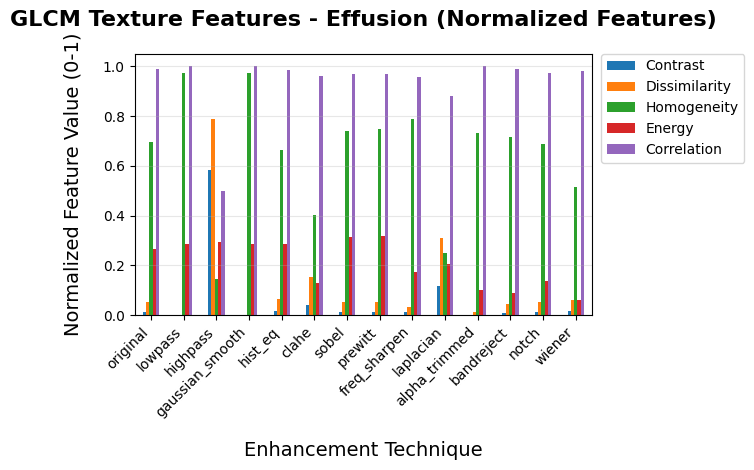

<Figure size 1800x1000 with 0 Axes>

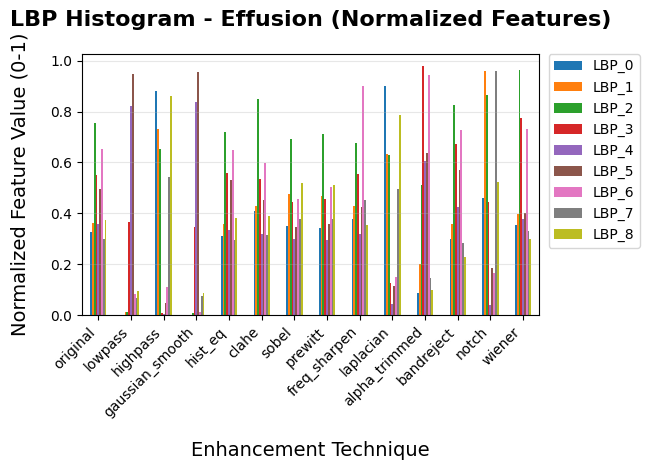

<Figure size 1800x1000 with 0 Axes>

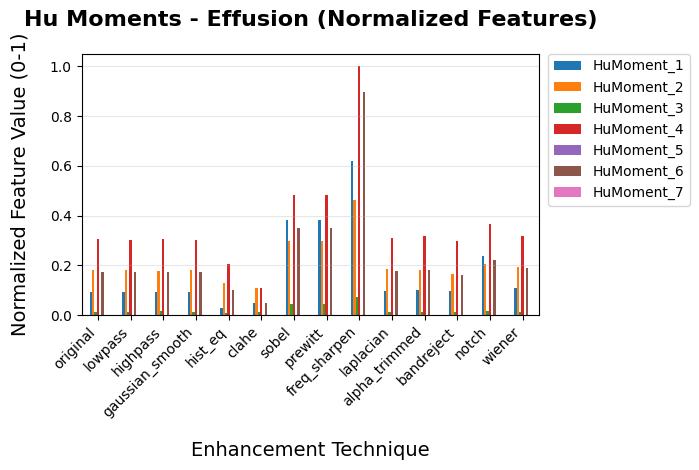

<Figure size 1800x1000 with 0 Axes>

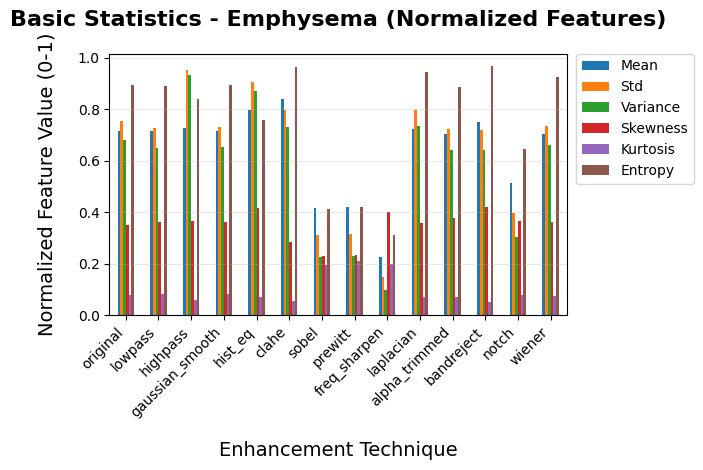

<Figure size 1800x1000 with 0 Axes>

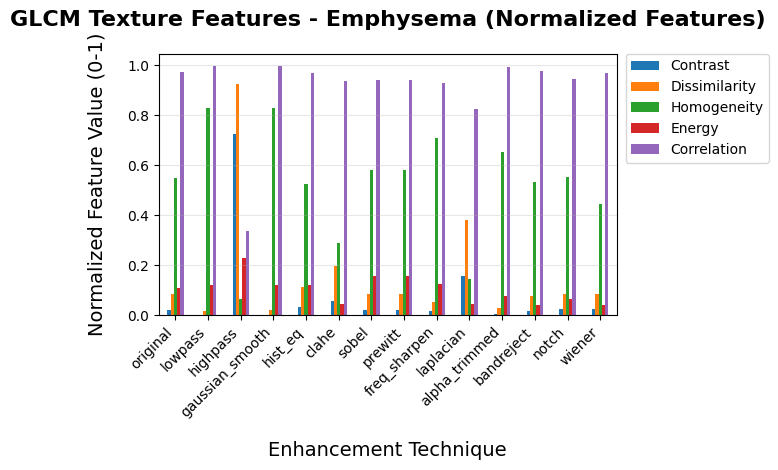

<Figure size 1800x1000 with 0 Axes>

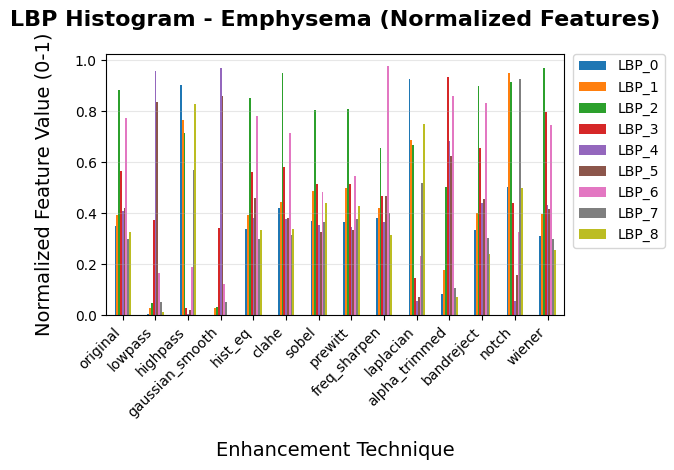

<Figure size 1800x1000 with 0 Axes>

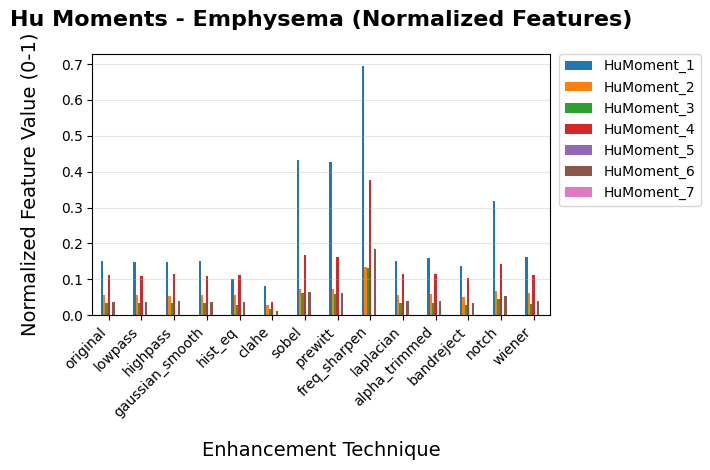

<Figure size 1800x1000 with 0 Axes>

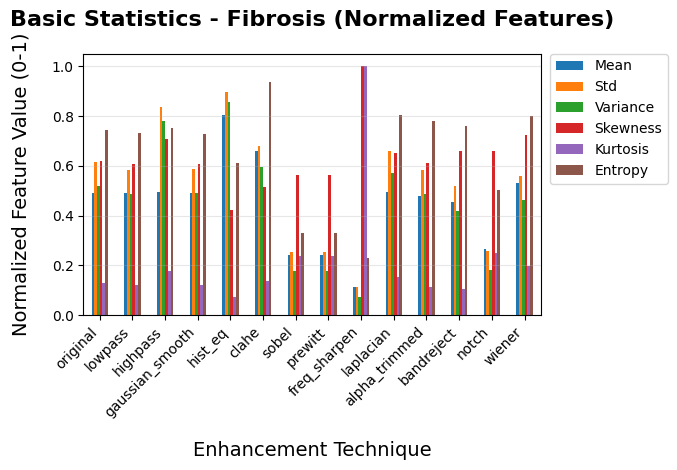

<Figure size 1800x1000 with 0 Axes>

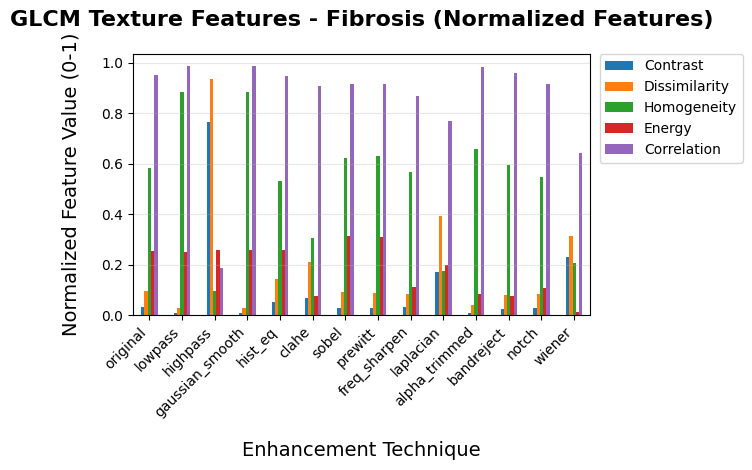

<Figure size 1800x1000 with 0 Axes>

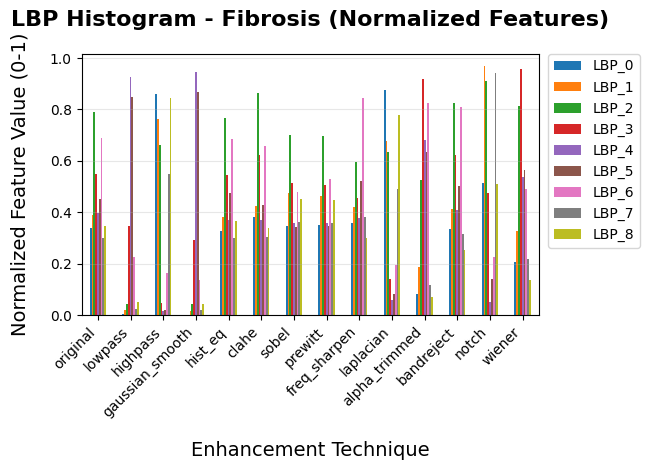

<Figure size 1800x1000 with 0 Axes>

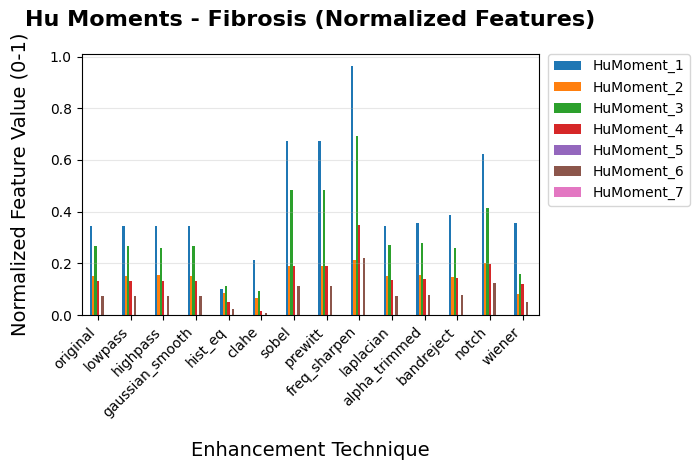

<Figure size 1800x1000 with 0 Axes>

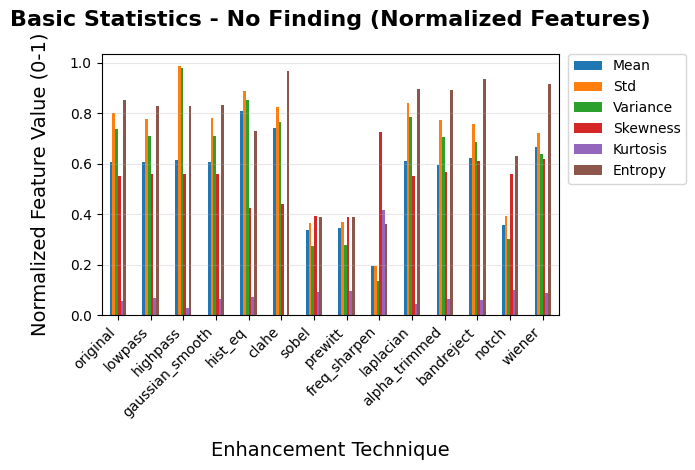

<Figure size 1800x1000 with 0 Axes>

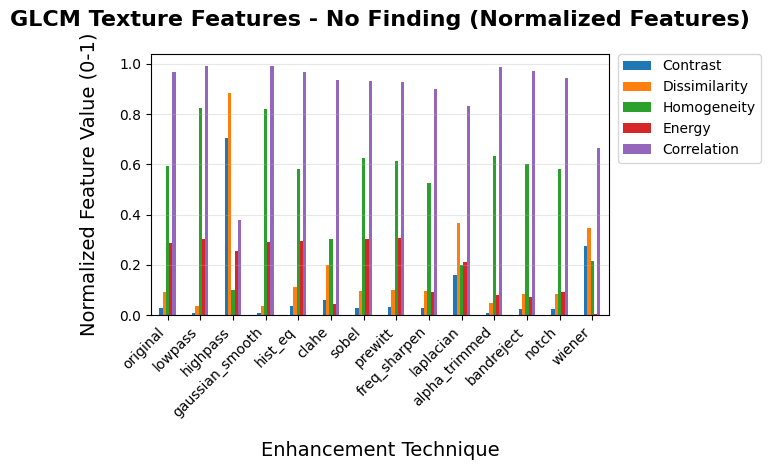

<Figure size 1800x1000 with 0 Axes>

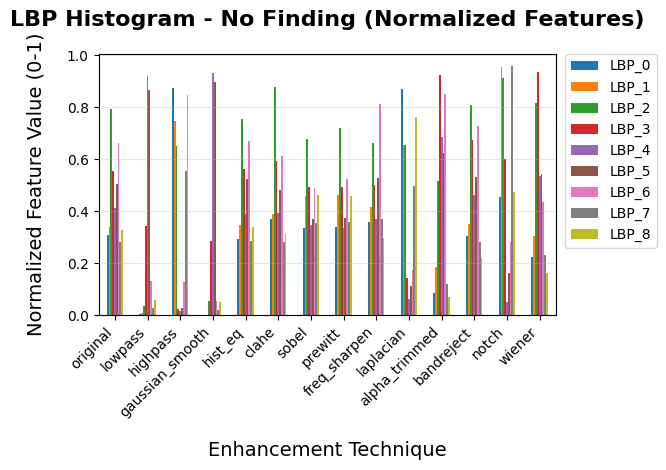

<Figure size 1800x1000 with 0 Axes>

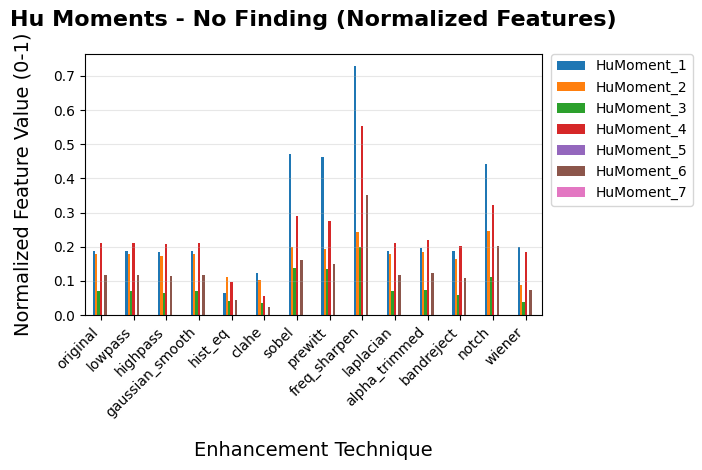

<Figure size 1800x1000 with 0 Axes>

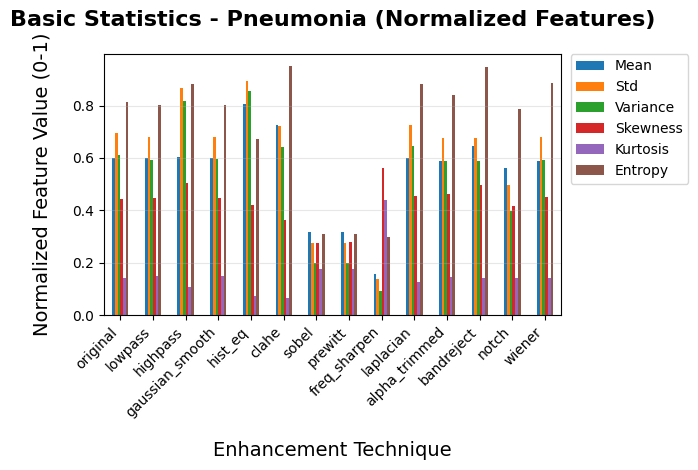

<Figure size 1800x1000 with 0 Axes>

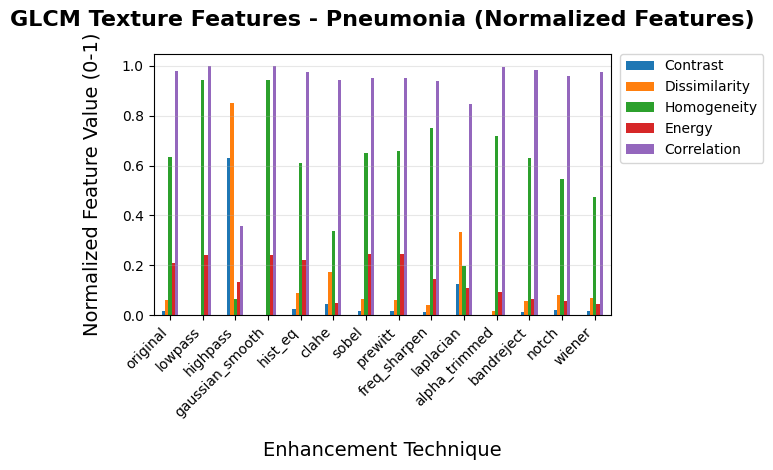

<Figure size 1800x1000 with 0 Axes>

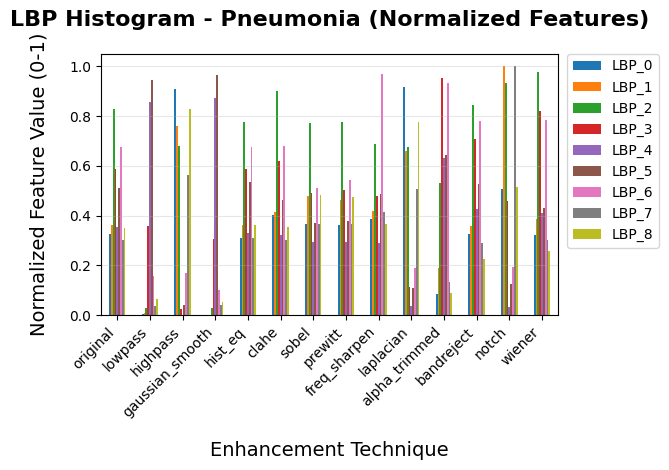

<Figure size 1800x1000 with 0 Axes>

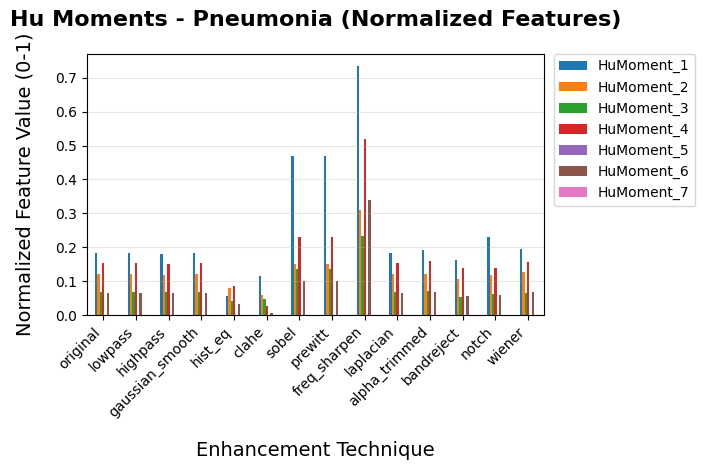

<Figure size 1800x1000 with 0 Axes>

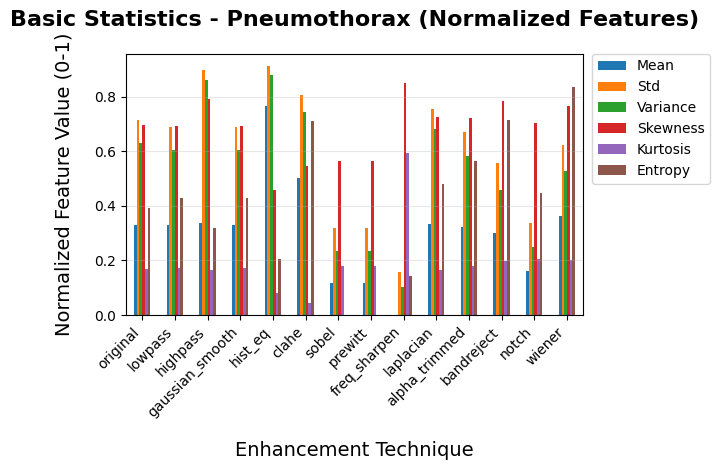

<Figure size 1800x1000 with 0 Axes>

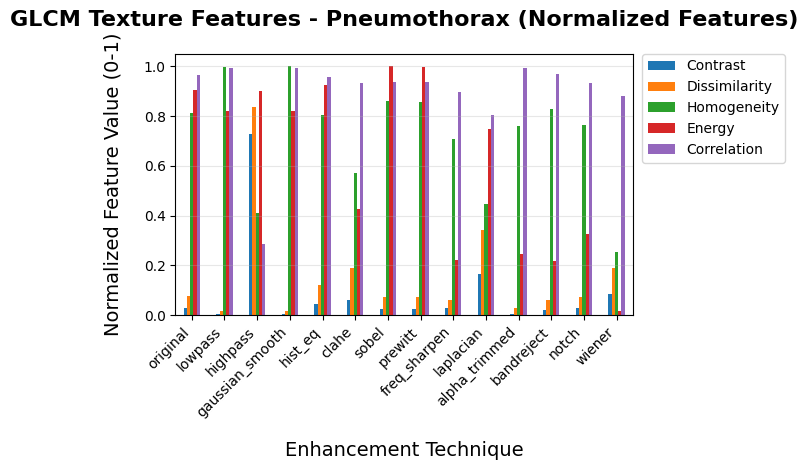

<Figure size 1800x1000 with 0 Axes>

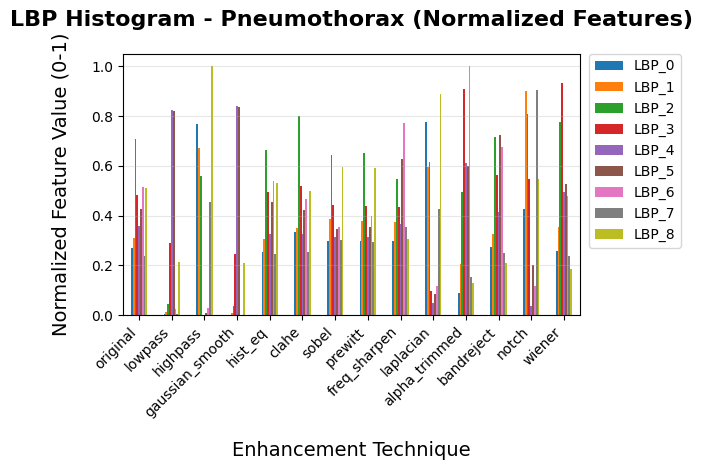

<Figure size 1800x1000 with 0 Axes>

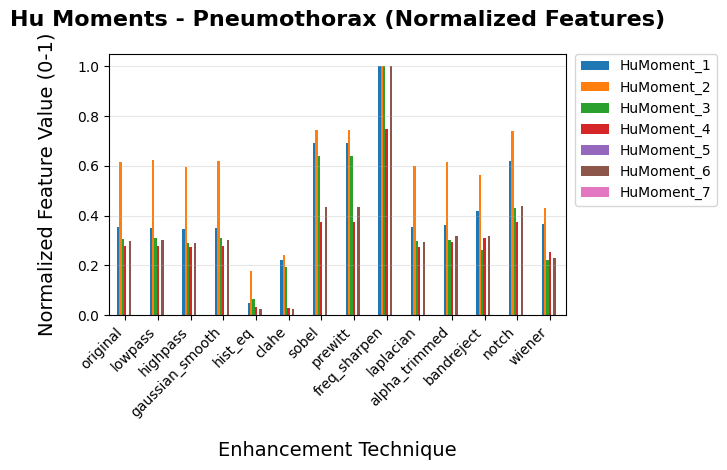

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

# Load handcrafted features
df = pd.read_csv("handcrafted_features_10_images.csv")

# Normalize features (except metadata columns)
scaler = MinMaxScaler()
df_scaled = df.copy()
feature_columns = df.columns[3:]  # Skip Original_Image, Technique, Filename
df_scaled[feature_columns] = scaler.fit_transform(df[feature_columns])

# Define feature groups
basic = ["Mean", "Std", "Variance", "Skewness", "Kurtosis", "Entropy"]
glcm = ["Contrast", "Dissimilarity", "Homogeneity", "Energy", "Correlation"]
lbp = [f"LBP_{i}" for i in range(9)]
hu = [f"HuMoment_{i+1}" for i in range(7)]

feature_groups = {
    "Basic Statistics": basic,
    "GLCM Texture Features": glcm,
    "LBP Histogram": lbp,
    "Hu Moments": hu
}

# Plot each group separately for each original image
for original_image in df['Original_Image'].unique():
    # Filter data for this original image
    image_data = df_scaled[df_scaled['Original_Image'] == original_image]

    for group_name, features in feature_groups.items():
        # Create large individual figure for each plot
        plt.figure(figsize=(18, 10))

        # Plot the data
        image_data.set_index("Technique")[features].plot(kind='bar')

        # Organize titles and labels with proper spacing
        plt.title(f"{group_name} - {original_image} (Normalized Features)",
                 fontsize=16, fontweight='bold', pad=20)
        plt.ylabel("Normalized Feature Value (0-1)", fontsize=14, labelpad=15)
        plt.xlabel("Enhancement Technique", fontsize=14, labelpad=15)

        # Improve legend positioning
        plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left',
                  borderaxespad=0., fontsize=10, frameon=True)

        # Improve x-axis labels
        plt.xticks(rotation=45, ha='right')

        # Add grid for better readability
        plt.grid(axis='y', alpha=0.3)

        # Adjust layout to prevent overlapping
        plt.tight_layout()
        plt.subplots_adjust(right=0.85)  # Make space for legend

        plt.show()


t-SNE Analysis for: Atelectasis


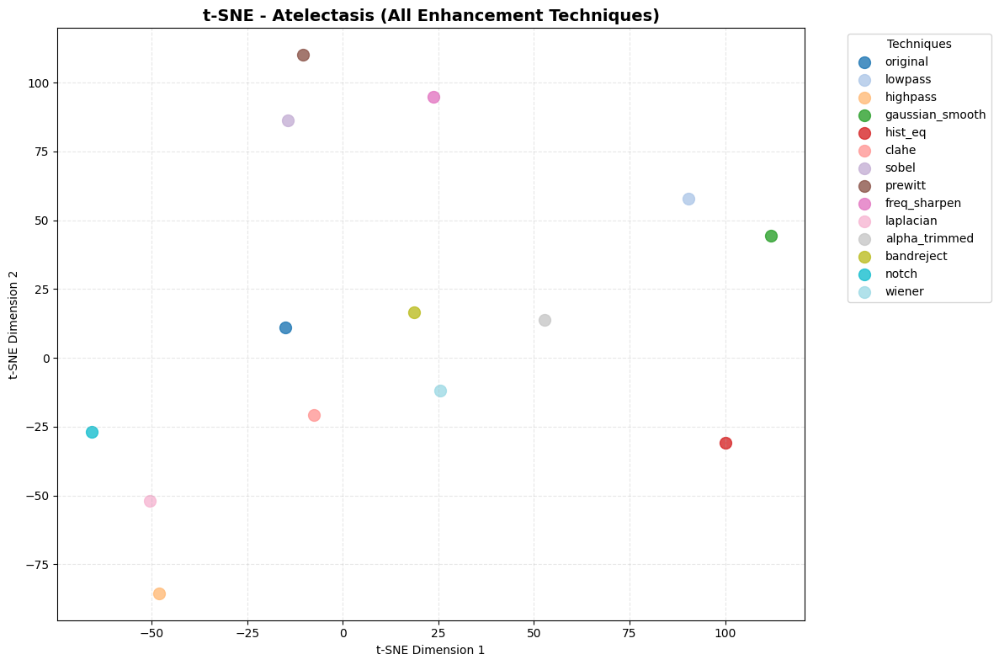


t-SNE Analysis for: Cardiomegaly


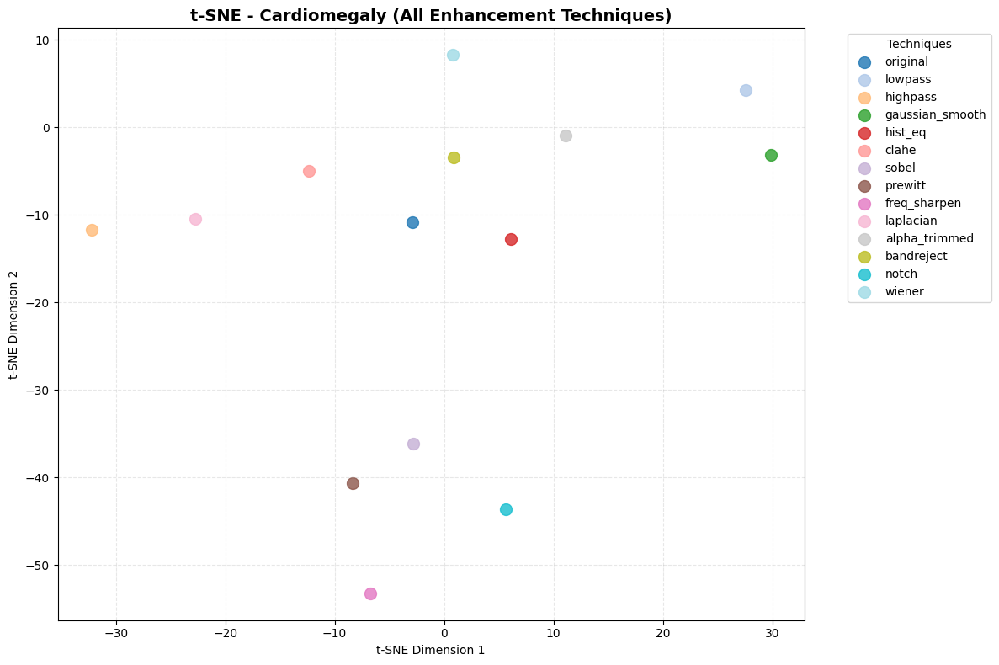


t-SNE Analysis for: Consolidation


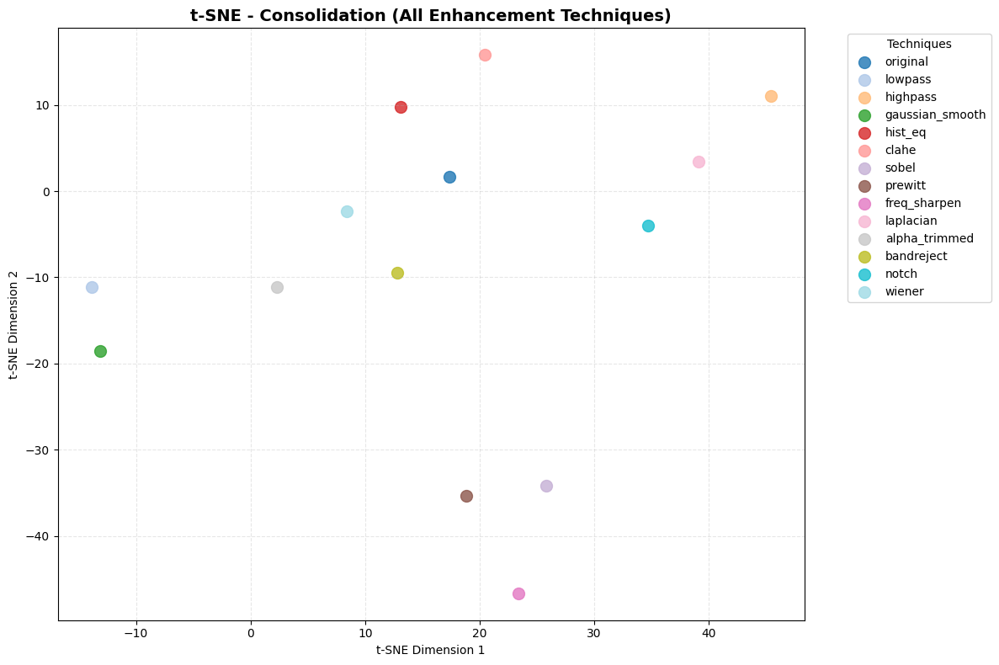


t-SNE Analysis for: Edema


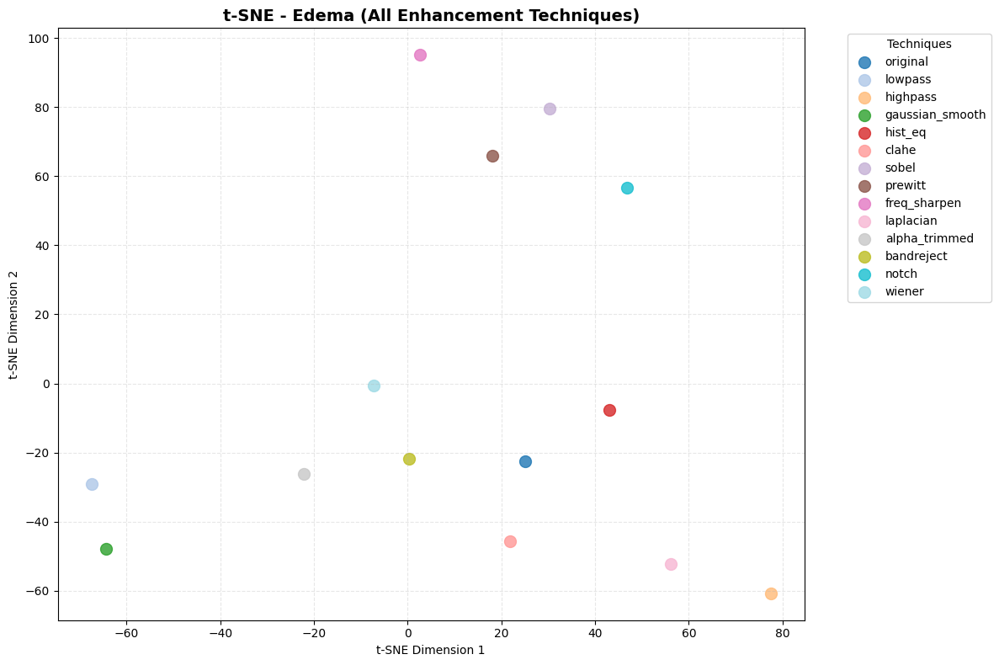


t-SNE Analysis for: Effusion


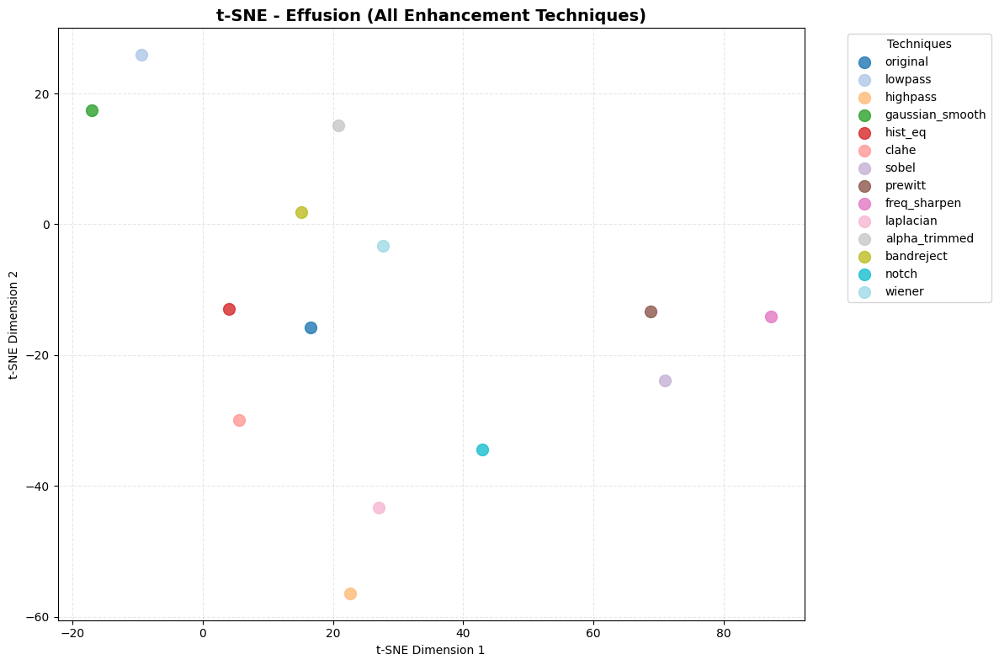


t-SNE Analysis for: Emphysema


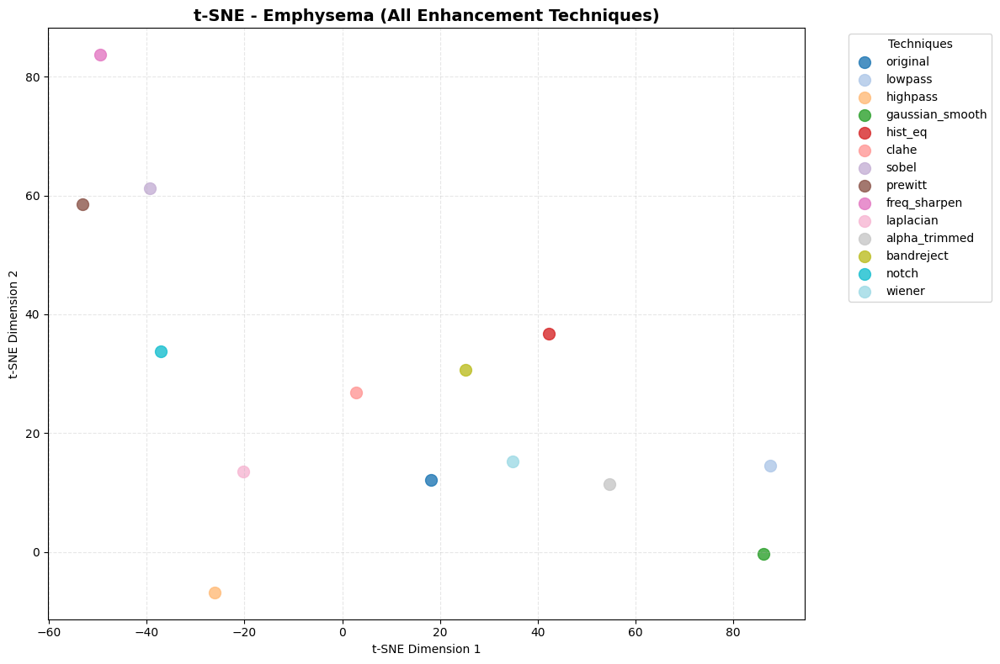


t-SNE Analysis for: Fibrosis


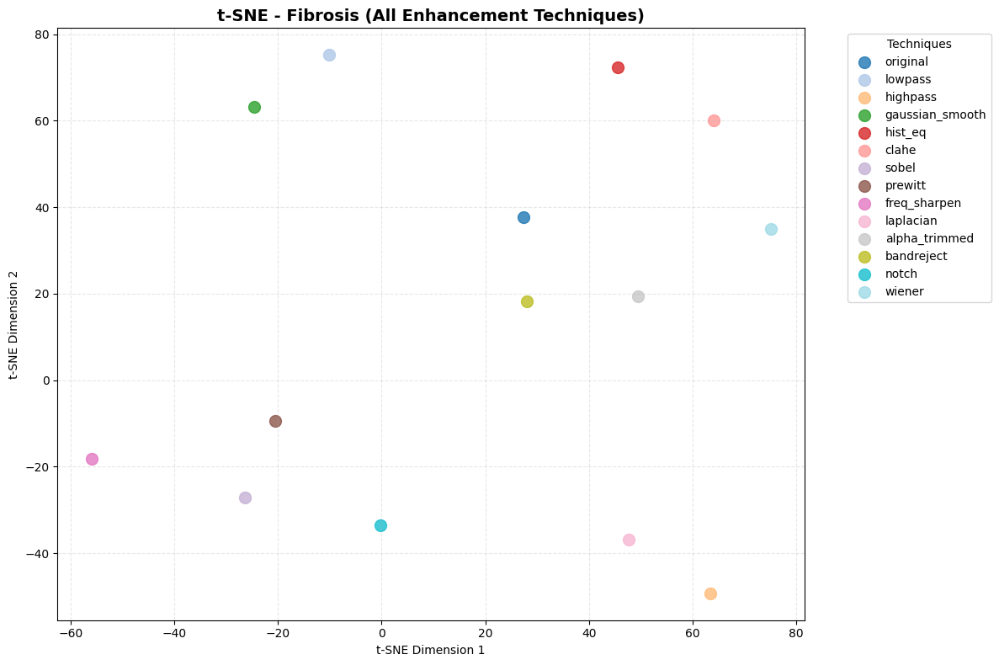


t-SNE Analysis for: No Finding


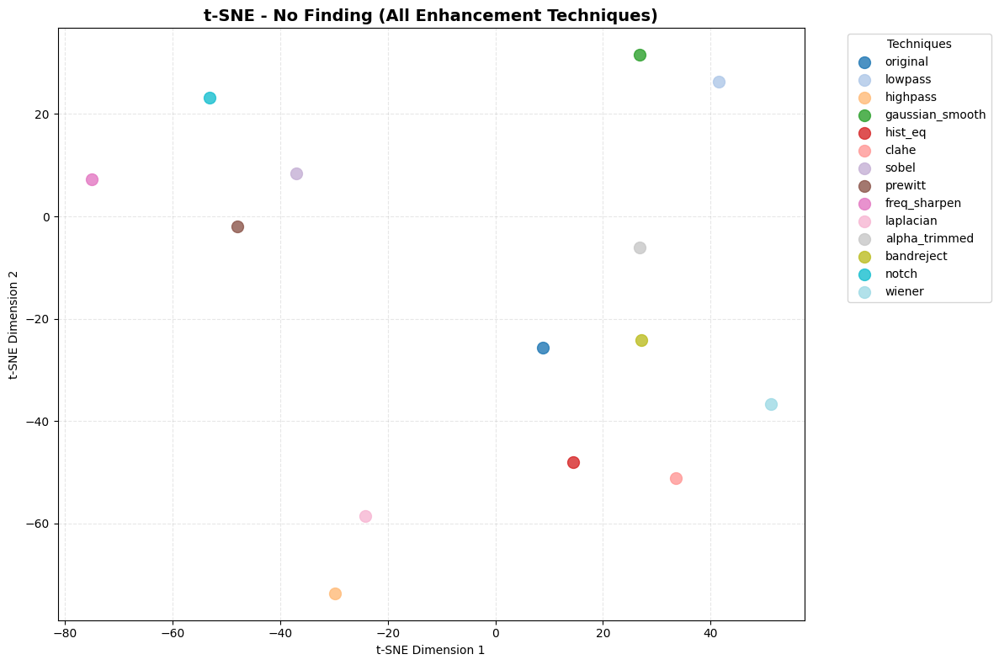


t-SNE Analysis for: Pneumonia


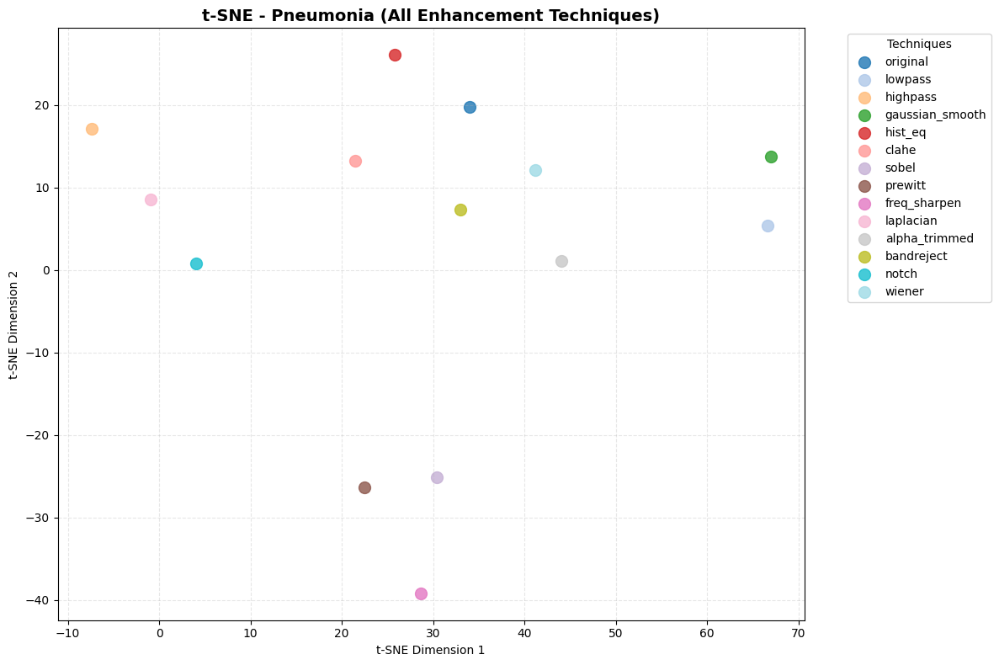


t-SNE Analysis for: Pneumothorax


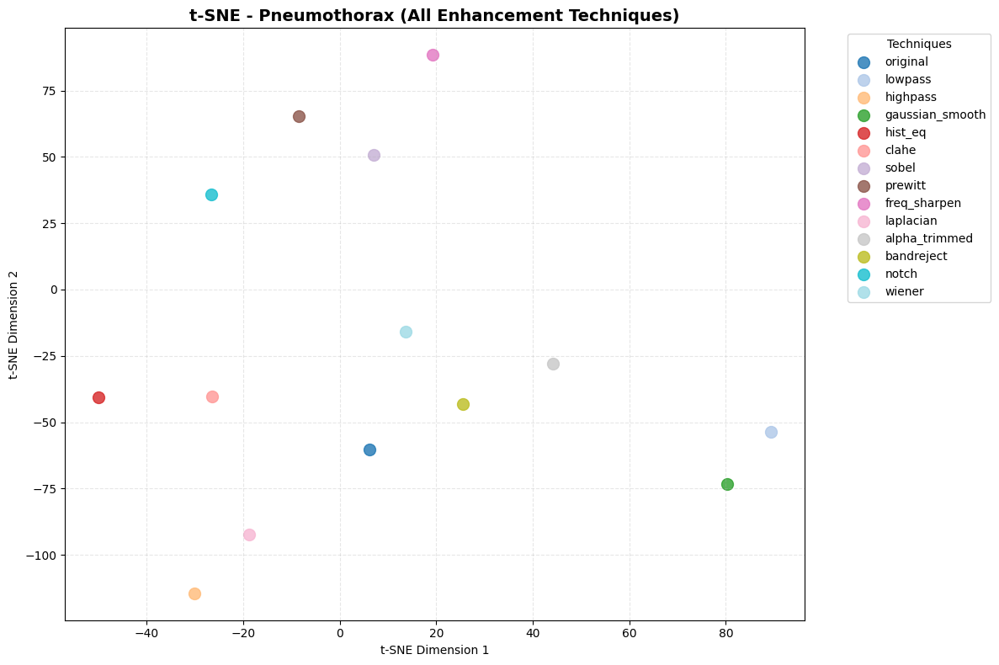


COMBINED t-SNE ANALYSIS - ALL IMAGES


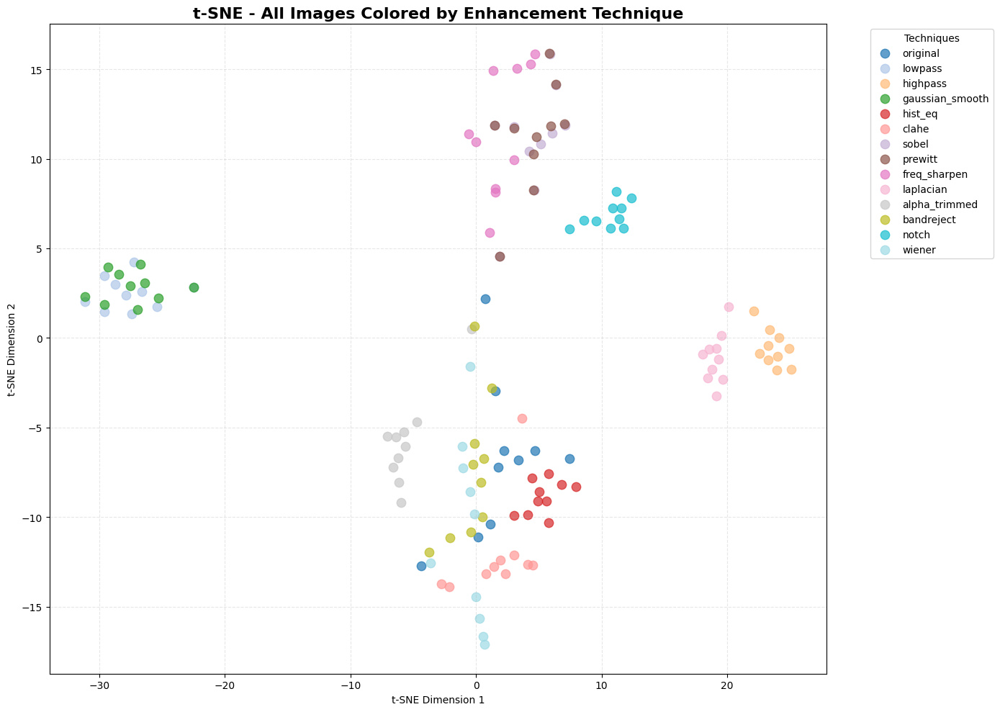

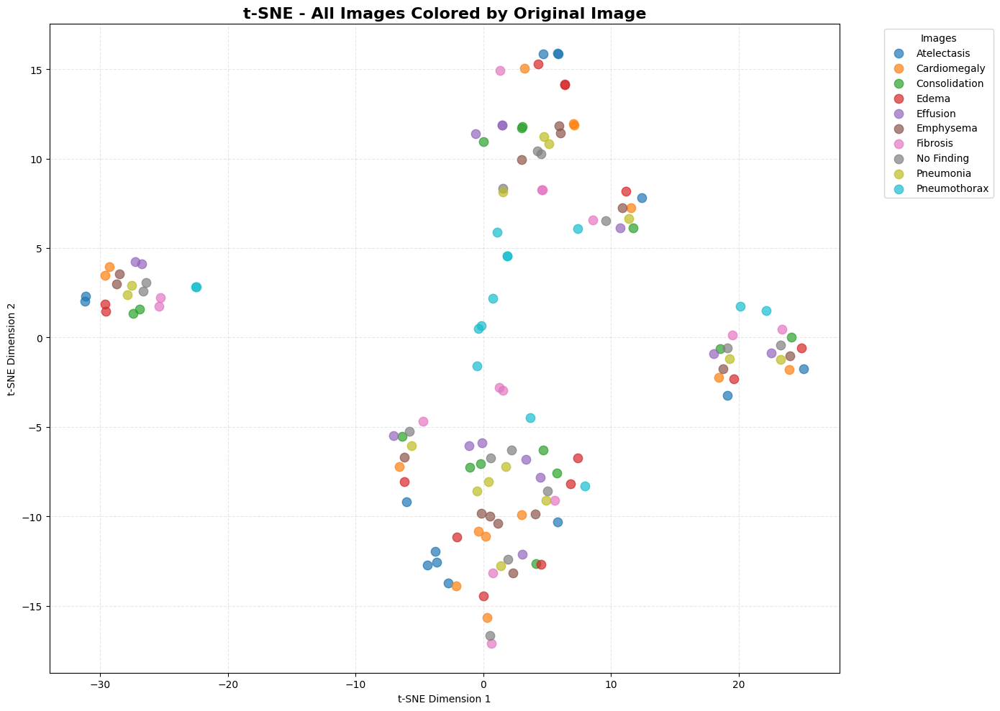

In [12]:
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# Load handcrafted features
df = pd.read_csv("handcrafted_features_10_images.csv")

# Get all unique original images
original_images = df['Original_Image'].unique()

# Create t-SNE analysis for each original image separately
for image_name in original_images:
    print(f"\n{'='*60}")
    print(f"t-SNE Analysis for: {image_name}")
    print(f"{'='*60}")

    # Filter data for this specific image
    image_data = df[df['Original_Image'] == image_name]

    # Separate features and labels
    X = image_data.drop(columns=["Original_Image", "Technique", "Filename"])
    technique_labels = image_data["Technique"]

    # Normalize features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Run t-SNE
    tsne = TSNE(
        n_components=2,
        perplexity=min(5, len(image_data)-1),  # Adjust perplexity for small datasets
        learning_rate='auto',
        init='pca',
        random_state=42
    )
    X_tsne = tsne.fit_transform(X_scaled)

    # Create t-SNE visualization for this image
    plt.figure(figsize=(12, 8))

    # Create scatter plot colored by technique
    unique_techniques = technique_labels.unique()
    colors = plt.cm.tab20(np.linspace(0, 1, len(unique_techniques)))

    for i, technique in enumerate(unique_techniques):
        mask = technique_labels == technique
        plt.scatter(X_tsne[mask, 0], X_tsne[mask, 1],
                   c=[colors[i]], label=technique, s=100, alpha=0.8)

    plt.title(f"t-SNE - {image_name} (All Enhancement Techniques)",
              fontsize=14, fontweight='bold')
    plt.xlabel("t-SNE Dimension 1")
    plt.ylabel("t-SNE Dimension 2")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Techniques")
    plt.grid(True, linestyle="--", alpha=0.3)
    plt.tight_layout()
    plt.show()

# Additional: Combined analysis across all images
print(f"\n{'='*60}")
print("COMBINED t-SNE ANALYSIS - ALL IMAGES")
print(f"{'='*60}")

# Use all data but color by technique
X_all = df.drop(columns=["Original_Image", "Technique", "Filename"])
technique_labels_all = df["Technique"]
image_labels_all = df["Original_Image"]

scaler_all = StandardScaler()
X_scaled_all = scaler_all.fit_transform(X_all)

tsne_all = TSNE(
    n_components=2,
    perplexity=15,
    learning_rate='auto',
    init='pca',
    random_state=42
)
X_tsne_all = tsne_all.fit_transform(X_scaled_all)

# Combined visualization colored by technique
plt.figure(figsize=(14, 10))

unique_techniques_all = technique_labels_all.unique()
colors_all = plt.cm.tab20(np.linspace(0, 1, len(unique_techniques_all)))

for i, technique in enumerate(unique_techniques_all):
    mask = technique_labels_all == technique
    plt.scatter(X_tsne_all[mask, 0], X_tsne_all[mask, 1],
               c=[colors_all[i]], label=technique, s=80, alpha=0.7)

plt.title("t-SNE - All Images Colored by Enhancement Technique",
          fontsize=16, fontweight='bold')
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Techniques")
plt.grid(True, linestyle="--", alpha=0.3)
plt.tight_layout()
plt.show()

# Combined visualization colored by original image
plt.figure(figsize=(14, 10))

unique_images = df['Original_Image'].unique()
colors_images = plt.cm.tab10(np.linspace(0, 1, len(unique_images)))

for i, image in enumerate(unique_images):
    mask = df['Original_Image'] == image
    plt.scatter(X_tsne_all[mask, 0], X_tsne_all[mask, 1],
               c=[colors_images[i]], label=image, s=80, alpha=0.7)

plt.title("t-SNE - All Images Colored by Original Image",
          fontsize=16, fontweight='bold')
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Images")
plt.grid(True, linestyle="--", alpha=0.3)
plt.tight_layout()
plt.show()


PCA Analysis for: Atelectasis
Explained variance by PC1: 33.97%
Explained variance by PC2: 30.24%
Total explained variance: 64.21%


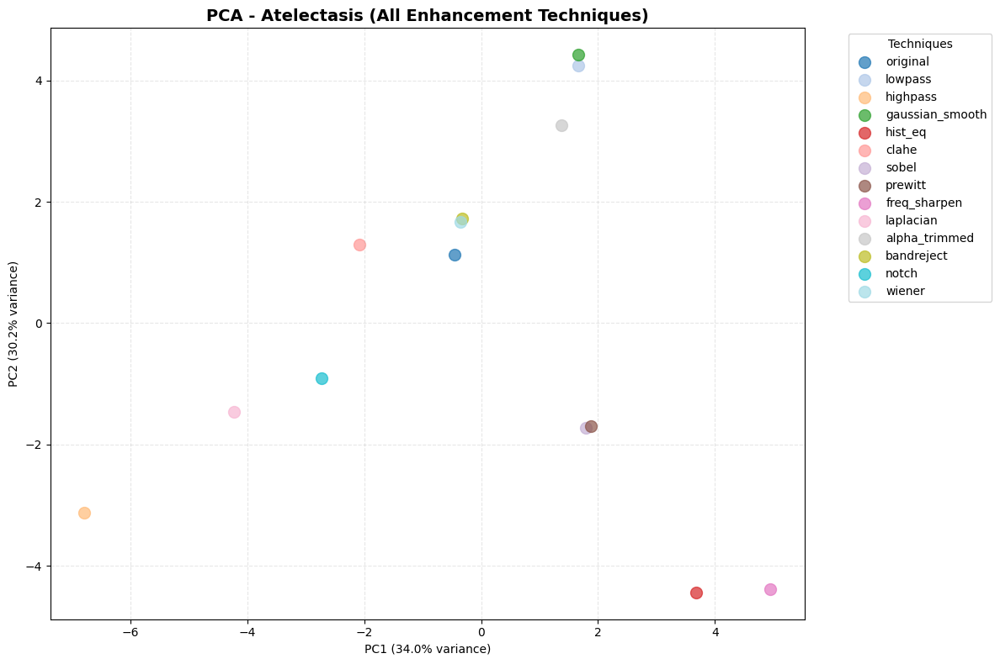


Top features contributing to PC1 for Atelectasis:
                    PC1       PC2
Homogeneity    0.253048  0.167441
Dissimilarity  0.251289  0.149582
LBP_0          0.244279  0.215645
Contrast       0.230904  0.128143
Correlation    0.225695  0.153450

Top features contributing to PC2 for Atelectasis:
                 PC1       PC2
LBP_4       0.188243  0.262500
LBP_8       0.208458  0.255567
LBP_5       0.195273  0.254420
HuMoment_3  0.219508  0.246495
LBP_1       0.184166  0.237682

PCA Analysis for: Cardiomegaly
Explained variance by PC1: 37.79%
Explained variance by PC2: 31.26%
Total explained variance: 69.05%


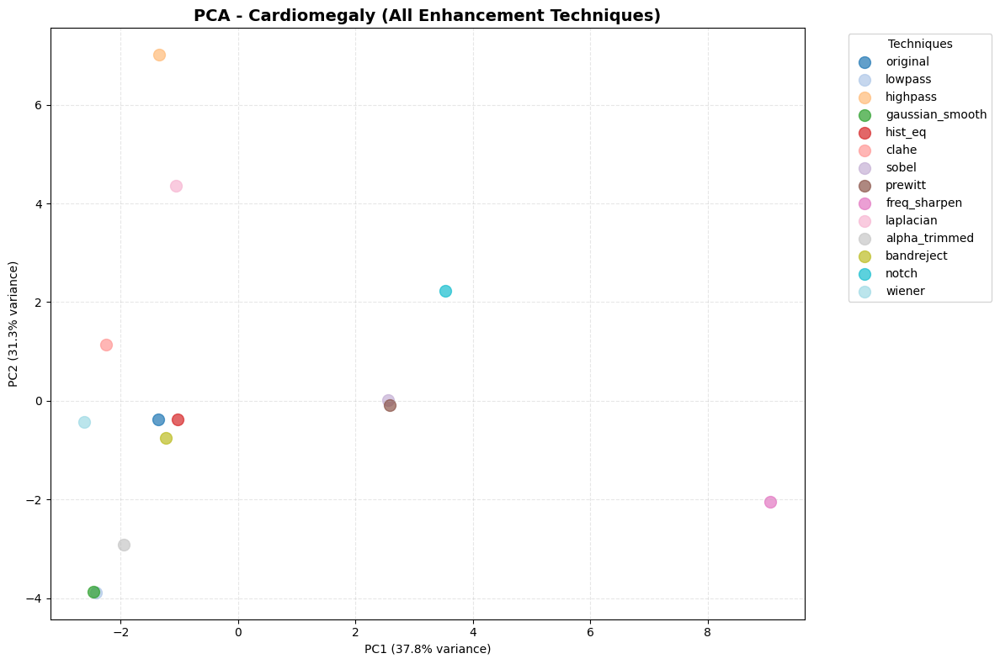


Top features contributing to PC1 for Cardiomegaly:
                 PC1       PC2
HuMoment_1  0.304041  0.039395
HuMoment_3  0.300362  0.046531
Mean        0.297775  0.036251
HuMoment_7  0.287839  0.057938
HuMoment_4  0.284734  0.060400

Top features contributing to PC2 for Cardiomegaly:
                  PC1       PC2
LBP_0        0.050693  0.326652
LBP_8        0.087693  0.321752
LBP_5        0.102722  0.309206
LBP_4        0.116283  0.304102
Homogeneity  0.046489  0.303279

PCA Analysis for: Consolidation
Explained variance by PC1: 43.07%
Explained variance by PC2: 28.97%
Total explained variance: 72.03%


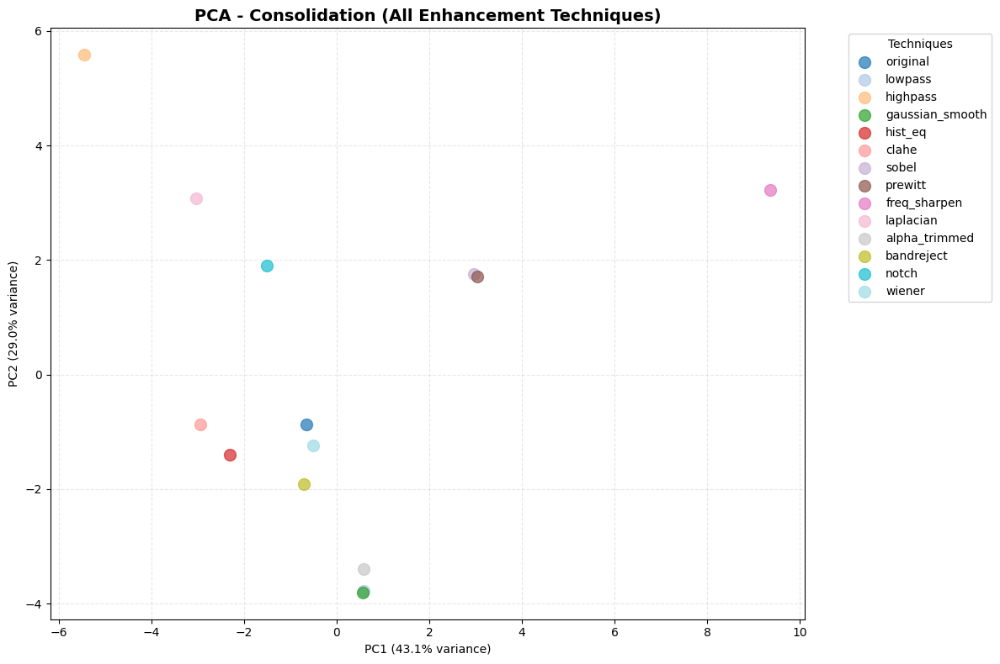


Top features contributing to PC1 for Consolidation:
                 PC1       PC2
Kurtosis    0.271258  0.021043
HuMoment_3  0.263886  0.140733
HuMoment_4  0.262701  0.134420
Std         0.260670  0.107990
HuMoment_1  0.259428  0.158875

Top features contributing to PC2 for Consolidation:
            PC1       PC2
LBP_8  0.130303  0.310496
LBP_0  0.130077  0.305277
LBP_4  0.093314  0.304160
LBP_5  0.143327  0.294143
LBP_1  0.098404  0.284998

PCA Analysis for: Edema
Explained variance by PC1: 40.44%
Explained variance by PC2: 30.06%
Total explained variance: 70.50%


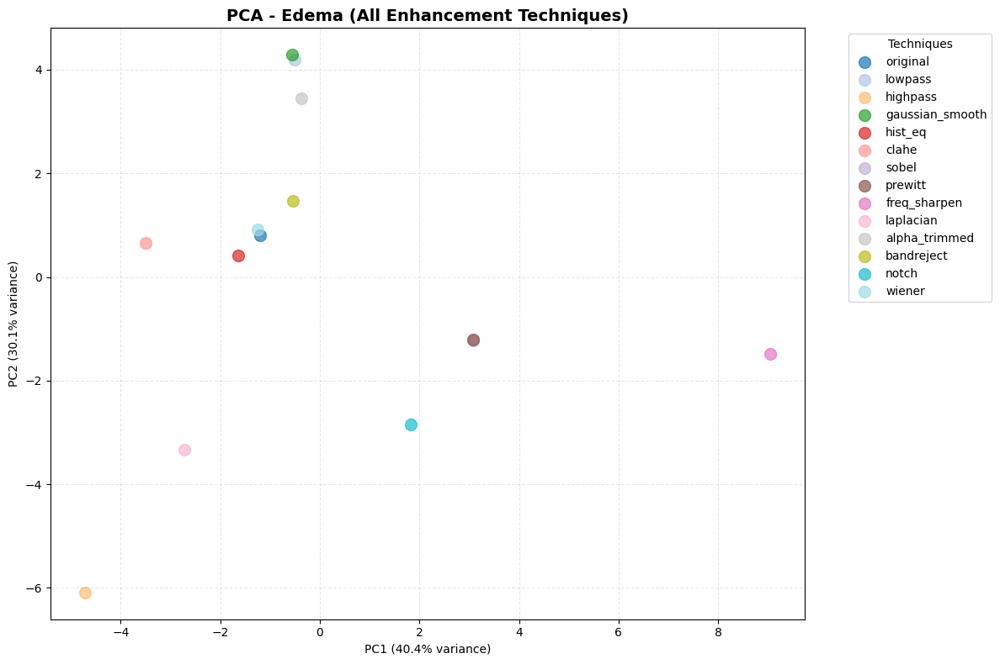


Top features contributing to PC1 for Edema:
                 PC1       PC2
HuMoment_1  0.282538  0.113626
HuMoment_4  0.281940  0.092184
Kurtosis    0.279231  0.007230
HuMoment_2  0.279182  0.075524
Std         0.279075  0.038804

Top features contributing to PC2 for Edema:
            PC1       PC2
LBP_4  0.040732  0.323165
LBP_5  0.062593  0.322706
LBP_0  0.090453  0.319923
LBP_8  0.078599  0.310547
LBP_1  0.009148  0.308994

PCA Analysis for: Effusion
Explained variance by PC1: 42.16%
Explained variance by PC2: 30.92%
Total explained variance: 73.07%


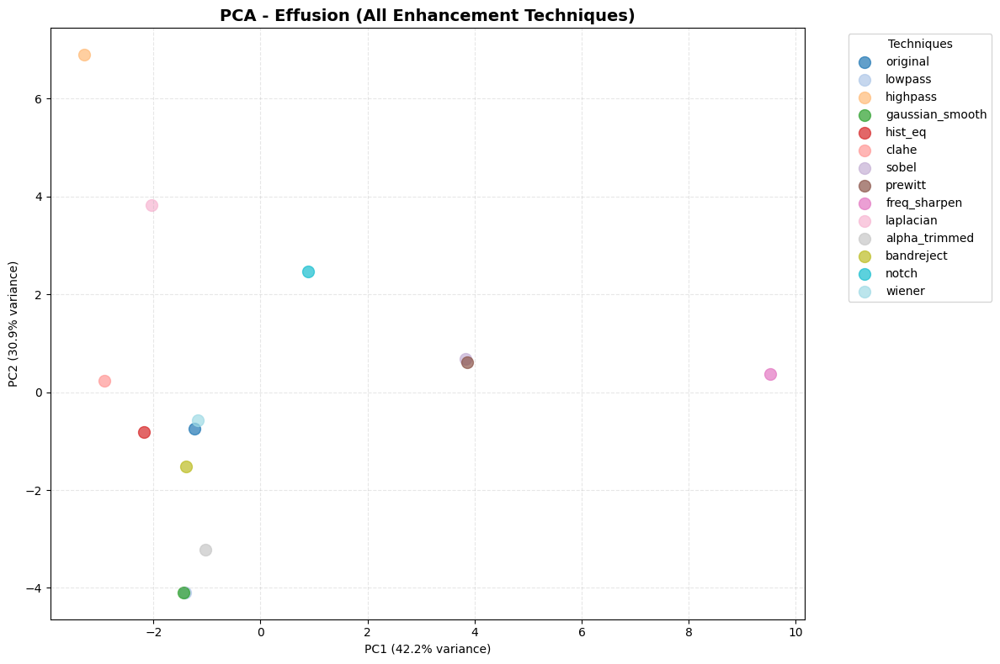


Top features contributing to PC1 for Effusion:
                 PC1       PC2
HuMoment_1  0.291863  0.049170
HuMoment_2  0.287675  0.033661
Kurtosis    0.287214  0.037027
HuMoment_3  0.285614  0.044248
Mean        0.284428  0.048080

Top features contributing to PC2 for Effusion:
            PC1       PC2
LBP_8  0.002385  0.335452
LBP_0  0.030081  0.330861
LBP_5  0.029118  0.326073
LBP_4  0.022377  0.322829
LBP_1  0.030675  0.302161

PCA Analysis for: Emphysema
Explained variance by PC1: 40.56%
Explained variance by PC2: 31.84%
Total explained variance: 72.40%


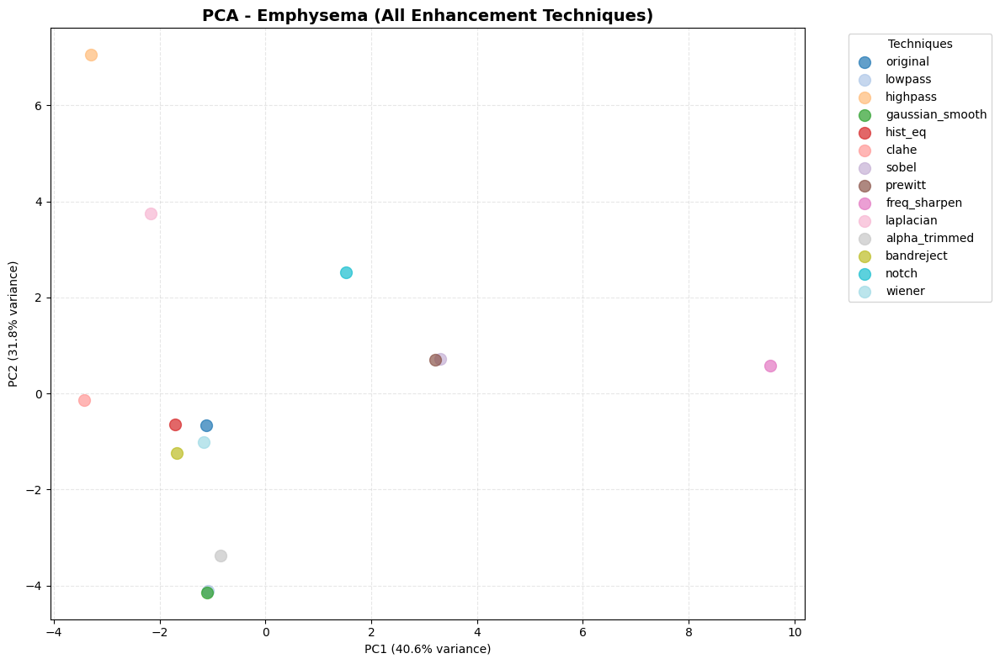


Top features contributing to PC1 for Emphysema:
                 PC1       PC2
HuMoment_1  0.295899  0.057370
Mean        0.291146  0.057626
HuMoment_3  0.290726  0.041770
HuMoment_2  0.285597  0.022444
HuMoment_4  0.282843  0.041117

Top features contributing to PC2 for Emphysema:
            PC1       PC2
LBP_8  0.018191  0.334129
LBP_0  0.039357  0.325269
LBP_5  0.012172  0.322660
LBP_4  0.013872  0.315463
LBP_1  0.017576  0.304080

PCA Analysis for: Fibrosis
Explained variance by PC1: 41.05%
Explained variance by PC2: 30.50%
Total explained variance: 71.56%


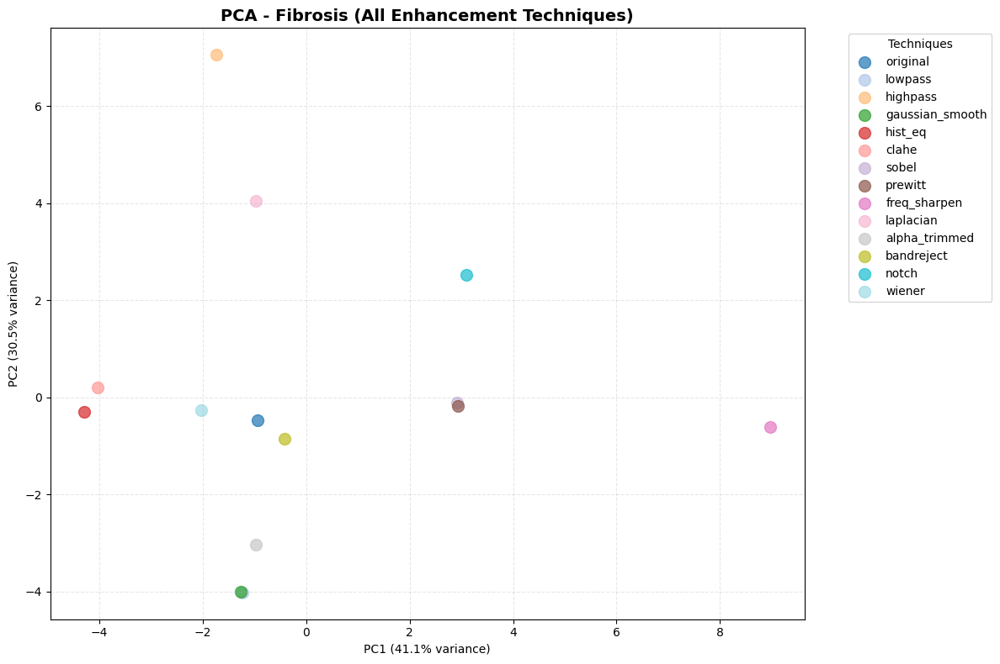


Top features contributing to PC1 for Fibrosis:
                 PC1       PC2
HuMoment_1  0.296243  0.007957
HuMoment_6  0.295017  0.003304
HuMoment_3  0.294728  0.000050
HuMoment_4  0.291316  0.002390
HuMoment_5  0.290135  0.005523

Top features contributing to PC2 for Fibrosis:
            PC1       PC2
LBP_0  0.014805  0.335157
LBP_8  0.022873  0.329345
LBP_5  0.034959  0.329160
LBP_4  0.051070  0.319173
LBP_1  0.070531  0.305248

PCA Analysis for: No Finding
Explained variance by PC1: 40.76%
Explained variance by PC2: 29.77%
Total explained variance: 70.53%


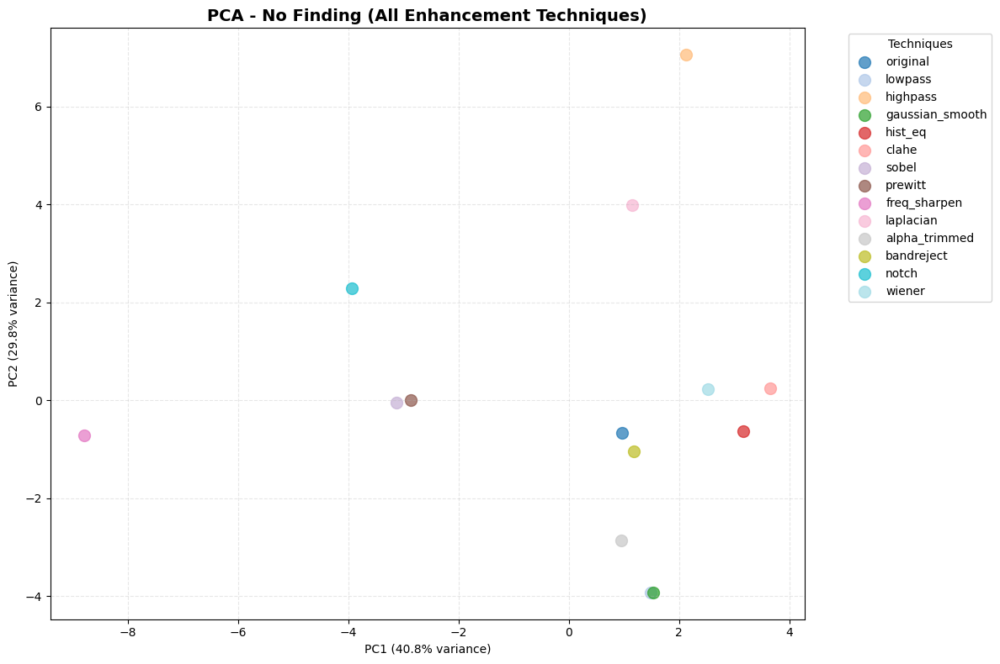


Top features contributing to PC1 for No Finding:
                 PC1       PC2
HuMoment_7  0.298781  0.011466
HuMoment_1  0.296285  0.010478
HuMoment_3  0.293905  0.007032
Mean        0.291005  0.014577
HuMoment_6  0.287253  0.000358

Top features contributing to PC2 for No Finding:
            PC1       PC2
LBP_0  0.013056  0.337417
LBP_5  0.050253  0.333032
LBP_8  0.031446  0.330538
LBP_4  0.072117  0.319612
LBP_1  0.094095  0.303103

PCA Analysis for: Pneumonia
Explained variance by PC1: 41.11%
Explained variance by PC2: 31.03%
Total explained variance: 72.14%


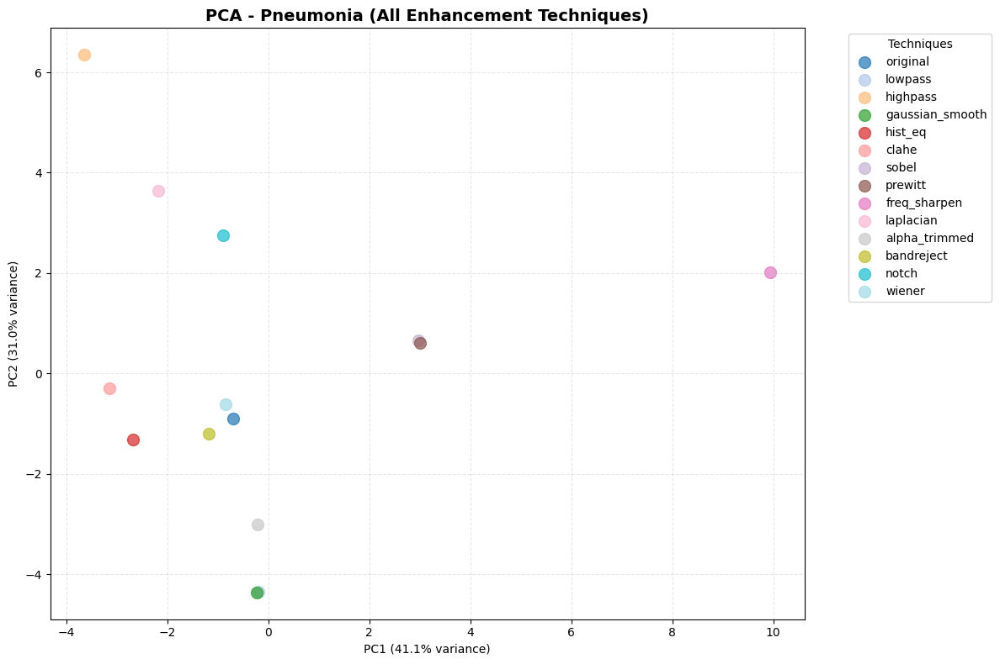


Top features contributing to PC1 for Pneumonia:
                 PC1       PC2
HuMoment_3  0.287976  0.081104
HuMoment_1  0.285602  0.087108
Kurtosis    0.284312  0.039387
HuMoment_4  0.283312  0.072748
HuMoment_2  0.280279  0.076808

Top features contributing to PC2 for Pneumonia:
            PC1       PC2
LBP_8  0.043202  0.327231
LBP_0  0.066628  0.325703
LBP_5  0.043483  0.324400
LBP_4  0.025066  0.322946
LBP_1  0.036218  0.305929

PCA Analysis for: Pneumothorax
Explained variance by PC1: 38.42%
Explained variance by PC2: 28.98%
Total explained variance: 67.39%


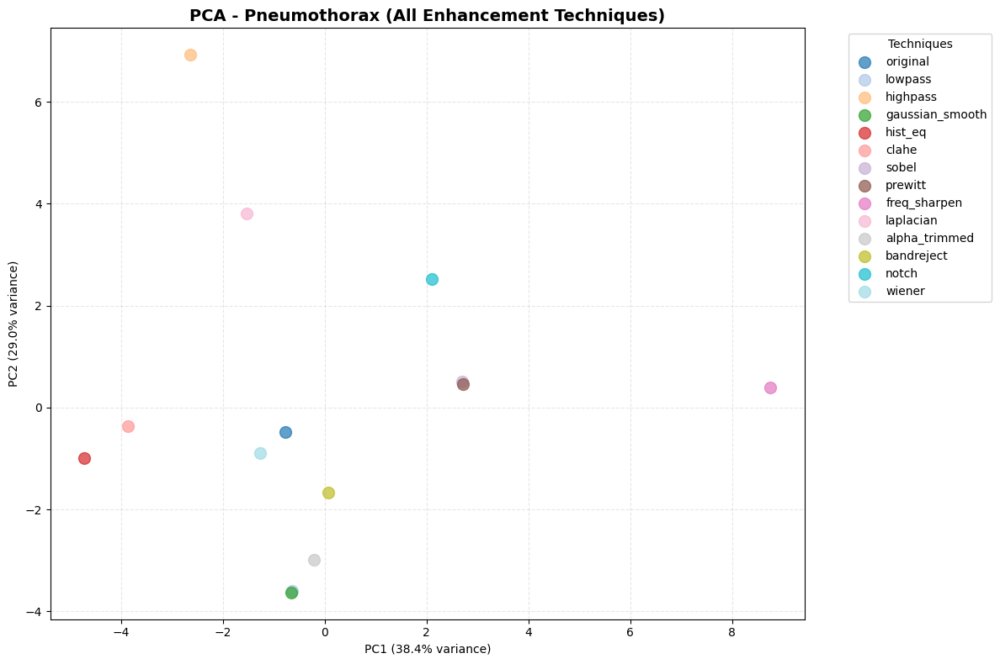


Top features contributing to PC1 for Pneumothorax:
                 PC1       PC2
HuMoment_1  0.302682  0.056977
HuMoment_6  0.299770  0.041947
HuMoment_4  0.297601  0.042730
HuMoment_3  0.297344  0.047069
Std         0.289859  0.011711

Top features contributing to PC2 for Pneumothorax:
            PC1       PC2
LBP_0  0.035404  0.341172
LBP_5  0.048222  0.330012
LBP_4  0.000094  0.325982
LBP_8  0.062306  0.320227
LBP_1  0.030336  0.305193

COMBINED PCA ANALYSIS - ALL IMAGES
Explained variance by PC1: 30.43%
Explained variance by PC2: 25.91%
Total explained variance: 56.34%


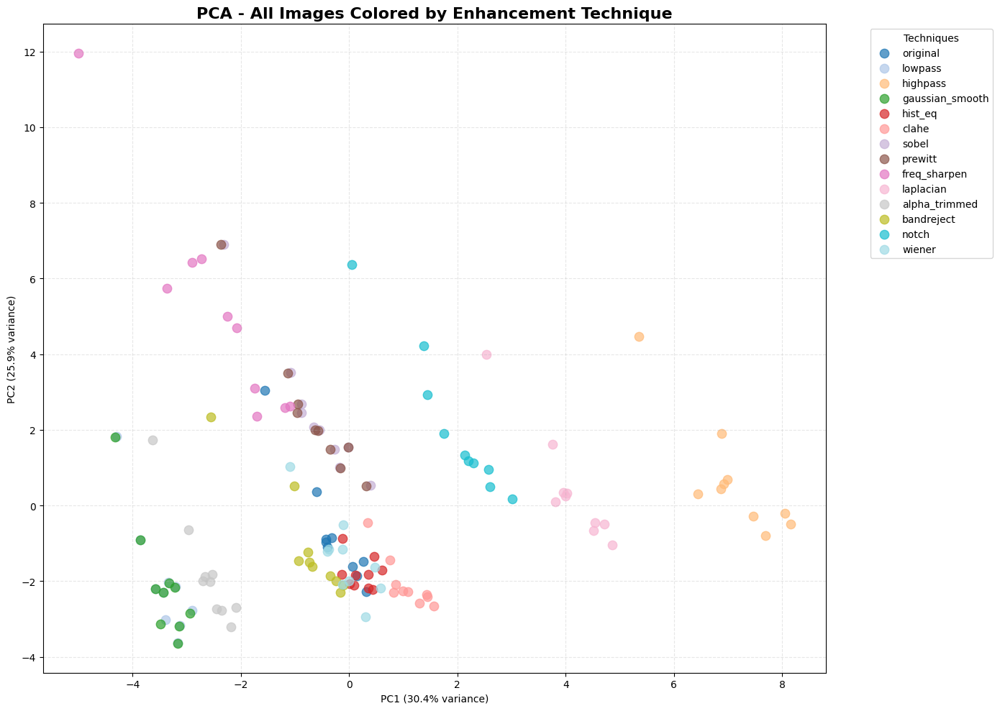

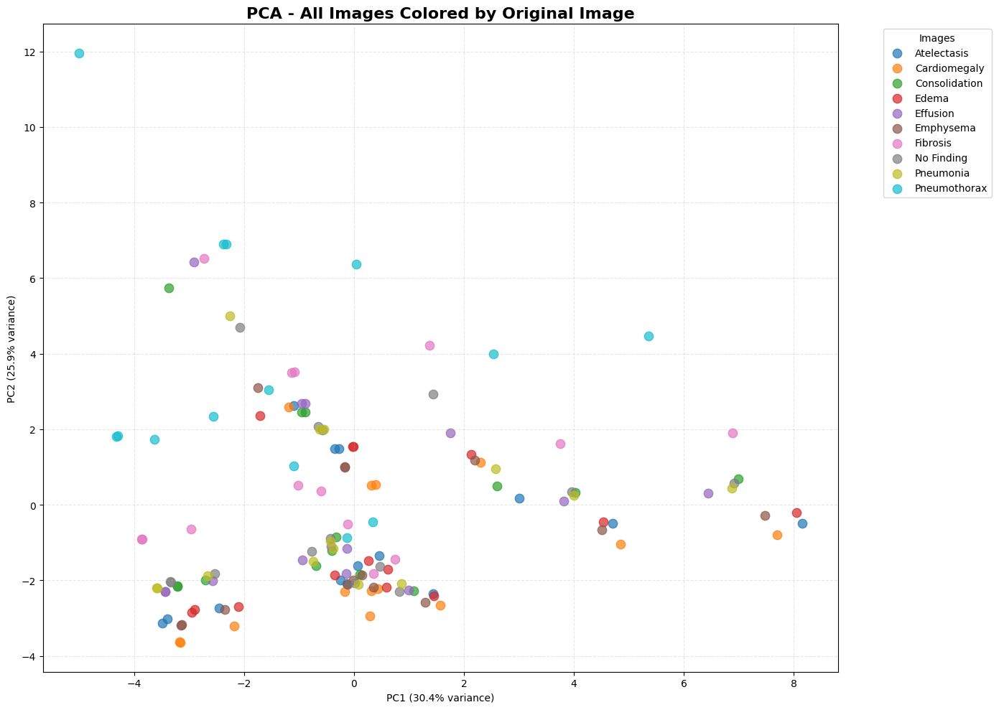


Top features contributing to PC1 (All Images):
                    PC1       PC2
LBP_0          0.321235  0.101810
LBP_5          0.304431  0.134087
Dissimilarity  0.301570  0.019166
LBP_8          0.298799  0.151495
Homogeneity    0.297302  0.022521

Top features contributing to PC2 (All Images):
                 PC1       PC2
HuMoment_1  0.095236  0.337804
Mean        0.094671  0.325970
Entropy     0.074213  0.289868
HuMoment_5  0.099906  0.286362
HuMoment_6  0.097882  0.284756


In [11]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np

# Load handcrafted features
df = pd.read_csv("handcrafted_features_10_images.csv")

# Get all unique original images
original_images = df['Original_Image'].unique()

# Create PCA analysis for each original image separately
for image_name in original_images:
    print(f"\n{'='*60}")
    print(f"PCA Analysis for: {image_name}")
    print(f"{'='*60}")

    # Filter data for this specific image
    image_data = df[df['Original_Image'] == image_name]

    # Separate features and labels
    X = image_data.drop(columns=["Original_Image", "Technique", "Filename"])
    technique_labels = image_data["Technique"]

    # Normalize features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # PCA for dimensionality reduction
    pca = PCA(n_components=2, random_state=42)
    X_pca = pca.fit_transform(X_scaled)

    # Explained variance
    explained_var = pca.explained_variance_ratio_ * 100
    print(f"Explained variance by PC1: {explained_var[0]:.2f}%")
    print(f"Explained variance by PC2: {explained_var[1]:.2f}%")
    print(f"Total explained variance: {explained_var.sum():.2f}%")

    # Create PCA visualization for this image
    plt.figure(figsize=(12, 8))

    # Create scatter plot colored by technique
    unique_techniques = technique_labels.unique()
    colors = plt.cm.tab20(np.linspace(0, 1, len(unique_techniques)))

    for i, technique in enumerate(unique_techniques):
        mask = technique_labels == technique
        plt.scatter(X_pca[mask, 0], X_pca[mask, 1],
                   c=[colors[i]], label=technique, s=100, alpha=0.7)

    plt.title(f"PCA - {image_name} (All Enhancement Techniques)",
              fontsize=14, fontweight='bold')
    plt.xlabel(f"PC1 ({explained_var[0]:.1f}% variance)")
    plt.ylabel(f"PC2 ({explained_var[1]:.1f}% variance)")
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Techniques")
    plt.grid(True, linestyle="--", alpha=0.3)
    plt.tight_layout()
    plt.show()

    # Feature importance (PCA loadings) for this image
    loadings = pd.DataFrame(pca.components_.T,
                            columns=["PC1", "PC2"],
                            index=X.columns)

    print(f"\nTop features contributing to PC1 for {image_name}:")
    print(loadings.abs().sort_values(by="PC1", ascending=False).head(5))

    print(f"\nTop features contributing to PC2 for {image_name}:")
    print(loadings.abs().sort_values(by="PC2", ascending=False).head(5))

# Additional: Combined analysis across all images
print(f"\n{'='*60}")
print("COMBINED PCA ANALYSIS - ALL IMAGES")
print(f"{'='*60}")

# Use all data but color by technique
X_all = df.drop(columns=["Original_Image", "Technique", "Filename"])
technique_labels_all = df["Technique"]

scaler_all = StandardScaler()
X_scaled_all = scaler_all.fit_transform(X_all)

pca_all = PCA(n_components=2, random_state=42)
X_pca_all = pca_all.fit_transform(X_scaled_all)

explained_var_all = pca_all.explained_variance_ratio_ * 100
print(f"Explained variance by PC1: {explained_var_all[0]:.2f}%")
print(f"Explained variance by PC2: {explained_var_all[1]:.2f}%")
print(f"Total explained variance: {explained_var_all.sum():.2f}%")

# Combined visualization colored by technique
plt.figure(figsize=(14, 10))

unique_techniques_all = technique_labels_all.unique()
colors_all = plt.cm.tab20(np.linspace(0, 1, len(unique_techniques_all)))

for i, technique in enumerate(unique_techniques_all):
    mask = technique_labels_all == technique
    plt.scatter(X_pca_all[mask, 0], X_pca_all[mask, 1],
               c=[colors_all[i]], label=technique, s=80, alpha=0.7)

plt.title("PCA - All Images Colored by Enhancement Technique",
          fontsize=16, fontweight='bold')
plt.xlabel(f"PC1 ({explained_var_all[0]:.1f}% variance)")
plt.ylabel(f"PC2 ({explained_var_all[1]:.1f}% variance)")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Techniques")
plt.grid(True, linestyle="--", alpha=0.3)
plt.tight_layout()
plt.show()

# Combined visualization colored by original image
plt.figure(figsize=(14, 10))

unique_images = df['Original_Image'].unique()
colors_images = plt.cm.tab10(np.linspace(0, 1, len(unique_images)))

for i, image in enumerate(unique_images):
    mask = df['Original_Image'] == image
    plt.scatter(X_pca_all[mask, 0], X_pca_all[mask, 1],
               c=[colors_images[i]], label=image, s=80, alpha=0.7)

plt.title("PCA - All Images Colored by Original Image",
          fontsize=16, fontweight='bold')
plt.xlabel(f"PC1 ({explained_var_all[0]:.1f}% variance)")
plt.ylabel(f"PC2 ({explained_var_all[1]:.1f}% variance)")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title="Images")
plt.grid(True, linestyle="--", alpha=0.3)
plt.tight_layout()
plt.show()

# Feature importance for combined analysis
loadings_all = pd.DataFrame(pca_all.components_.T,
                           columns=["PC1", "PC2"],
                           index=X_all.columns)

print(f"\nTop features contributing to PC1 (All Images):")
print(loadings_all.abs().sort_values(by="PC1", ascending=False).head(5))

print(f"\nTop features contributing to PC2 (All Images):")
print(loadings_all.abs().sort_values(by="PC2", ascending=False).head(5))


Atelectasis - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
         wiener             0.000000
gaussian_smooth             0.075401
        lowpass             0.081598
  alpha_trimmed             0.089324
     bandreject             0.102287
      laplacian             0.130861
          clahe             0.311839
          notch             0.342593
        prewitt             0.586266
          sobel             0.586292
   freq_sharpen             0.721087
       highpass             0.936709
        hist_eq             1.000000


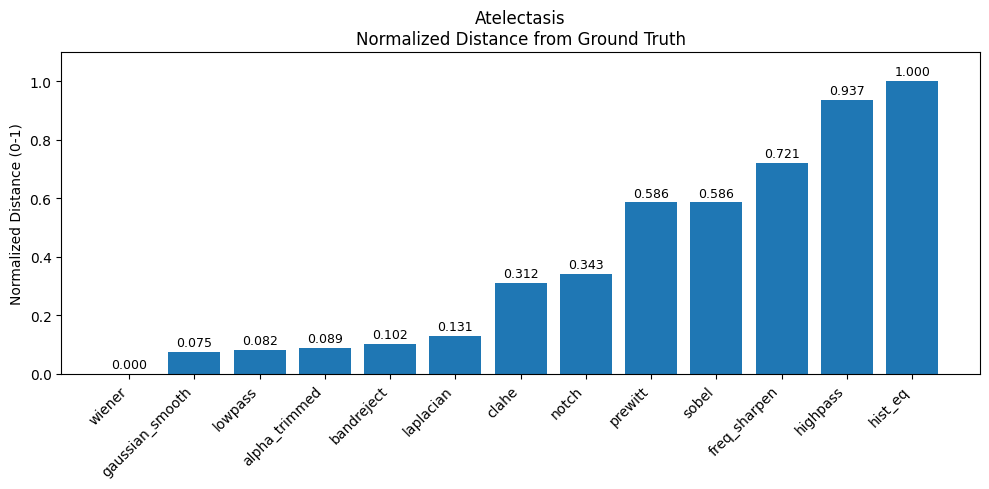


Cardiomegaly - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
gaussian_smooth             0.000000
        lowpass             0.002178
  alpha_trimmed             0.010502
          clahe             0.033745
     bandreject             0.083882
      laplacian             0.105436
         wiener             0.122770
        hist_eq             0.334607
          notch             0.696699
       highpass             0.757177
          sobel             0.830604
        prewitt             0.830726
   freq_sharpen             1.000000


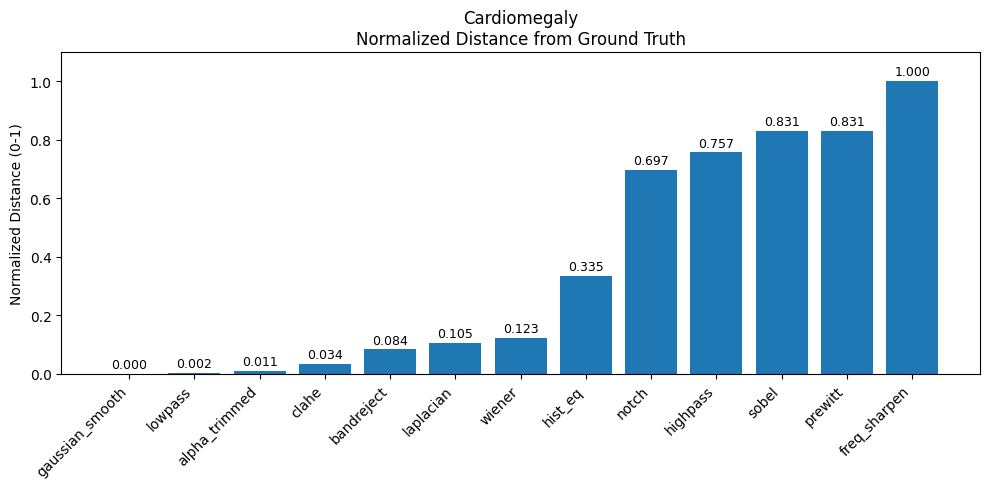


Consolidation - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
gaussian_smooth             0.000000
        lowpass             0.001625
         wiener             0.010592
  alpha_trimmed             0.029409
     bandreject             0.038718
          clahe             0.051797
      laplacian             0.099248
          notch             0.292729
        hist_eq             0.325642
       highpass             0.721514
          sobel             0.783358
        prewitt             0.784030
   freq_sharpen             1.000000


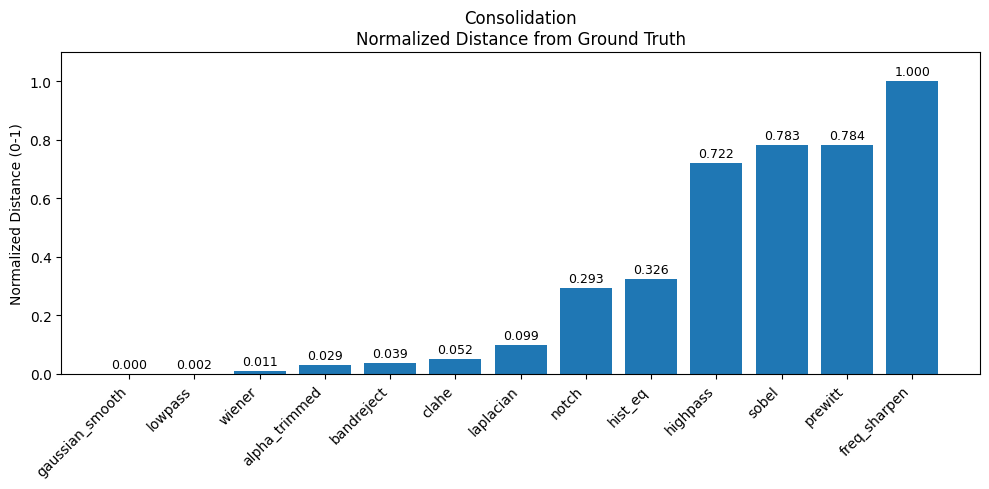


Edema - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
gaussian_smooth             0.000000
        lowpass             0.002215
         wiener             0.021056
  alpha_trimmed             0.021412
      laplacian             0.066760
          clahe             0.139984
     bandreject             0.175979
        hist_eq             0.398198
        prewitt             0.718790
          sobel             0.719212
          notch             0.737597
       highpass             0.996311
   freq_sharpen             1.000000


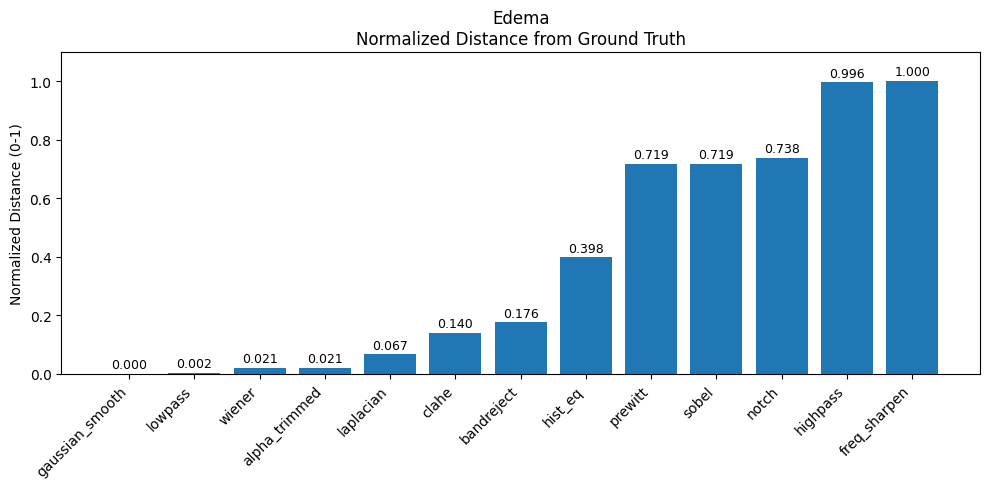


Effusion - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
          clahe             0.000000
         wiener             0.004167
gaussian_smooth             0.019937
        lowpass             0.022229
  alpha_trimmed             0.035426
      laplacian             0.088957
        hist_eq             0.094029
     bandreject             0.106359
       highpass             0.576020
          notch             0.616985
        prewitt             0.777583
          sobel             0.777617
   freq_sharpen             1.000000


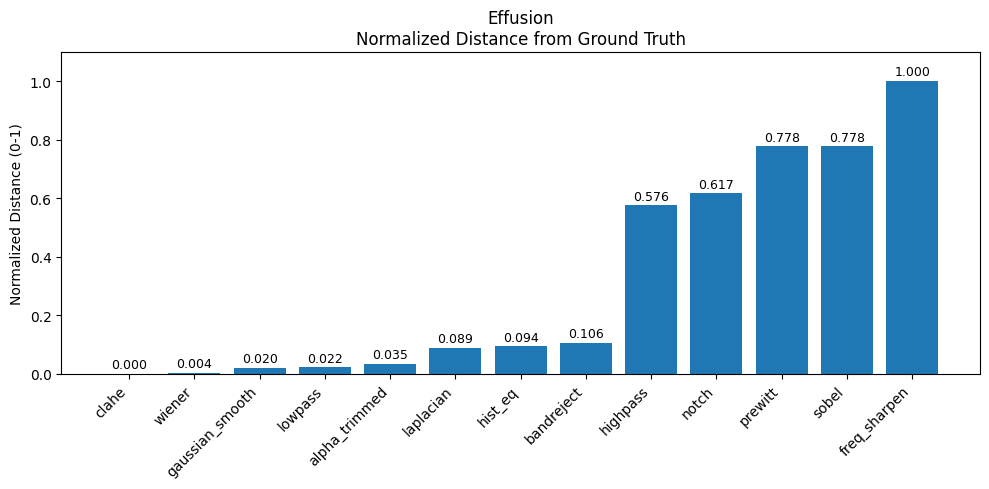


Emphysema - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
         wiener             0.000000
gaussian_smooth             0.017539
        lowpass             0.020117
  alpha_trimmed             0.032457
     bandreject             0.035578
          clahe             0.057232
      laplacian             0.121451
        hist_eq             0.302696
          notch             0.638532
       highpass             0.769718
        prewitt             0.770095
          sobel             0.774943
   freq_sharpen             1.000000


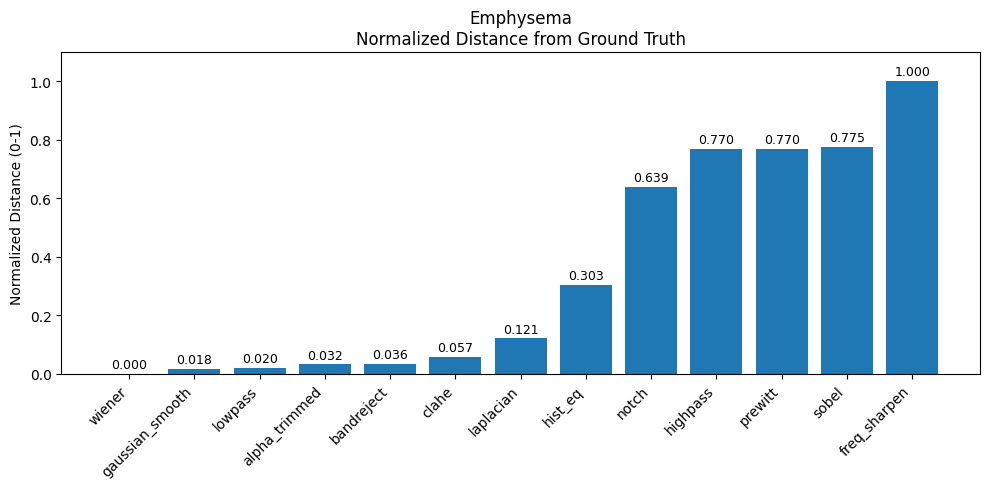


Fibrosis - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
gaussian_smooth             0.000000
        lowpass             0.003875
  alpha_trimmed             0.010399
          clahe             0.098322
      laplacian             0.133038
     bandreject             0.157395
         wiener             0.200569
          notch             0.694369
        hist_eq             0.694682
          sobel             0.704870
        prewitt             0.705578
   freq_sharpen             0.945334
       highpass             1.000000


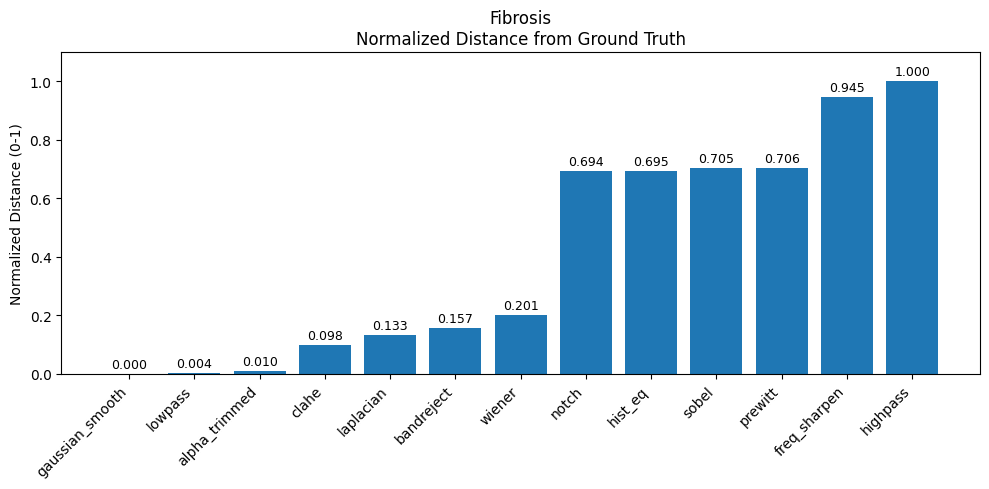


No Finding - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
gaussian_smooth             0.000000
          clahe             0.001866
        lowpass             0.002843
  alpha_trimmed             0.008987
     bandreject             0.043081
      laplacian             0.093052
        hist_eq             0.142551
         wiener             0.233713
       highpass             0.705068
          notch             0.711726
        prewitt             0.749926
          sobel             0.756345
   freq_sharpen             1.000000


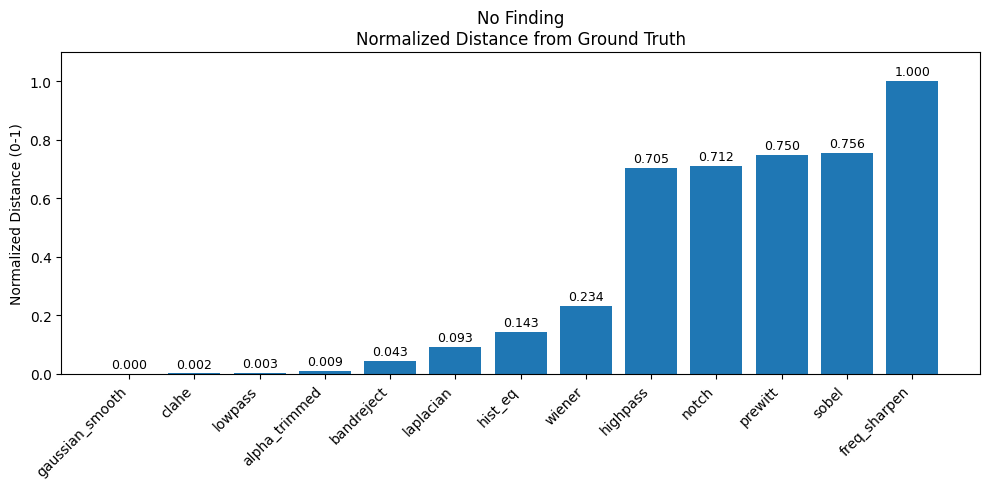


Pneumonia - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
gaussian_smooth             0.000000
         wiener             0.000497
        lowpass             0.001575
     bandreject             0.010794
  alpha_trimmed             0.012185
          clahe             0.038973
      laplacian             0.104628
          notch             0.391911
        hist_eq             0.451453
       highpass             0.744944
          sobel             0.787970
        prewitt             0.789338
   freq_sharpen             1.000000


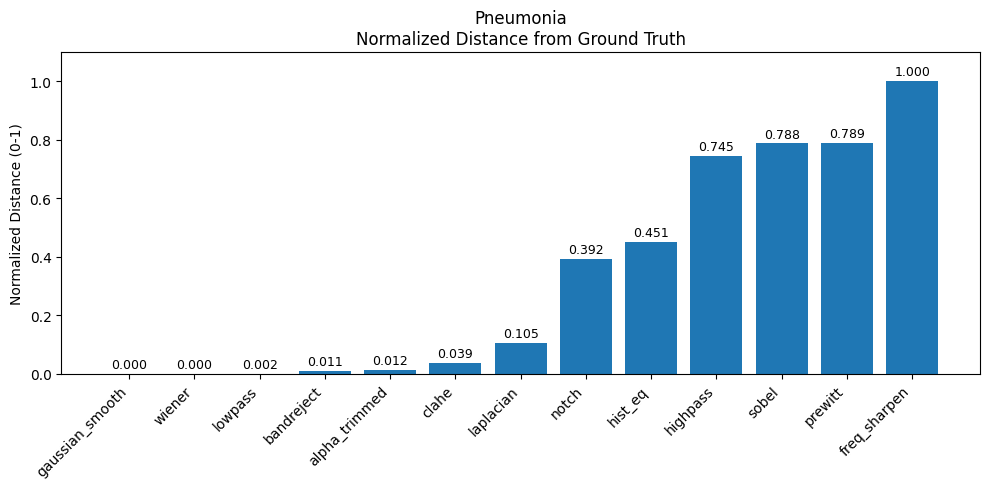


Pneumothorax - Normalized Distance Analysis
--------------------------------------------------
      Technique  Normalized_Distance
gaussian_smooth             0.000000
        lowpass             0.003176
  alpha_trimmed             0.040777
      laplacian             0.117602
         wiener             0.155872
          clahe             0.170513
     bandreject             0.288650
        hist_eq             0.438354
          notch             0.712072
          sobel             0.741885
        prewitt             0.742079
       highpass             0.823415
   freq_sharpen             1.000000


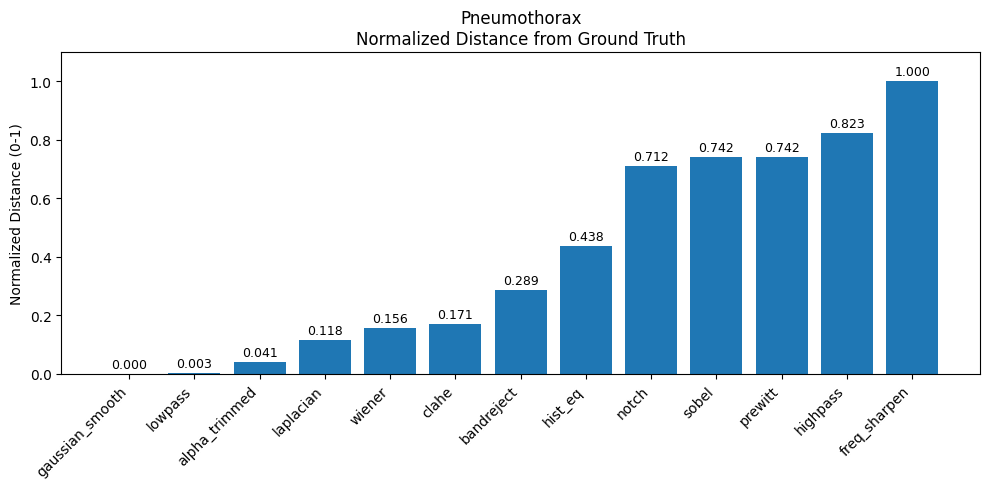


COMBINED ANALYSIS
Average Normalized Distance by Technique:
      Technique  Average_Normalized_Distance
gaussian_smooth                     0.011288
        lowpass                     0.014143
  alpha_trimmed                     0.029088
         wiener                     0.074924
          clahe                     0.090427
     bandreject                     0.104272
      laplacian                     0.106103
        hist_eq                     0.418221
          notch                     0.583521
        prewitt                     0.745441
          sobel                     0.746310
       highpass                     0.803088
   freq_sharpen                     0.966642


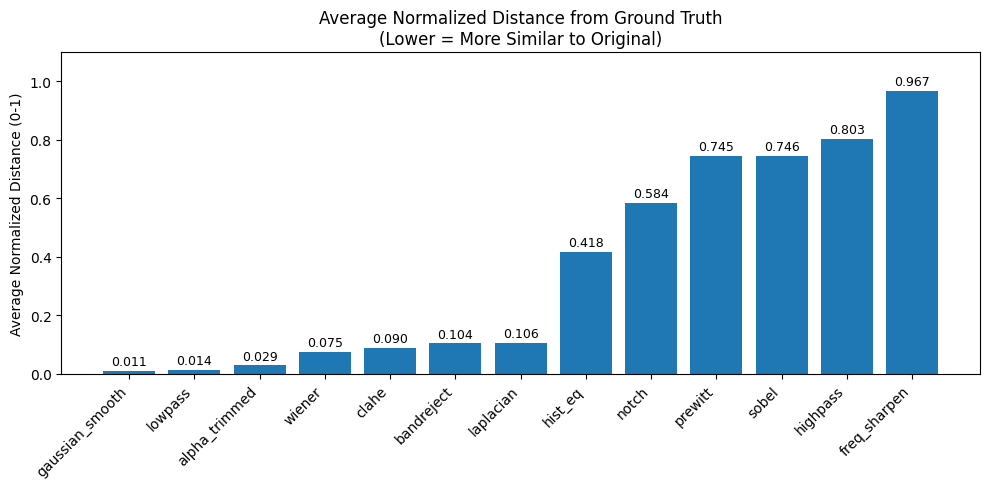


TECHNIQUE RANKINGS:
 1. gaussian_smooth      - 0.011
 2. lowpass              - 0.014
 3. alpha_trimmed        - 0.029
 4. wiener               - 0.075
 5. clahe                - 0.090
 6. bandreject           - 0.104
 7. laplacian            - 0.106
 8. hist_eq              - 0.418
 9. notch                - 0.584
10. prewitt              - 0.745
11. sobel                - 0.746
12. highpass             - 0.803
13. freq_sharpen         - 0.967


In [16]:
from scipy.spatial.distance import euclidean
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Load handcrafted features
df = pd.read_csv("handcrafted_features_10_images.csv")

# Compute normalized Euclidean distances for each original image separately
for image_name in df['Original_Image'].unique():
    print(f"\n{image_name} - Normalized Distance Analysis")
    print("-" * 50)

    # Filter data for this specific image
    image_data = df[df['Original_Image'] == image_name]

    # Get ground truth (original version of THIS specific medical image)
    gt_row = image_data[image_data["Technique"] == "original"]
    if len(gt_row) == 0:
        continue

    gt = gt_row.iloc[0, 3:]  # exclude metadata columns

    comparisons = []

    # Compare all enhanced versions to the original (ground truth)
    enhanced_versions = image_data[image_data["Technique"] != "original"]

    for _, row in enhanced_versions.iterrows():
        dist = euclidean(gt, row[3:])
        comparisons.append((row["Technique"], dist))

    if not comparisons:
        continue

    compare_df = pd.DataFrame(comparisons, columns=["Technique", "Feature_Distance"])

    # Normalize distances to 0-1 range
    min_dist = compare_df["Feature_Distance"].min()
    max_dist = compare_df["Feature_Distance"].max()

    if max_dist > min_dist:
        compare_df["Normalized_Distance"] = (compare_df["Feature_Distance"] - min_dist) / (max_dist - min_dist)
    else:
        compare_df["Normalized_Distance"] = 0

    compare_df = compare_df.sort_values("Normalized_Distance")

    print(compare_df[["Technique", "Normalized_Distance"]].to_string(index=False))

    # Create bar plot with normalized distances only
    plt.figure(figsize=(10, 5))
    bars = plt.bar(compare_df["Technique"], compare_df["Normalized_Distance"])

    # Add value labels on bars
    for bar, norm_dist in zip(bars, compare_df["Normalized_Distance"]):
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width()/2., height + 0.01,
                f'{norm_dist:.3f}', ha='center', va='bottom', fontsize=9)

    plt.xticks(rotation=45, ha='right')
    plt.title(f"{image_name}\nNormalized Distance from Ground Truth")
    plt.ylabel("Normalized Distance (0-1)")
    plt.ylim(0, 1.1)
    plt.tight_layout()
    plt.show()

# Combined analysis
print(f"\nCOMBINED ANALYSIS")
print("=" * 50)

technique_normalized_distances = {}

for technique in df['Technique'].unique():
    if technique == "original":
        continue

    normalized_distances = []

    for image_name in df['Original_Image'].unique():
        image_data = df[df['Original_Image'] == image_name]

        gt_row = image_data[image_data["Technique"] == "original"]
        if len(gt_row) == 0:
            continue

        gt = gt_row.iloc[0, 3:]

        enhanced = image_data[image_data["Technique"] == technique]
        if len(enhanced) > 0:
            actual_dist = euclidean(gt, enhanced.iloc[0, 3:])

            enhanced_versions = image_data[image_data["Technique"] != "original"]
            all_dists = []
            for _, row in enhanced_versions.iterrows():
                all_dists.append(euclidean(gt, row[3:]))

            if all_dists:
                min_d = min(all_dists)
                max_d = max(all_dists)
                if max_d > min_d:
                    norm_dist = (actual_dist - min_d) / (max_d - min_d)
                else:
                    norm_dist = 0
                normalized_distances.append(norm_dist)

    if normalized_distances:
        technique_normalized_distances[technique] = sum(normalized_distances) / len(normalized_distances)

# Create combined comparison DataFrame
combined_compare = pd.DataFrame([
    (tech, technique_normalized_distances[tech])
    for tech in technique_normalized_distances.keys()
], columns=["Technique", "Average_Normalized_Distance"])

combined_compare = combined_compare.sort_values("Average_Normalized_Distance")

print("Average Normalized Distance by Technique:")
print(combined_compare.to_string(index=False))

# Plot combined results
plt.figure(figsize=(10, 5))
bars = plt.bar(combined_compare["Technique"], combined_compare["Average_Normalized_Distance"])

# Add value labels on bars
for bar, norm_val in zip(bars, combined_compare["Average_Normalized_Distance"]):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height + 0.01,
             f'{norm_val:.3f}', ha='center', va='bottom', fontsize=9)

plt.xticks(rotation=45, ha='right')
plt.title("Average Normalized Distance from Ground Truth\n(Lower = More Similar to Original)")
plt.ylabel("Average Normalized Distance (0-1)")
plt.ylim(0, 1.1)
plt.tight_layout()
plt.show()

print(f"\nTECHNIQUE RANKINGS:")
for i, (_, row) in enumerate(combined_compare.iterrows(), 1):
    print(f"{i:2d}. {row['Technique']:20s} - {row['Average_Normalized_Distance']:.3f}")